<a href="https://colab.research.google.com/github/Dawoon-Jeong0523/Economic-Complexity/blob/main/World_Bank_Project_Updated.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# this piece of code loads the necessary libraries
import numpy as np
import pandas as pd
import matplotlib.pylab as plt

In [ ]:
output_path = "./output"  # Replace with your desired directory

# Functions

In [ ]:
# the evaluation can be performed defining a routine, that in Python can be easily done as follows:
def rca(matrix):
    # global share
    world = np.sum(matrix,0)/np.sum(matrix)
    return np.array([(row/sum(row))/world for row in matrix])

In [ ]:
# the routine computes and returns ECI and PCI
def Method_of_Reflections(Mcp, maximal_iterations=10):

    # the matrices used to project on the country and product spaces separately
    ubiquity = np.sum(Mcp, axis = 0)
    diversification = np.sum(Mcp, axis = 1)

    # initial condition (here I consider the normalized degrees of each node)
    kc = diversification / diversification.sum()
    kp = ubiquity / ubiquity.sum()

    # the transpose
    Mpc = np.transpose(Mcp)

    # loop
    kc_old = kc
    kp_old = kp
    for iteration in range(maximal_iterations):

        kc = Mcp.dot(kp_old)/diversification
        kp = Mpc.dot(kc_old)/ubiquity

        kc_old = kc
        kp_old = kp

    return kc/kc.mean(), kp/kp.mean()


In [ ]:
def ECI_PCI_Method_of_Reflections(Mcp, maximal_iterations=10):
    kc, kp = Method_of_Reflections(Mcp,maximal_iterations)

    eci_score = (kc - kc.mean())/kc.std()
    pci_score = (kp - kp.mean())/kp.std()

    return eci_score, pci_score

In [ ]:
# this routine computes the eigenvalue ECI and PCI
def ECI_PCI_eigenvalue(Mcp):

    # the matrices used to project on the country and product spaces separately
    vec = np.sum(Mcp,1).astype(float)
    np.divide(np.ones_like(vec), vec, out=vec, where=vec != 0)
    Pcp = np.transpose(np.transpose(Mcp)*vec)

    vec = np.sum(Mcp,0).astype(float)
    np.divide(np.ones_like(vec), vec, out=vec, where=vec != 0)
    Ppc = np.transpose(Mcp*vec)

    # the projections
    Mcc = np.matmul(Pcp,Ppc)
    Mpp = np.matmul(Ppc,Pcp)

    # eci eigenvector
    eigvalues, eigvectors = np.linalg.eig(Mcc)
    eci = np.real(eigvectors[:, eigvalues.argsort()[-2]])

    # the score of the eigenvector
    eci = (eci - eci.mean())/eci.std()

    if np.corrcoef(eci,np.sum(Mcp,1))[0,1] < 0:
        eci *= -1

    eigvalues, eigvectors = np.linalg.eig(Mpp)
    pci = np.real(eigvectors[:, eigvalues.argsort()[-2]])

    # the score of the eigenvector
    pci = (pci - pci.mean())/pci.std()


    if np.corrcoef(pci,np.sum(Mcp,0))[0,1] > 0:
        pci *= -1

    return eci, pci

In [ ]:
# the iterative FC routine returning fitness and complexity
def fitness_complexity_algorithm(Mcp, maximal_iterations = 100):

    # initial condition (here I consider the degrees of each node)
    fitness = np.array(np.sum(Mcp, axis = 1)/np.sum(Mcp))

    #complexity = np.nan_to_num(1./np.array(np.sum(Mcp, axis = 0)))
    complexity = np.array(np.sum(Mcp, axis = 0)).astype(np.float64)
    one_fit = np.ones_like(fitness)
    one_com = np.ones_like(complexity)
    np.divide(one_com, complexity, out=complexity, where=complexity != 0)

    complexity /= complexity.sum()
    Mpc = np.transpose(Mcp)
    inverse_fitness = np.zeros_like(fitness)

    # loop over the iterations
    for iteration in range(maximal_iterations):

        # compute the inverse fitness
        np.divide(one_fit, fitness, out=inverse_fitness, where=fitness != 0)

        # update the fitness
        fitness = Mcp.dot(complexity)
        fitness /= fitness.sum()

        # update the complexity
        complexity = Mpc.dot(inverse_fitness)
        np.divide(one_com, complexity, out=complexity, where=complexity != 0)
        complexity /= complexity.sum()

    return fitness/fitness.mean(),complexity/complexity.mean()

In [ ]:
# routine generating a new matrix ordered (this can be done in simpler ways)
def matrix_ordering(matrix, order_row, order_columns):
    # create a new matrix
    ordered_matrix = np.zeros(np.shape(matrix))

    # the loops can be slow in pythons. References to the appropriate python libraries are usually faster
    for c in range(len(order_row)):
        for p in range(len(order_columns)):
            ordered_matrix[c,p] = matrix[order_row[c],order_columns[p]]

    return ordered_matrix


# Export

In [ ]:
data_dir = r'F:\Dawoon Jeong\Data\EFC data'

In [ ]:
GDP_pc = pd.read_csv(data_dir+r'/economic/gdp_pc_wb.csv', index_col=0, skiprows=1, names=range(1990,2022))

In [ ]:
GDP_pc.head()

,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,...,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
ABW,24007.495708,25097.272110,25692.238460,26743.722804,28027.515635,27868.543075,27358.542121,28413.144006,28121.315580,27646.195646,...,26337.585059,27821.791600,27624.377300,28421.386493,28852.237067,30270.941601,31705.279053,31762.734026,25823.634824,30271.833475
ALB,1606.296047,1163.491294,1086.438487,1197.580594,1305.000719,1488.020491,1633.551572,1464.297579,1603.647230,1821.872654,...,3736.339101,3780.698202,3855.759734,3952.802538,4090.371657,4249.803734,4431.539181,4543.386520,4410.455165,4830.596317
AND,30577.938661,30301.509675,29595.904727,28363.226388,28144.262713,28051.278707,28797.738923,31149.232044,31895.854213,32966.106028,...,39174.741830,37597.556134,38402.496869,38885.376014,39886.481804,39321.458270,39319.936414,39413.634473,34394.277553,36839.876219
ARE,64592.609100,61637.316420,60452.800511,58267.661004,59458.044476,60698.961987,60755.242517,61581.204832,58060.786846,56342.792955,...,36567.622291,38034.968397,39242.275310,41525.138903,43457.513480,43419.563741,43644.147044,43785.417269,41276.055510,42535.966045
ARG,8144.494294,8762.661384,9327.859451,9957.256522,10397.379287,9969.331576,10388.538710,11097.382063,11391.945158,10880.206207,...,13895.633707,14071.508683,13567.948416,13789.060425,13360.211835,13595.037355,13105.397163,12716.224204,11341.268366,12402.490791


In [ ]:
export = {}
start_year = 1976
end_year = 2020
for year in range(start_year, end_year+1):
    export[year] = pd.read_csv('F:/Dawoon Jeong/Data/UNComtrade/mat/sitc/{}-mat.csv'.format(year), index_col=0)

In [ ]:
export[start_year].shape

(249, 782)

In [ ]:
rca = {}
for year in range(start_year, end_year+1):
    mat = export[year].copy()
    rcamat = ((mat/mat.sum(0)).transpose()/mat.sum(1)*mat.sum().sum()).transpose().fillna(0)
    rca[year] = rcamat

In [ ]:
binary_rca = {}
for year in range(start_year, end_year+1):
    mat = export[year].copy()
    rcamat = ((mat/mat.sum(0)).transpose()/mat.sum(1)*mat.sum().sum()).transpose().fillna(0)
    binary_rca[year] = (rcamat>=1).astype(int)

In [ ]:
# create empty variables storing the diversification and the ubiquity, using the pandas DataFrames
diversification_product = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rca[start_year].index)
ubiquity_product = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rca[start_year].columns)

# loop over the years
for year in range(start_year, end_year+1):
    mat = binary_rca[year]
    diversification_product[year] = pd.Series(mat.sum(1), index=mat.index)
    ubiquity_product[year] = pd.Series(mat.sum(0), index=mat.columns)


In [ ]:
# loop over the time series
fitness_product = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rca[start_year].index)
complexity_product = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rca[start_year].columns)

for year in range(start_year, end_year+1):
    mat = binary_rca[year].copy()

    fit, com = fitness_complexity_algorithm(mat.to_numpy(), maximal_iterations = 200)

    fitness_product[year] = pd.Series(fit, index=mat.index)
    complexity_product[year] = pd.Series(com, index=mat.columns)


In [ ]:
from tqdm import tqdm

# loop over the time series
eci_product = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rca[start_year].index)
pci = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rca[start_year].columns)

for year in tqdm(range(start_year, end_year+1)):
    mat = binary_rca[year].copy()
    eci_score, pci_score = ECI_PCI_eigenvalue(mat.to_numpy())
    #eci_score, pci_score = ECI_PCI_Method_of_Reflections(mat.to_numpy(), maximal_iterations=20)
    eci_product[year] = pd.Series(eci_score, index=mat.index)
    pci[year] = pd.Series(pci_score, index=mat.columns)

100%|██████████| 45/45 [00:24<00:00,  1.85it/s]


In [ ]:
len(binary_rca[1976].loc['KOR'][binary_rca[1976].loc['KOR']==1].index)

165

In [ ]:
pci

,1976,1977,1978,1979,1980,1981,1982,1983,1984,1985,...,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020
0011,-0.953215,-1.227578,-1.012238,-1.223980,-1.254443,-0.842603,-0.884834,-0.906148,-0.655873,-0.650771,...,-0.767943,-0.840413,-0.747664,-0.844295,-0.792194,-0.815525,-0.686613,-0.324203,-0.419566,-0.514824
0012,-1.053241,-1.294622,-1.339158,-1.423325,-1.306018,-1.234088,-1.456772,-1.390645,-1.442452,-1.189854,...,-1.473752,-1.766783,-1.629328,-1.690339,-1.796019,-1.617638,-1.612985,-1.402513,-1.372108,-1.200346
0013,0.210365,0.467767,0.222631,0.704760,0.543300,0.928015,0.079446,0.119805,-0.065886,-0.323065,...,0.776836,0.761136,0.758460,0.822368,0.819229,0.626734,0.732332,0.736094,0.719986,0.655739
0014,-0.332884,-0.377519,-0.275178,-0.286676,-0.092897,0.233213,-0.198949,0.129458,-0.139913,-0.043937,...,-0.037355,0.233475,0.128766,0.000844,-0.009252,0.109079,-0.085147,0.096216,0.028956,-0.146546
0015,-0.607245,-1.028249,-0.645353,-0.231334,-0.227268,-0.057150,-0.113095,-0.408180,-0.236583,-0.248923,...,-0.029082,-0.843992,0.046562,-0.504384,-0.484296,-0.374593,0.230081,-0.234658,0.105586,0.178501
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9310,-1.465633,-1.430534,-1.448821,-1.161826,-1.840441,-1.300954,-1.394356,-1.508240,-1.160552,-0.881033,...,-0.293110,-0.259117,0.104623,-0.048503,-0.330133,0.135914,-0.038162,-0.097446,0.024529,-0.125071
9410,-1.796572,-1.888907,-2.155136,-1.548181,-1.629130,-1.585681,-1.939079,-1.755226,-1.628802,-1.821180,...,-1.641506,-1.713508,-1.355338,-1.428014,-1.640080,-1.368520,-1.218240,-1.427932,-1.386552,-1.041877
9510,0.698453,0.931882,0.852070,0.679884,0.961934,0.566975,0.264007,0.753412,0.297358,0.658734,...,-0.131985,-0.184394,-0.440156,-0.041967,0.027072,-0.578833,-0.200746,-0.333476,0.042951,0.511363
9610,0.076478,-0.295504,-0.081121,-0.341034,-0.669440,-0.459543,-0.616029,-0.288151,-0.255725,-0.067933,...,0.362452,0.126009,0.600340,0.272380,1.063654,-0.004877,-0.073524,-0.157805,0.089994,0.137804


In [ ]:
binary_rca[start_year].shape

(249, 782)

# Patent

In [ ]:
patent = {}
for year in range(start_year, end_year+1):
    patent[year] = pd.read_csv('F:\Dawoon Jeong\Data\OECD stat\mat/{}-mat_ah.csv'.format(year), index_col=0)

In [ ]:
vnm_patent_df=pd.read_csv(r'Data\temp_vnm_ipc_df.csv')
vnm_patent_df.index=vnm_patent_df['Unnamed: 0']
vnm_patent_df=vnm_patent_df[list(vnm_patent_df.columns)[1:]]
vnm_patent_df.head()

,A01G,A01J,A01K,A01N,A21B,A21D,A23F,A23J,A23L,A23N,...,H03L,H03M,H04B,H04J,H04L,H04M,H04N,H04W,H05B,H05K
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
1995,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1997,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1998,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1999,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
import warnings
warnings.filterwarnings('ignore')

temp_countries = list(patent[end_year].index)+['VNM']
temp_countries = sorted(temp_countries)
temp_codes = list(patent[end_year].columns)

for year in tqdm(range(start_year, end_year+1)):
    temp_df = pd.DataFrame(index=temp_countries, columns=patent[year].columns)
    for country in temp_countries:
        for code in temp_codes:
            if country != 'VNM':
                temp_df.loc[country,code] = patent[year].loc[country,code]
            else:
                if year in vnm_patent_df.index and code in vnm_patent_df.columns:
                    temp_df.loc[country,code] = vnm_patent_df.loc[year,code]
                else:
                    temp_df.loc[country,code] = 0
    patent[year] = temp_df

100%|██████████| 45/45 [01:23<00:00,  1.85s/it]


In [ ]:
rta = {}
for year in range(start_year, end_year+1):
    mat = patent[year].copy()
    rtamat = ((mat/mat.sum(0)).transpose()/mat.sum(1)*mat.sum().sum()).transpose().fillna(0)
    rta[year] = rtamat

In [ ]:
binary_rta = {}
for year in range(start_year, end_year+1):
    mat = patent[year].copy()
    rtamat = ((mat/mat.sum(0)).transpose()/mat.sum(1)*mat.sum().sum()).transpose().fillna(0)
    binary_rta[year] = (rtamat>=1).astype(int)

In [ ]:
# create empty variables storing the diversification and the ubiquity, using the pandas DataFrames
diversification_technology = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rta[start_year].index)
ubiquity_technology = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rta[start_year].columns)
# loop over the years
for year in range(start_year, end_year+1):
    mat = binary_rta[year]
    diversification_technology[year] = pd.Series(mat.sum(1), index=mat.index)
    ubiquity_technology[year] = pd.Series(mat.sum(0), index=mat.columns)

In [ ]:
# loop over the time series
fitness_technology = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rta[start_year].index)
complexity_technology = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rta[start_year].columns)

for year in range(start_year, end_year+1):
    mat = binary_rta[year].copy()

    fit, com = fitness_complexity_algorithm(mat.to_numpy(), maximal_iterations = 200)

    fitness_technology[year] = pd.Series(fit, index=mat.index)
    complexity_technology[year] = pd.Series(com, index=mat.columns)


In [ ]:
from tqdm import tqdm

# loop over the time series
eci_technology = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rta[start_year].index)
tci = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rta[start_year].columns)

for year in tqdm(range(start_year, end_year+1)):
    mat = binary_rta[year].copy()
    eci_score, tci_score = ECI_PCI_eigenvalue(mat.to_numpy())
    eci_technology[year] = pd.Series(eci_score, index=mat.index)
    tci[year] = pd.Series(tci_score, index=mat.columns)

100%|██████████| 45/45 [00:16<00:00,  2.74it/s]


<Axes: xlabel='year', ylabel='MYS'>

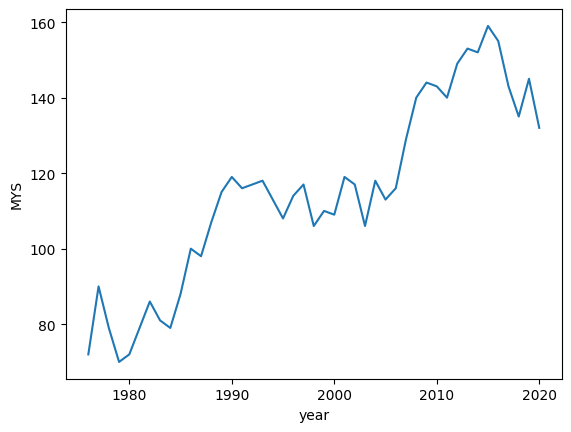

In [ ]:
import seaborn as sns

temp_df = pd.DataFrame()
temp_result_list = []
for year in range(start_year,end_year+1):
    temp_list = []
    temp_list.append(year)
    temp_list.append(np.sum(binary_rca[year].loc['MYS']))
    temp_result_list.append(temp_list)

temp_df = pd.DataFrame(temp_result_list, columns=['year','MYS'])
sns.lineplot(x='year',y='MYS',data=temp_df)

In [ ]:
binary_rta[2000].shape

(101, 658)

# Proximity

In [ ]:
def Proximity_network(M, rows=False):
    if rows:
        M = M.transpose()
    Cooc = np.matmul(np.transpose(M),M)
    ubiquity = M.sum(0)
    ubiMat = np.tile(ubiquity,[M.shape[1],1])
    ubiMax = np.maximum(ubiMat,np.transpose(ubiMat)).astype(float)
    np.divide(np.ones_like(ubiMax,dtype=float), ubiMax, out=ubiMax, where=ubiMax != 0)
    Product_Space = np.multiply(Cooc,ubiMax)
    return Product_Space

In [ ]:
proximity_product = {}
for year in range(start_year, end_year+1):
    proximity_product[year] = Proximity_network(binary_rca[year].to_numpy())

proximity_technology = {}
for year in range(start_year, end_year+1):
    proximity_technology[year] = Proximity_network(binary_rta[year].to_numpy())

In [ ]:
import numpy as np

def Co_proximity_network_n(Mcp, Mct, rows=False):
    temp_intersection = list(set(Mcp.index).intersection(Mct.index))
    Mcp = Mcp.loc[temp_intersection].to_numpy().copy()
    Mct = Mct.loc[temp_intersection].to_numpy().copy()

    # Compute the co-occurrence matrix
    Cooc = np.matmul(np.transpose(Mcp), Mct)

    # Calculate the ubiquity of products and technologies
    ubiquity_product = Mcp.sum(0)
    ubiquity_technology = Mct.sum(0)

    # Create ubiquity matrices by repeating rows
    ubiMat_product = np.tile(ubiquity_product, (Mcp.shape[1], 1))
    ubiMat_technology = np.tile(ubiquity_technology, (Mct.shape[1], 1))

    # Calculate the maximum ubiquity matrix for products and technologies
    ubiMax_product = np.maximum(ubiMat_product, np.transpose(ubiMat_product)).astype(float)
    ubiMax_technology = np.maximum(ubiMat_technology, np.transpose(ubiMat_technology)).astype(float)

    # Avoid division by zero; invert the ubiquity matrix
    np.divide(1, ubiMax_product, out=ubiMax_product, where=ubiMax_product != 0)
    np.divide(1, ubiMax_technology, out=ubiMax_technology, where=ubiMax_technology != 0)

    # 새로운 (782, 658) 크기의 행렬 생성
    result_matrix = np.zeros((782, 658))

    # 행렬 생성 과정
    for i in range(782):
        for j in range(658):
            # ubiMax_product의 i행, ubiMax_technology의 j열의 성분 중 큰 값 선택
            result_matrix[i, j] = max(ubiMax_product[i, i], ubiMax_technology[j, j])

    Co_Space = np.multiply(result_matrix,Cooc)
    return Co_Space


In [ ]:
Co_proximity_n = {}
for year in range(start_year, end_year+1):
    Co_proximity_n[year] = pd.DataFrame(Co_proximity_network_n(binary_rca[year], binary_rta[year]),index = binary_rca[year].columns, columns = binary_rta[year].columns)

In [ ]:
import numpy as np

def Co_proximity_network_p(Mcp, Mct, rows=False):
    temp_intersection = list(set(Mcp.index).intersection(Mct.index))
    Mcp = Mcp.loc[temp_intersection].to_numpy().copy()
    Mct = Mct.loc[temp_intersection].to_numpy().copy()

    # Compute the co-occurrence matrix
    Cooc = np.matmul(np.transpose(Mcp), Mct)

    # Calculate the ubiquity of products and technologies
    ubiquity_product = Mcp.sum(0)
    ubiquity_technology = Mct.sum(0)

    # Create ubiquity matrices by repeating rows
    ubiMat_product = np.tile(ubiquity_product, (Mcp.shape[1], 1))
    ubiMat_technology = np.tile(ubiquity_technology, (Mct.shape[1], 1))

    # Calculate the maximum ubiquity matrix for products and technologies
    ubiMax_product = np.maximum(ubiMat_product, np.transpose(ubiMat_product)).astype(float)
    ubiMax_technology = np.maximum(ubiMat_technology, np.transpose(ubiMat_technology)).astype(float)

    # Avoid division by zero; invert the ubiquity matrix
    np.divide(1, ubiMax_product, out=ubiMax_product, where=ubiMax_product != 0)
    np.divide(1, ubiMax_technology, out=ubiMax_technology, where=ubiMax_technology != 0)

    # 새로운 (782, 658) 크기의 행렬 생성
    result_matrix = np.zeros((782, 658))

    # 행렬 생성 과정
    for i in range(782):
        for j in range(658):
            # ubiMax_product의 i행, ubiMax_technology의 j열의 성분 중 큰 값 선택
            result_matrix[i, j] = (ubiMax_product[i, i])
    Co_Space = np.multiply(result_matrix,Cooc)
    return Co_Space

import numpy as np

def Co_proximity_network_t(Mcp, Mct, rows=False):
    temp_intersection = list(set(Mcp.index).intersection(Mct.index))
    Mcp = Mcp.loc[temp_intersection].to_numpy().copy()
    Mct = Mct.loc[temp_intersection].to_numpy().copy()

    # Compute the co-occurrence matrix
    Cooc = np.matmul(np.transpose(Mcp), Mct)

    # Calculate the ubiquity of products and technologies
    ubiquity_product = Mcp.sum(0)
    ubiquity_technology = Mct.sum(0)

    # Create ubiquity matrices by repeating rows
    ubiMat_product = np.tile(ubiquity_product, (Mcp.shape[1], 1))
    ubiMat_technology = np.tile(ubiquity_technology, (Mct.shape[1], 1))

    # Calculate the maximum ubiquity matrix for products and technologies
    ubiMax_product = np.maximum(ubiMat_product, np.transpose(ubiMat_product)).astype(float)
    ubiMax_technology = np.maximum(ubiMat_technology, np.transpose(ubiMat_technology)).astype(float)

    # Avoid division by zero; invert the ubiquity matrix
    np.divide(1, ubiMax_product, out=ubiMax_product, where=ubiMax_product != 0)
    np.divide(1, ubiMax_technology, out=ubiMax_technology, where=ubiMax_technology != 0)

    # 새로운 (782, 658) 크기의 행렬 생성
    result_matrix = np.zeros((782, 658))

    # 행렬 생성 과정
    for i in range(782):
        for j in range(658):
            # ubiMax_product의 i행, ubiMax_technology의 j열의 성분 중 큰 값 선택
            result_matrix[i, j] = (ubiMax_technology[j, j])
    Co_Space = np.multiply(result_matrix,Cooc)
    return Co_Space


In [ ]:
Co_proximity_p = {}
Co_proximity_t = {}
for year in range(start_year, end_year+1):
    Co_proximity_p[year] = pd.DataFrame(Co_proximity_network_p(binary_rca[year], binary_rta[year]),index = binary_rca[year].columns, columns = binary_rta[year].columns)
    Co_proximity_t[year] = pd.DataFrame(Co_proximity_network_t(binary_rca[year], binary_rta[year]),index = binary_rca[year].columns, columns = binary_rta[year].columns)

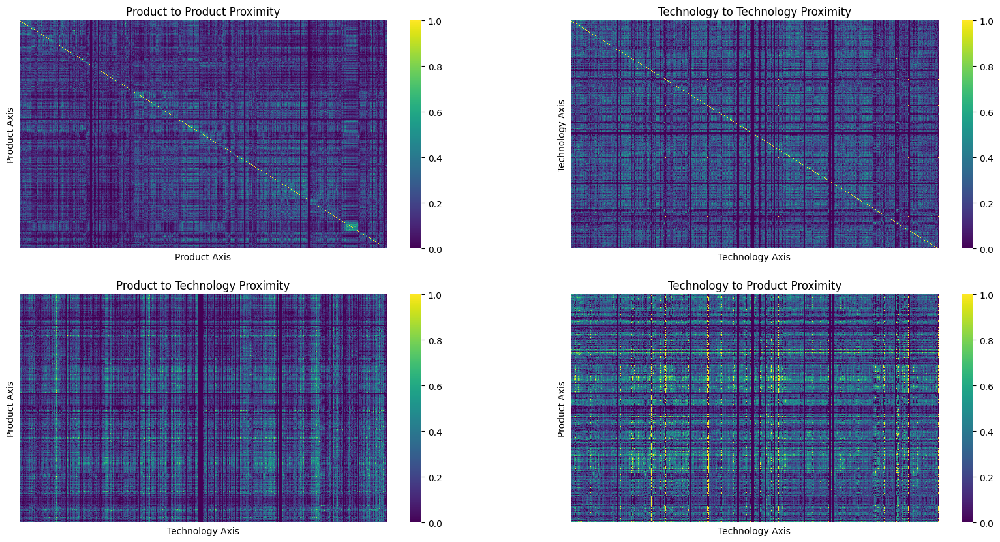

In [ ]:
import seaborn as sns

year = 2020

fig, ax = plt.subplots(2, 2, figsize=(20, 10))

ax[0, 0].set_title('Product to Product Proximity')
sns.heatmap(proximity_product[year], ax=ax[0, 0], cmap='viridis', cbar=True, xticklabels=False, yticklabels=False)
ax[0, 0].set_xlabel('Product Axis')
ax[0, 0].set_ylabel('Product Axis')


ax[0, 1].set_title('Technology to Technology Proximity')
sns.heatmap(proximity_technology[year], ax=ax[0, 1], cmap='viridis', cbar=True, xticklabels=False, yticklabels=False)
ax[0, 1].set_xlabel('Technology Axis')
ax[0, 1].set_ylabel('Technology Axis')

ax[1, 0].set_title('Product to Technology Proximity')
sns.heatmap(Co_proximity_p[year], ax=ax[1, 0], cmap='viridis', cbar=True, xticklabels=False, yticklabels=False)
ax[1, 0].set_xlabel('Technology Axis')
ax[1, 0].set_ylabel('Product Axis')

ax[1, 1].set_title('Technology to Product Proximity')
sns.heatmap(Co_proximity_t[year], ax=ax[1, 1], cmap='viridis', cbar=True, xticklabels=False, yticklabels=False)
ax[1, 1].set_xlabel('Technology Axis')
ax[1, 1].set_ylabel('Product Axis')

plt.savefig(f'Output/Proximity_heatmap_{year}.jpg',dpi = 300)



In [ ]:
import seaborn as sns

year = 2018

for year in range(start_year,end_year+1):

    fig, ax = plt.subplots(2, 2, figsize=(20, 10))

    ax[0, 0].set_title('Product to Product Proximity')
    sns.heatmap(proximity_product[year], ax=ax[0, 0], cmap='viridis', cbar=True, xticklabels=False, yticklabels=False)
    ax[0, 0].set_xlabel('Product Axis')
    ax[0, 0].set_ylabel('Product Axis')


    ax[0, 1].set_title('Technology to Technology Proximity')
    sns.heatmap(proximity_technology[year], ax=ax[0, 1], cmap='viridis', cbar=True, xticklabels=False, yticklabels=False)
    ax[0, 1].set_xlabel('Technology Axis')
    ax[0, 1].set_ylabel('Technology Axis')

    ax[1, 0].set_title('Product to Technology Proximity')
    sns.heatmap(Co_proximity_p[year], ax=ax[1, 0], cmap='viridis', cbar=True, xticklabels=False, yticklabels=False)
    ax[1, 0].set_xlabel('Technology Axis')
    ax[1, 0].set_ylabel('Product Axis')

    ax[1, 1].set_title('Technology to Product Proximity')
    sns.heatmap(Co_proximity_t[year], ax=ax[1, 1], cmap='viridis', cbar=True, xticklabels=False, yticklabels=False)
    ax[1, 1].set_xlabel('Technology Axis')
    ax[1, 1].set_ylabel('Product Axis')

    plt.savefig(f'Output/Proximity_heatmap_{year}.jpg',dpi = 300)
    plt.close(fig)


In [ ]:
proximity_product[2020].shape

(782, 782)

In [ ]:
proximity_technology[2020].shape

(658, 658)

In [ ]:
Co_proximity_p[2020].shape

(782, 658)

# Density

In [ ]:
def predict_from_density(similarity_matrix, mcp):
    similarity_matrix = similarity_matrix.transpose()
    row = similarity_matrix.sum(1)
    pr = np.divide(np.dot(mcp, similarity_matrix),row, where=row != 0)
    pr[np.where(np.isnan(pr))] = 0
    return pr

In [ ]:
density_production = {}
for year in range(start_year, end_year+1):
    density_production[year] = pd.DataFrame(predict_from_density(proximity_product[year], binary_rca[year].to_numpy()), index=binary_rca[year].index, columns=binary_rca[year].columns)

density_technology = {}
for year in range(start_year, end_year+1):
    density_technology[year] = pd.DataFrame(predict_from_density(proximity_technology[year], binary_rta[year].to_numpy()), index=binary_rta[year].index, columns=binary_rta[year].columns)

In [ ]:
temp_countries = list(set(binary_rca[start_year].index).intersection(binary_rta[start_year].index))

In [ ]:
def predict_from_co_density(co_proximity_technology, mct, mcp):
    mct = mct.loc[temp_countries]
    mct = mct.to_numpy()
    co_proximity_technology = co_proximity_technology.transpose()
    row = co_proximity_technology.sum(axis = 0)
    pr = np.divide(np.dot(mct, co_proximity_technology),row, where=row != 0)
    pr[np.where(np.isnan(pr))] = 0
    return pr

In [ ]:
def predict_from_co_density_from_tech(co_proximity_technology, mct):
    mct = mct.loc[temp_countries]
    mct = mct.to_numpy()
    co_proximity_technology = co_proximity_technology.transpose()
    row = co_proximity_technology.sum(axis = 0)
    pr = np.divide(np.dot(mct, co_proximity_technology),row, where=row != 0)
    pr[np.where(np.isnan(pr))] = 0
    return pr

def predict_from_co_density_from_prod(co_proximity_product, mcp):
    mcp = mcp.loc[temp_countries]
    mcp = mcp.to_numpy()
    row = co_proximity_product.sum(axis = 0)
    pr = np.divide(np.dot(mcp, co_proximity_product),row, where=row != 0)
    pr[np.where(np.isnan(pr))] = 0
    return pr

In [ ]:
density_dict_from_prod = {}
for year in range(start_year, end_year+1):
    density_dict_from_prod[year] = pd.DataFrame(predict_from_co_density_from_prod(Co_proximity_p[year].to_numpy(), binary_rca[year]), index = temp_countries, columns = binary_rta[start_year].columns)

density_dict_from_technology = {}
for year in range(start_year, end_year+1):
    density_dict_from_technology[year] = pd.DataFrame(predict_from_co_density_from_tech(Co_proximity_t[year].to_numpy(), binary_rta[year]), index = temp_countries, columns = binary_rca[start_year].columns)

# Relative Relatedness

In [ ]:
Opportunity_product = {}
for year in range(start_year, end_year+1):
  Opportunity_product[year] = binary_rca[year].copy()
  # Transform Opportunity_product: Set values of 1 to 0 and other values to 1
  Opportunity_product[year] = Opportunity_product[year].applymap(lambda x: 0 if x == 1 else 1)

In [ ]:
Relative_density_production = {}
for year in tqdm(range(start_year, end_year+1)):
  temp_mat = density_production[year].copy()
  for temp_country in temp_mat.index:
    Ops = Opportunity_product[year].loc[temp_country][Opportunity_product[year].loc[temp_country]!=0].index
    temp_std = density_production[year].loc[temp_country][Ops].std()
    temp_mean = density_production[year].loc[temp_country][Ops].mean()
    relative_density = (density_production[year].loc[temp_country] - temp_mean)/temp_std
    temp_mat.loc[temp_country] = relative_density
  Relative_density_production[year] = temp_mat

100%|██████████| 45/45 [00:07<00:00,  6.43it/s]


In [ ]:
Opportunity_technology = {}
for year in range(start_year, end_year+1):
  Opportunity_technology[year] = binary_rta[year].copy()
  # Transform Opportunity_technology: Set values of 1 to 0 and other values to 1
  Opportunity_technology[year] = Opportunity_technology[year].applymap(lambda x: 0 if x == 1 else 1)

In [ ]:
Relative_density_technology = {}
for year in tqdm(range(start_year, end_year+1)):
  temp_mat = density_technology[year].copy()
  for temp_country in temp_mat.index:
    Ops = Opportunity_technology[year].loc[temp_country][Opportunity_technology[year].loc[temp_country]!=0].index
    temp_std = density_technology[year].loc[temp_country][Ops].std()
    temp_mean = density_technology[year].loc[temp_country][Ops].mean()
    relative_density = (density_technology[year].loc[temp_country] - temp_mean)/temp_std
    temp_mat.loc[temp_country] = relative_density
  Relative_density_technology[year] = temp_mat

100%|██████████| 45/45 [00:02<00:00, 16.05it/s]


In [ ]:
Relative_pci = {}

for year in tqdm(range(start_year, end_year + 1)):
    # Initialize a matrix with zeros, same shape as binary_rca[start_year]
    temp_mat = pd.DataFrame(np.zeros((len(binary_rca[start_year].index), len(binary_rca[start_year].columns))),
                            index=binary_rca[start_year].index, columns=binary_rca[start_year].columns)

    # Loop through each country in the index
    for temp_country in temp_mat.index:
        # Get the opportunity_product set (Ops) for the country, filtering non-zero columns
        Ops = Opportunity_product[year].loc[temp_country][Opportunity_product[year].loc[temp_country] != 0].index

        # Calculate mean and standard deviation of PCI for the opportunity_product set
        if not Ops.empty:
            temp_std = pci[year].loc[Ops].std()
            temp_mean = pci[year].loc[Ops].mean()

            # Calculate relative PCI, only for products in Ops
            relative_pci = (pci[year] - temp_mean) / temp_std
            relative_pci = relative_pci.fillna(0)  # Reindex to ensure all columns are included

            # Assign relative PCI to the corresponding row in temp_mat
            temp_mat.loc[temp_country] = relative_pci

    # Store the matrix for the year
    Relative_pci[year] = temp_mat


100%|██████████| 45/45 [00:06<00:00,  6.68it/s]


In [ ]:
Relative_tci = {}

for year in tqdm(range(start_year, end_year + 1)):
    # Initialize a matrix with zeros, same shape as binary_rta[start_year]
    temp_mat = pd.DataFrame(np.zeros((len(binary_rta[start_year].index), len(binary_rta[start_year].columns))),
                            index=binary_rta[start_year].index, columns=binary_rta[start_year].columns)

    # Loop through each country in the index
    for temp_country in temp_mat.index:
        # Get the opportunity_product set (Ops) for the country, filtering non-zero columns
        Ops = Opportunity_technology[year].loc[temp_country][Opportunity_technology[year].loc[temp_country] != 0].index

        # Calculate mean and standard deviation of tci for the opportunity_product set
        if not Ops.empty:
            temp_std = tci[year].loc[Ops].std()
            temp_mean = tci[year].loc[Ops].mean()

            # Calculate relative tci, only for products in Ops
            relative_tci = (tci[year] - temp_mean) / temp_std
            relative_tci = relative_tci.fillna(0)  # Reindex to ensure all columns are included

            # Assign relative tci to the corresponding row in temp_mat
            temp_mat.loc[temp_country] = relative_tci

    # Store the matrix for the year
    Relative_tci[year] = temp_mat


100%|██████████| 45/45 [00:03<00:00, 12.92it/s]


In [ ]:
Relative_density_from_production = {}
for year in tqdm(range(start_year, end_year+1)):
  temp_mat = density_dict_from_prod[year].copy()
  for temp_country in temp_mat.index:
    Ops = Opportunity_technology[year].loc[temp_country][Opportunity_technology[year].loc[temp_country]!=0].index
    temp_std = density_dict_from_prod[year].loc[temp_country][Ops].std()
    temp_mean = density_dict_from_prod[year].loc[temp_country][Ops].mean()
    relative_density = (density_dict_from_prod[year].loc[temp_country] - temp_mean)/temp_std
    temp_mat.loc[temp_country] = relative_density
  Relative_density_from_production[year] = temp_mat

100%|██████████| 45/45 [00:02<00:00, 16.77it/s]


In [ ]:
# Version 1

Relative_density_from_technology = {}
for year in tqdm(range(start_year, end_year+1)):
  temp_mat = density_dict_from_technology[year].copy()
  for temp_country in temp_mat.index:
    Ops = Opportunity_product[year].loc[temp_country][Opportunity_product[year].loc[temp_country]!=0].index
    temp_std = density_dict_from_technology[year].loc[temp_country][Ops].std()
    temp_mean = density_dict_from_technology[year].loc[temp_country][Ops].mean()
    relative_density = (density_dict_from_technology[year].loc[temp_country] - temp_mean)/temp_std
    temp_mat.loc[temp_country] = relative_density
  Relative_density_from_technology[year] = temp_mat

100%|██████████| 45/45 [00:02<00:00, 15.92it/s]


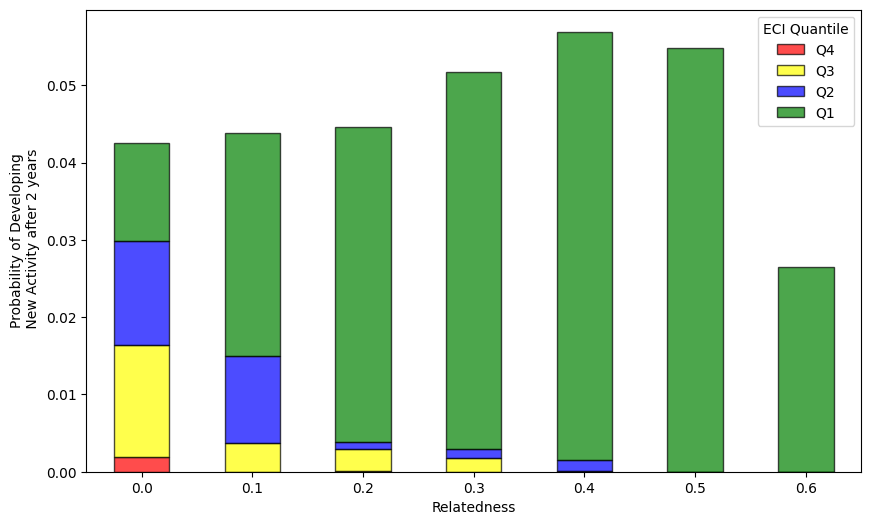

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.1 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci_product[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity_product[year] * binary_rca[year + 2] * density_dict_from_technology[year]).loc[Q_dict[Q]] > i) & \
                             ((Opportunity_product[year] * binary_rca[year + 2] * density_dict_from_technology[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity_product[year] * density_dict_from_technology[year]) > i) & \
                               ((Opportunity_product[year] * density_dict_from_technology[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios

years = range(1984, 2012)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red","yellow",'blue',"green"]

# Plot the stacked bar chart with specified colors
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors)
plt.xlabel("Relatedness")
plt.ylabel("Probability of Developing\n New Activity after 2 years")
plt.xticks(rotation=0)
plt.legend(title="ECI Quantile")
plt.show()


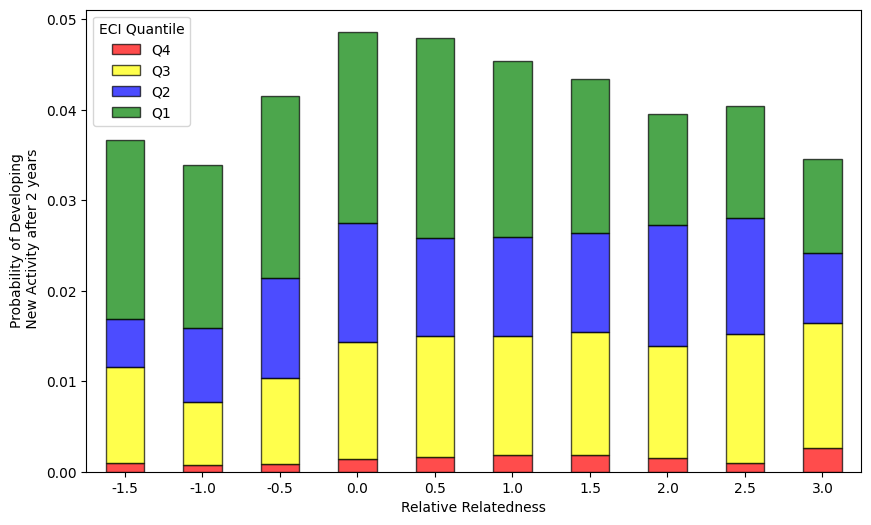

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


bins = [-1.5, -1, -0.5, 0, 0.5, 1.0, 1.5, 2, 2.5, 3]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.4 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci_product[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity_product[year] * binary_rca[year + 2] * Relative_density_from_technology[year]).loc[Q_dict[Q]] > i) & \
                             ((Opportunity_product[year] * binary_rca[year + 2] * Relative_density_from_technology[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity_product[year] * Relative_density_from_technology[year]) > i) & \
                               ((Opportunity_product[year] * Relative_density_from_technology[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios

# Apply the function to each quartile
years = range(1984, 2012)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red","yellow",'blue',"green"]

# Plot the stacked bar chart with specified colors
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors)
plt.xlabel("Relative Relatedness")
plt.ylabel("Probability of Developing\n New Activity after 2 years")
plt.xticks(rotation=0)
plt.legend(title="ECI Quantile")
plt.show()


# Country Object

In [ ]:
#GDP_pc = pd.DataFrame(index=binary_rca[start_year].index, columns=range(min(temp_pwt_data.year), max(temp_pwt_data.year)+1))
#for i in range(min(temp_pwt_data.year), max(temp_pwt_data.year)+1):
#    temp_df = temp_pwt_data[temp_pwt_data['year']==i]
#    GDP_pc[i] = pd.Series(temp_df['GDP_pc'].values, index=temp_df['countrycode'].values)
#GDP_pc

In [ ]:
class COUNTRY():
  def __init__(self,name,year):
    self.name=name
    self.year=year
    self.rca_dict=None
    self.rca_ref_dict=None
    self.rta_dict=None
    self.rta_ref_dict=None
    self.export_dict=None
    self.ipc_dict=None
    self.production_density_dict=None
    self.production_density_dict_relative = None
    self.technology_density_dict=None
    self.technology_density_dict_relative = None
    self.coevolutionary_density_dict=None
    self.coevolutionary_density_dict_relative = None
    self.eci=None
    self.diversification_dict=None
    self.GDP_per_capita=None

class Proximity_Matrix():
  def __init__(self,year):
    self.year=year
    self.proximity_dict=None
    self.codes=None


In [ ]:
country_list = []

for year in tqdm(range(start_year,end_year+1)):
    for temp_country in temp_countries:
        temp_country_obj = COUNTRY(temp_country,year)
        temp_country_obj.name = temp_country
        temp_country_obj.export_dict = dict(export[year].loc[temp_country])
        temp_country_obj.ipc_dict = dict(patent[year].loc[temp_country])
        temp_country_obj.rca_dict = dict(rca[year].loc[temp_country])
        temp_country_obj.rta_dict = dict(rta[year].loc[temp_country])
        temp_country_obj.rca_ref_dict = dict(binary_rca[year].loc[temp_country])
        temp_country_obj.rta_ref_dict = dict(binary_rta[year].loc[temp_country])

        temp_country_obj.production_density_dict = dict(density_production[year].loc[temp_country])
        temp_country_obj.technology_density_dict = dict(density_technology[year].loc[temp_country])
        temp_country_obj.production_density_dict_relative = dict(Relative_density_production[year].loc[temp_country])
        temp_country_obj.technology_density_dict_relative = dict(Relative_density_technology[year].loc[temp_country])


        temp_country_obj.coevolutionary_density_dict = dict(density_dict_from_prod[year].loc[temp_country])
        temp_country_obj.coevolutionary_density_dict.update(dict(density_dict_from_technology[year].loc[temp_country]))

        temp_country_obj.coevolutionary_density_dict_relative = dict(Relative_density_from_production[year].loc[temp_country])
        temp_country_obj.coevolutionary_density_dict_relative.update(dict(Relative_density_from_technology[year].loc[temp_country]))

        temp_country_obj.eci = eci_product[year].loc[temp_country]
        #temp_country_obj.diversification_dict = diversification_product[year].loc[temp_country]
        if year >= 1990 and temp_country in GDP_pc.index:
            temp_country_obj.GDP_per_capita = GDP_pc.loc[temp_country,year]
        #except:
        #    temp_country_obj.GDP_per_capita = None
        country_list.append(temp_country_obj)

100%|██████████| 45/45 [01:02<00:00,  1.38s/it]


In [ ]:
pd.DataFrame(proximity_product[year], index = binary_rca[year].columns, columns = binary_rca[year].columns)

,0011,0012,0013,0014,0015,0019,0111,0112,0113,0114,...,8996,8997,8998,8999,9110,9310,9410,9510,9610,9710
0011,1.000000,0.550000,0.375000,0.375000,0.175000,0.0,0.350000,0.175000,0.275000,0.325000,...,0.175000,0.075000,0.025000,0.075000,0.0,0.214286,0.241379,0.250000,0.225000,0.196721
0012,0.550000,1.000000,0.161290,0.354839,0.129032,0.0,0.225806,0.193548,0.161290,0.322581,...,0.064516,0.000000,0.096774,0.096774,0.0,0.107143,0.224138,0.225806,0.125000,0.196721
0013,0.375000,0.161290,1.000000,0.322581,0.277778,0.0,0.172414,0.166667,0.500000,0.333333,...,0.185185,0.166667,0.111111,0.050000,0.0,0.125000,0.172414,0.291667,0.125000,0.049180
0014,0.375000,0.354839,0.322581,1.000000,0.193548,0.0,0.258065,0.129032,0.354839,0.354839,...,0.322581,0.225806,0.096774,0.064516,0.0,0.178571,0.224138,0.290323,0.250000,0.147541
0015,0.175000,0.129032,0.277778,0.193548,1.000000,0.0,0.172414,0.294118,0.235294,0.166667,...,0.296296,0.041667,0.176471,0.100000,0.0,0.142857,0.103448,0.041667,0.156250,0.098361
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9310,0.214286,0.107143,0.125000,0.178571,0.142857,0.0,0.196429,0.071429,0.178571,0.125000,...,0.250000,0.142857,0.053571,0.071429,0.0,1.000000,0.362069,0.142857,0.214286,0.180328
9410,0.241379,0.224138,0.172414,0.224138,0.103448,0.0,0.137931,0.068966,0.172414,0.189655,...,0.189655,0.120690,0.034483,0.034483,0.0,0.362069,1.000000,0.137931,0.172414,0.311475
9510,0.250000,0.225806,0.291667,0.290323,0.041667,0.0,0.206897,0.041667,0.250000,0.291667,...,0.185185,0.083333,0.083333,0.000000,0.0,0.142857,0.137931,1.000000,0.250000,0.081967
9610,0.225000,0.125000,0.125000,0.250000,0.156250,0.0,0.187500,0.125000,0.218750,0.093750,...,0.250000,0.125000,0.031250,0.000000,0.0,0.214286,0.172414,0.250000,1.000000,0.131148


In [ ]:
Product_PM_list=[]

for year in tqdm(range(start_year,end_year+1)):
  Proximity_Matrix_obj=Proximity_Matrix(year)
  temp_dict = {}
  for i in range(len(binary_rca[year].columns)):
    for j in range(i, len(binary_rca[year].columns)):
      temp_key1 = binary_rca[year].columns[i]
      temp_key2 = binary_rca[year].columns[j]
      temp_dict[(temp_key1,temp_key2)] = proximity_product[year][i,j]
  Proximity_Matrix_obj.proximity_dict= temp_dict
  Proximity_Matrix_obj.codes=binary_rca[year].columns
  Product_PM_list.append(Proximity_Matrix_obj)

100%|██████████| 45/45 [00:13<00:00,  3.27it/s]


In [ ]:
Technology_PM_list=[]

for year in tqdm(range(start_year,end_year+1)):
  Proximity_Matrix_obj=Proximity_Matrix(year)
  temp_dict = {}
  for i in range(len(binary_rta[year].columns)):
    for j in range(i, len(binary_rta[year].columns)):
      temp_key1 = binary_rta[year].columns[i]
      temp_key2 = binary_rta[year].columns[j]
      temp_dict[(temp_key1,temp_key2)] = proximity_technology[year][i,j]
  Proximity_Matrix_obj.proximity_dict= temp_dict
  Proximity_Matrix_obj.codes=binary_rta[year].columns
  Technology_PM_list.append(Proximity_Matrix_obj)

100%|██████████| 45/45 [00:10<00:00,  4.34it/s]


In [ ]:
CO_PM_list=[]

for year in tqdm(range(start_year,end_year+1)):
  Proximity_Matrix_obj=Proximity_Matrix(year)
  temp_dict = {}
  for i in range(len(binary_rca[year].columns)):
    for j in range(i, len(binary_rta[year].columns)):
      temp_key1 = binary_rca[year].columns[i]
      temp_key2 = binary_rta[year].columns[j]
      temp_dict[(temp_key1,temp_key2)] = Co_proximity_p[year].iloc[i,j]
  Proximity_Matrix_obj.proximity_dict= temp_dict
  Proximity_Matrix_obj.codes=list(binary_rta[year].columns).extend(list(binary_rca[year].columns))
  CO_PM_list.append(Proximity_Matrix_obj)

100%|██████████| 45/45 [01:49<00:00,  2.43s/it]


In [ ]:
year_list=[year for year in range(1980,end_year+1)]

In [ ]:
import matplotlib.colors as mcolors
from networkx.algorithms.community import greedy_modularity_communities
from networkx.drawing.nx_pydot import graphviz_layout
import seaborn as sns #; sns.set_theme(color_codes=True)
from scipy.cluster.hierarchy import linkage, dendrogram
from scipy.cluster.hierarchy import fcluster
from sklearn.preprocessing import minmax_scale
from mpl_toolkits.mplot3d import axes3d
from adjustText import adjust_text
import networkx as nx


# Structure of Product and Technology

In [ ]:
# routine generating a new matrix ordered (this can be done in simpler ways)
def matrix_ordering(matrix, order_row, order_columns):
    # create a new matrix
    ordered_matrix = np.zeros(np.shape(matrix))

    # the loops can be slow in pythons. References to the appropriate python libraries are usually faster
    for c in range(len(order_row)):
        for p in range(len(order_columns)):
            ordered_matrix[c,p] = matrix.loc[order_row[c],order_columns[p]]

    return ordered_matrix


# Product Space

In [ ]:
color_list=list(mcolors.TABLEAU_COLORS)
len(color_list)

10

In [ ]:
sitc_code_dict={
    "0":"Food and Live Animals",
    "1":"Beverage and Tobacco",
    "2":"Crude Materials",
    "3":"Mineral, Fuels, Lubricants and Related Material",
    "4":"Animal and Vegetable Oils and Fats",
    "5":"Chemicals and Related Products",
    "6":"Manufacturing and Goods",
    "7":"Machinerary and Transport Equipment",
    "8":"Miscellaneous Manufacturing Articles",
    "9":"Commodities and Transactions not classified elsewhere in SITC"
}

In [ ]:
sitc_code_color_dict={
    "0":color_list[0],
    "1":color_list[1],
    "2":color_list[2],
    "3":color_list[3],
    "4":color_list[4],
    "5":color_list[5],
    "6":color_list[6],
    "7":color_list[7],
    "8":color_list[8],
    "9":color_list[9]
    }

In [ ]:
output_path = 'Output/'

In [ ]:
def Product_Space(input_Proximity_Matrix,threshold,temp_title):
  ## Construction Network
  temp_nodes=sorted(input_Proximity_Matrix.codes)
  temp_G=nx.Graph()
  for i in range(len(temp_nodes)):
    temp_G.add_node(temp_nodes[i])
    for j in range(i+1,len(temp_nodes)):
      if (temp_nodes[i],temp_nodes[j]) in input_Proximity_Matrix.proximity_dict.keys():
        if input_Proximity_Matrix.proximity_dict[(temp_nodes[i],temp_nodes[j])]>=threshold:
          temp_G.add_edge(temp_nodes[i],temp_nodes[j],weight=input_Proximity_Matrix.proximity_dict[(temp_nodes[i],temp_nodes[j])])
  pos1=nx.spring_layout(temp_G)

  # Network Figure
  temp_countries=[country for country in country_list if country.year==input_Proximity_Matrix.year]
  temp_list=[]
  for country in temp_countries:
    temp_list+=[country.export_dict[sitc] for sitc in country.export_dict.keys()]
  temp_max=max(temp_list)
  temp_min=min(temp_list)
  fig=plt.figure(figsize=(20,20))
  ax=plt.subplot(111)
  for i in range(1,10):
    temp_sub_nodes=[node for node in temp_nodes if len(node)==4 if node[0]==str(i)]
    node_size_list=[]
    for node in temp_sub_nodes:
      temp_value=0
      temp_value=sum([300*(country.export_dict[node]-temp_min)/(temp_max-temp_min) for country in temp_countries if node in country.export_dict.keys()])
      node_size_list.append(temp_value)
    nx.draw_networkx_nodes(temp_G,pos=pos1,nodelist=temp_sub_nodes,node_size=node_size_list,node_color=sitc_code_color_dict[str(i)],alpha=0.5,ax=ax)

  temp_sub_nodes=[node for node in temp_nodes if len(node)!=4]
  node_size_list=[]
  for node in temp_sub_nodes:
    temp_value=0
    temp_value=sum([300*(country.export_dict[node]-temp_min)/(temp_max-temp_min) for country in temp_countries if node in country.export_dict.keys()])
    node_size_list.append(temp_value)
  nx.draw_networkx_nodes(temp_G,pos=pos1,nodelist=temp_sub_nodes,node_size=node_size_list,node_color=sitc_code_color_dict[str(0)],alpha=0.5,ax=ax)

  nx.draw_networkx_edges(temp_G,pos=pos1,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>=0.5 if temp_G[x[0]][x[1]]["weight"]<0.55],alpha=0.5,edge_color="grey",ax=ax)
  nx.draw_networkx_edges(temp_G,pos=pos1,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>0.55 if temp_G[x[0]][x[1]]["weight"]<0.6],alpha=1,edge_color="blue",ax=ax)
  nx.draw_networkx_edges(temp_G,pos=pos1,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>=0.6],alpha=1,edge_color="red",ax=ax)

  # Boundary
  ax.set_xlim(min(pos1[x][0] for x in pos1.keys()),
            max(pos1[x][0] for x in pos1.keys()))
  ax.set_ylim(min(pos1[x][1] for x in pos1.keys()),
            max(pos1[x][1] for x in pos1.keys()))

  # Legend
  temp_arr_list=[]
  temp_key_list=[]
  for key in sitc_code_dict.keys():
    temp_arr_list.append(
        plt.arrow(0,0, 0,0, head_width=0, color=sitc_code_color_dict[key], length_includes_head=True,label=sitc_code_dict[key])
    )
    temp_key_list.append(
        sitc_code_dict[key]
    )
  ax.legend(temp_arr_list,temp_key_list,fontsize=20, loc='upper left')
  plt.tight_layout()
  plt.savefig(output_path+"/"+temp_title+".jpg",dpi=300,transparent=True,bbox_inches="tight")
  plt.close(fig)
  return temp_G, pos1

In [ ]:
# highlight in product space
def Product_Space_with_highlight(temp_G,temp_pos,points,temp_title):
  # Network Figure
  year=year_list[temp_product_space_list.index(temp_G)]
  temp_countries=[country for country in country_list if country.year==year]

  temp_countries=[country for country in country_list if country.year==input_Proximity_Matrix.year]
  temp_list=[]
  for country in temp_countries:
    temp_list+=[country.export_dict[sitc] for sitc in country.export_dict.keys()]
  temp_max=max(temp_list)
  temp_min=min(temp_list)

  fig=plt.figure(figsize=(20,20))
  temp_node_size_dict={}
  for i in range(1,10):
    temp_sub_nodes=[node for node in temp_G.nodes() if len(node)==4 if node[0]==str(i)]
    node_size_list=[]
    for node in temp_sub_nodes:
      temp_value=0
      temp_value=sum([300*(country.export_dict[node]-temp_min)/(temp_max-temp_min) for country in temp_countries if node in country.export_dict.keys()])
      node_size_list.append(temp_value)
      temp_node_size_dict[node]=float(temp_value)
    nx.draw_networkx_nodes(temp_G,pos=temp_pos,nodelist=temp_sub_nodes,node_size=node_size_list,node_color='grey',alpha=0.3)

  temp_sub_nodes=[node for node in temp_G.nodes() if len(node)!=4]
  node_size_list=[]
  for node in temp_sub_nodes:
    temp_value=0
    temp_value=sum([300*(country.export_dict[node]-temp_min)/(temp_max-temp_min) for country in temp_countries if node in country.export_dict.keys()])
    node_size_list.append(temp_value)
    temp_node_size_dict[node]=float(temp_value)
  nx.draw_networkx_nodes(temp_G,pos=temp_pos,nodelist=temp_sub_nodes,node_size=node_size_list,node_color='grey',alpha=0.3)
  nx.draw_networkx_edges(temp_G,pos=temp_pos,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>=0.5 if temp_G[x[0]][x[1]]["weight"]<0.55],alpha=0.5,edge_color="grey")
  nx.draw_networkx_edges(temp_G,pos=temp_pos,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>0.55 if temp_G[x[0]][x[1]]["weight"]<0.6],alpha=1,edge_color="blue")
  nx.draw_networkx_edges(temp_G,pos=temp_pos,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>=0.6],alpha=1,edge_color="red")

  # Highlight
  nx.draw_networkx_nodes(temp_G,pos=temp_pos,nodelist=points,node_size=[temp_node_size_dict[n] for n in points if n in temp_node_size_dict.keys()],node_color='black',alpha=0.8)

  # Boundary
  plt.xlim(min(temp_pos[x][0] for x in temp_pos.keys()),
            max(temp_pos[x][0] for x in temp_pos.keys()))

  plt.ylim(min(temp_pos[x][1] for x in temp_pos.keys()),
            max(temp_pos[x][1] for x in temp_pos.keys()))

  # Legend
  plt.savefig(output_path+"/"+temp_title+".jpg",dpi=300,transparent=True,bbox_inches="tight")
  plt.close(fig)

In [ ]:
# Function to highlight in product space
def Product_Space_with_highlight(temp_G, temp_pos, points, temp_title):
    # Network Figure
    year = year_list[temp_product_space_list.index(temp_G)]
    temp_countries = [country for country in country_list if country.year == year]

    # Calculate the minimum and maximum export values for scaling
    export_values = [country.export_dict[sitc] for country in temp_countries for sitc in country.export_dict]
    temp_max = max(export_values)
    temp_min = min(export_values)

    fig = plt.figure(figsize=(20, 20))
    temp_node_size_dict = {}

    # Draw nodes by categories
    for i in range(1, 10):
        temp_sub_nodes = [node for node in temp_G.nodes() if len(node) == 4 and node[0] == str(i)]
        node_size_list = [
            sum([300 * (country.export_dict.get(node, 0) - temp_min) / (temp_max - temp_min)
                 for country in temp_countries]) for node in temp_sub_nodes
        ]

        # Populate the node size dictionary
        temp_node_size_dict.update({node: size for node, size in zip(temp_sub_nodes, node_size_list)})

        # Draw nodes
        nx.draw_networkx_nodes(temp_G, pos=temp_pos, nodelist=temp_sub_nodes,
                               node_size=node_size_list, node_color='grey', alpha=0.3)

    # Draw remaining nodes that do not match the category
    temp_sub_nodes = [node for node in temp_G.nodes() if len(node) != 4]
    node_size_list = [
        sum([300 * (country.export_dict.get(node, 0) - temp_min) / (temp_max - temp_min)
             for country in temp_countries]) for node in temp_sub_nodes
    ]

    # Populate the node size dictionary
    temp_node_size_dict.update({node: size for node, size in zip(temp_sub_nodes, node_size_list)})

    # Draw nodes
    nx.draw_networkx_nodes(temp_G, pos=temp_pos, nodelist=temp_sub_nodes,
                           node_size=node_size_list, node_color='grey', alpha=0.3)

    # Draw edges with different colors based on weights
    nx.draw_networkx_edges(temp_G, pos=temp_pos,
                           edgelist=[(u, v) for u, v, d in temp_G.edges(data=True) if 0.5 <= d["weight"] < 0.55],
                           alpha=0.5, edge_color="grey")
    nx.draw_networkx_edges(temp_G, pos=temp_pos,
                           edgelist=[(u, v) for u, v, d in temp_G.edges(data=True) if 0.55 <= d["weight"] < 0.6],
                           alpha=1, edge_color="blue")
    nx.draw_networkx_edges(temp_G, pos=temp_pos,
                           edgelist=[(u, v) for u, v, d in temp_G.edges(data=True) if d["weight"] >= 0.6],
                           alpha=1, edge_color="red")

    # Highlight specific points
    nx.draw_networkx_nodes(temp_G, pos=temp_pos, nodelist=points,
                           node_size=[temp_node_size_dict.get(n, 0) for n in points],
                           node_color='black', alpha=0.8)

    # Set plot boundaries
    plt.xlim(min(temp_pos[x][0] for x in temp_pos), max(temp_pos[x][0] for x in temp_pos))
    plt.ylim(min(temp_pos[x][1] for x in temp_pos), max(temp_pos[x][1] for x in temp_pos))

    # Save the figure
    plt.savefig(f"{output_path}/{temp_title}.jpg", dpi=300, transparent=True, bbox_inches="tight")
    plt.close(fig)

In [ ]:
temp_product_space_pos_list=[]
temp_product_space_list=[]
for year in tqdm(year_list):
    input_Proximity_Matrix=[item for item in Product_PM_list if item.year==year][0]
    threshold=0.5
    temp_title=f"Product Space_%s_%s"%(str(input_Proximity_Matrix.year),str(threshold))
    temp_G, pos1 = Product_Space(input_Proximity_Matrix,threshold,temp_title)
    temp_product_space_list.append(temp_G)
    temp_product_space_pos_list.append(pos1)


100%|██████████| 41/41 [01:49<00:00,  2.67s/it]


In [ ]:
for year in tqdm(year_list):
  temp_pos=temp_product_space_pos_list[year_list.index(year)]
  temp_G=temp_product_space_list[year_list.index(year)]
  temp_country=[country for country in country_list if country.year==year if country.name=="KOR"][0]
  points=[sitc for sitc in temp_country.rca_dict.keys() if temp_country.rca_dict[sitc]>1 if sitc in temp_pos.keys()]
  temp_title=temp_title=f"Product Space_KOR_%s"%(str(year))
  Product_Space_with_highlight(temp_G,temp_pos,points,temp_title)


100%|██████████| 41/41 [00:14<00:00,  2.80it/s]


In [ ]:
for year in tqdm(year_list):
    temp_pos=temp_product_space_pos_list[year_list.index(year)]
    temp_G=temp_product_space_list[year_list.index(year)]
    temp_country=[country for country in country_list if country.year==year if country.name=="VNM"][0]
    points=[sitc for sitc in temp_country.rca_dict.keys() if temp_country.rca_dict[sitc]>1]
    temp_title=temp_title=f"Product Space_VNM_%s"%(str(year))
    Product_Space_with_highlight(temp_G,temp_pos,points,temp_title)

100%|██████████| 41/41 [00:15<00:00,  2.69it/s]


# Technology Space

In [ ]:
ipc_code_dict={
    "A":"Human Necessities",
    "B":"Performing Operations, Transporting",
    "C":"Chemistry, Metallurgy",
    "D":"Textiles, Paper",
    "E":"Fixed Constructions",
    "F":"Mechnical Engineering, Lighting, Heating, Weapons, Blasting",
    "G":"Physics",
    "H":"Electricity"}

In [ ]:
ipc_code_color_dict={
    "A":color_list[0],
    "B":color_list[1],
    "C":color_list[2],
    "D":color_list[3],
    "E":color_list[4],
    "F":color_list[5],
    "G":color_list[6],
    "H":color_list[7]}

In [ ]:
def Technology_Space(input_Proximity_Matrix,threshold,temp_title):
  ## Construction Network
  temp_nodes=sorted(input_Proximity_Matrix.codes)
  temp_G=nx.Graph()
  for i in range(len(temp_nodes)):
    temp_G.add_node(temp_nodes[i])
    for j in range(i+1,len(temp_nodes)):
      if (temp_nodes[i],temp_nodes[j]) in input_Proximity_Matrix.proximity_dict.keys():
        if input_Proximity_Matrix.proximity_dict[(temp_nodes[i],temp_nodes[j])]>=threshold:
          temp_G.add_edge(temp_nodes[i],temp_nodes[j],weight=input_Proximity_Matrix.proximity_dict[(temp_nodes[i],temp_nodes[j])])
  pos1=nx.spring_layout(temp_G)

  # Network Figure
  temp_countries=[country for country in country_list if country.year==input_Proximity_Matrix.year]
  temp_list=[]
  for country in temp_countries:
    temp_list+=[country.ipc_dict[ipc] for ipc in country.ipc_dict.keys()]
  temp_max=max(temp_list)
  temp_min=min(temp_list)

  fig=plt.figure(figsize=(20,20))
  for i in ipc_code_dict.keys():
    temp_sub_nodes=[node for node in temp_nodes if node[0]==str(i)]
    node_size_list=[]
    for node in temp_sub_nodes:
      temp_value=0
      temp_value=sum([300*(country.ipc_dict[node]-temp_min)/(temp_max-temp_min) for country in temp_countries if node in country.ipc_dict.keys()])
      node_size_list.append(temp_value)
    nx.draw_networkx_nodes(temp_G,pos=pos1,nodelist=temp_sub_nodes,node_size=node_size_list,node_color=ipc_code_color_dict[str(i)],alpha=0.5)

  nx.draw_networkx_edges(temp_G,pos=pos1,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>=0.6 if temp_G[x[0]][x[1]]["weight"]<0.7],alpha=0.5,edge_color="grey")
  nx.draw_networkx_edges(temp_G,pos=pos1,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>0.7 if temp_G[x[0]][x[1]]["weight"]<0.8],alpha=1,edge_color="blue")
  nx.draw_networkx_edges(temp_G,pos=pos1,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>=0.8],alpha=1,edge_color="red")


  # Boundary
  plt.xlim(min(pos1[x][0] for x in pos1.keys()),
            max(pos1[x][0] for x in pos1.keys()))

  plt.ylim(min(pos1[x][1] for x in pos1.keys()),
            max(pos1[x][1] for x in pos1.keys()))

  # Legend
  temp_arr_list=[]
  temp_key_list=[]
  for key in ipc_code_dict.keys():
    temp_arr_list.append(
        plt.arrow(0,0, 0,0, head_width=0, color=ipc_code_color_dict[key], length_includes_head=True,label=ipc_code_dict[key])
    )
    temp_key_list.append(
        ipc_code_dict[key]
    )
  plt.legend(temp_arr_list,temp_key_list,fontsize=20, loc='upper left')
            #,bbox_to_anchor=(1.05, 1.0), loc='upper left')
  plt.tight_layout()
  plt.savefig(output_path+"/"+temp_title+".jpg",dpi=300,transparent=True,bbox_inches="tight")
  plt.close(fig)
  return temp_G, pos1

In [ ]:
# highlight in technology space
def Technology_Space_with_highlight(temp_G,temp_pos,points,temp_title):
  ## Construction Network
  temp_nodes=temp_G.nodes()
  pos1=temp_pos
  year=year_list[temp_technology_space_list.index(temp_G)]
  temp_countries=[country for country in country_list if country.year==year]
  temp_list=[]
  for country in temp_countries:
    temp_list+=[country.ipc_dict[ipc] for ipc in country.ipc_dict.keys()]
  temp_max=max(temp_list)
  temp_min=min(temp_list)

  # Network Figure
  temp_node_size_dict={}
  fig=plt.figure(figsize=(20,20))
  for i in ipc_code_dict.keys():
    temp_sub_nodes=[node for node in temp_nodes if node[0]==str(i)]
    node_size_list=[]
    for node in temp_sub_nodes:
      temp_value=0
      temp_value=sum([300*(country.ipc_dict[node]-temp_min)/(temp_max-temp_min) for country in temp_countries if node in country.ipc_dict.keys()])
      node_size_list.append(temp_value)
      temp_node_size_dict[node]=temp_value
    nx.draw_networkx_nodes(temp_G,pos=pos1,nodelist=temp_sub_nodes,node_size=node_size_list,node_color='grey',alpha=0.5)

  nx.draw_networkx_edges(temp_G,pos=pos1,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>=0.6 if temp_G[x[0]][x[1]]["weight"]<0.7],alpha=0.5,edge_color="grey")
  nx.draw_networkx_edges(temp_G,pos=pos1,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>0.7 if temp_G[x[0]][x[1]]["weight"]<0.8],alpha=1,edge_color="blue")
  nx.draw_networkx_edges(temp_G,pos=pos1,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>=0.8],alpha=1,edge_color="red")

  # Highlight
  nx.draw_networkx_nodes(temp_G,pos=temp_pos,nodelist=points,node_size=[temp_node_size_dict[n] for n in points],node_color='black',alpha=0.8)

  # Boundary
  plt.xlim(min(temp_pos[x][0] for x in temp_pos.keys()),
            max(temp_pos[x][0] for x in temp_pos.keys()))

  plt.ylim(min(temp_pos[x][1] for x in temp_pos.keys()),
            max(temp_pos[x][1] for x in temp_pos.keys()))

  # Legend
  plt.savefig(output_path+"/"+temp_title+".jpg",dpi=300,transparent=True,bbox_inches="tight")
  plt.close(fig)

In [ ]:
temp_technology_space_pos_list=[]
temp_technology_space_list=[]
for year in tqdm(year_list):
    input_Proximity_Matrix=[item for item in Technology_PM_list if item.year==year][0]
    threshold=0.5
    temp_title=f"Technology Space_%s_%s"%(str(input_Proximity_Matrix.year),str(threshold))
    temp_G, pos1 = Technology_Space(input_Proximity_Matrix,threshold,temp_title)
    temp_technology_space_list.append(temp_G)
    temp_technology_space_pos_list.append(pos1)


100%|██████████| 41/41 [01:33<00:00,  2.27s/it]


In [ ]:
for year in tqdm(year_list):
    temp_pos=temp_technology_space_pos_list[year_list.index(year)]
    temp_G=temp_technology_space_list[year_list.index(year)]
    temp_country=[country for country in country_list if country.year==year if country.name=="KOR"][0]
    points=[ipc for ipc in temp_country.rta_dict.keys() if temp_country.rta_dict[ipc]>1]
    temp_title=temp_title=f"Technology Space_KOR_%s"%(str(year))
    Technology_Space_with_highlight(temp_G,temp_pos,points,temp_title)

100%|██████████| 41/41 [00:14<00:00,  2.79it/s]


In [ ]:
for year in tqdm(year_list):
    temp_pos=temp_technology_space_pos_list[year_list.index(year)]
    temp_G=temp_technology_space_list[year_list.index(year)]
    temp_country=[country for country in country_list if country.year==year if country.name=="VNM"][0]
    points=[ipc for ipc in temp_country.rta_dict.keys() if temp_country.rta_dict[ipc]>1]
    temp_title=temp_title=f"Technology Space_VNM_%s"%(str(year))
    Technology_Space_with_highlight(temp_G,temp_pos,points,temp_title)

100%|██████████| 41/41 [00:14<00:00,  2.77it/s]


# Product - Technology Space

In [ ]:
binary_rca[2018].shape, binary_rta[2018].shape

((249, 782), (101, 658))

In [ ]:
Co_proximity_n

{1976:       A01B   A01C      A01D      A01F      A01G  A01H      A01J      A01K  \
 0011  0.00  0.125  0.100000  0.333333  0.200000   0.0  0.375000  0.272727   
 0012  0.00  0.250  0.200000  0.222222  0.300000   0.5  0.375000  0.000000   
 0013  0.20  0.125  0.250000  0.125000  0.125000   0.5  0.375000  0.125000   
 0014  0.40  0.375  0.500000  0.333333  0.300000   0.5  0.375000  0.181818   
 0015  0.20  0.250  0.300000  0.222222  0.400000   0.0  0.500000  0.272727   
 ...    ...    ...       ...       ...       ...   ...       ...       ...   
 9310  0.20  0.375  0.400000  0.666667  0.400000   0.5  0.250000  0.363636   
 9410  0.40  0.250  0.200000  0.111111  0.200000   0.0  0.250000  0.090909   
 9510  0.40  0.500  0.333333  0.166667  0.333333   0.0  0.333333  0.500000   
 9610  0.00  0.200  0.000000  0.200000  0.400000   0.0  0.000000  0.000000   
 9710  0.25  0.000  0.250000  0.000000  0.250000   0.0  0.250000  0.000000   
 
           A01L  A01M  ...  H04R      H04S  H04W      H0

In [ ]:
temp_year = 2018

proximity_product_df = pd.DataFrame(proximity_product[temp_year], index = binary_rca[temp_year].columns, columns = binary_rca[temp_year].columns)
proximity_technology_df = pd.DataFrame(proximity_technology[temp_year], index = binary_rta[temp_year].columns, columns = binary_rta[temp_year].columns)
proximity_pro_tech_df = pd.DataFrame(Co_proximity_n[temp_year], index = binary_rca[temp_year].columns, columns = binary_rta[temp_year].columns)

In [ ]:
proximity_product_df

,0011,0012,0013,0014,0015,0019,0111,0112,0113,0114,...,8996,8997,8998,8999,9110,9310,9410,9510,9610,9710
0011,1.000000,0.395349,0.348837,0.395349,0.255814,0.0,0.441860,0.279070,0.279070,0.372093,...,0.186047,0.116279,0.093023,0.069767,0.0,0.254545,0.327869,0.325581,0.255814,0.179104
0012,0.395349,1.000000,0.129032,0.200000,0.129032,0.0,0.129032,0.354839,0.096774,0.193548,...,0.064516,0.032258,0.032258,0.064516,0.0,0.181818,0.229508,0.193548,0.054054,0.194030
0013,0.348837,0.129032,1.000000,0.285714,0.285714,0.0,0.241379,0.107143,0.470588,0.275862,...,0.142857,0.178571,0.235294,0.090909,0.0,0.090909,0.163934,0.250000,0.108108,0.029851
0014,0.395349,0.200000,0.285714,1.000000,0.257143,0.0,0.285714,0.200000,0.314286,0.400000,...,0.314286,0.257143,0.171429,0.057143,0.0,0.127273,0.262295,0.200000,0.189189,0.089552
0015,0.255814,0.129032,0.285714,0.257143,1.000000,0.0,0.310345,0.285714,0.333333,0.275862,...,0.357143,0.071429,0.095238,0.045455,0.0,0.145455,0.098361,0.166667,0.162162,0.149254
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9310,0.254545,0.181818,0.090909,0.127273,0.145455,0.0,0.163636,0.072727,0.127273,0.145455,...,0.163636,0.145455,0.018182,0.072727,0.0,1.000000,0.278689,0.163636,0.218182,0.194030
9410,0.327869,0.229508,0.163934,0.262295,0.098361,0.0,0.196721,0.147541,0.114754,0.147541,...,0.114754,0.180328,0.065574,0.098361,0.0,0.278689,1.000000,0.180328,0.213115,0.328358
9510,0.325581,0.193548,0.250000,0.200000,0.166667,0.0,0.241379,0.107143,0.250000,0.172414,...,0.250000,0.142857,0.000000,0.083333,0.0,0.163636,0.180328,1.000000,0.135135,0.089552
9610,0.255814,0.054054,0.108108,0.189189,0.162162,0.0,0.162162,0.108108,0.162162,0.108108,...,0.189189,0.054054,0.081081,0.027027,0.0,0.218182,0.213115,0.135135,1.000000,0.164179


In [ ]:
proximity_technology_df[proximity_technology_df >= 0.9].stack().value_counts()

1.0    659
Name: count, dtype: int64

In [ ]:
proximity_pro_tech_df

,A01B,A01C,A01D,A01F,A01G,A01H,A01J,A01K,A01L,A01M,...,H04R,H04S,H04W,H05B,H05C,H05F,H05G,H05H,H05K,H99Z
0011,0.714286,0.500,0.642857,0.750000,0.500000,0.583333,0.444444,0.523810,0.50,0.500000,...,0.500000,0.466667,0.307692,0.333333,0.0,0.5,0.500,0.461538,0.250000,0.0
0012,0.071429,0.125,0.071429,0.083333,0.400000,0.333333,0.111111,0.266667,0.00,0.250000,...,0.066667,0.133333,0.600000,0.133333,0.0,0.1,0.125,0.000000,0.166667,0.0
0013,0.357143,0.125,0.428571,0.500000,0.235294,0.416667,0.333333,0.352941,0.00,0.500000,...,0.352941,0.466667,0.352941,0.294118,0.0,0.3,0.375,0.384615,0.000000,0.0
0014,0.428571,0.375,0.500000,0.583333,0.272727,0.333333,0.444444,0.380952,0.50,0.500000,...,0.350000,0.266667,0.423077,0.444444,0.0,0.3,0.625,0.384615,0.250000,0.0
0015,0.642857,0.500,0.357143,0.666667,0.411765,0.333333,0.333333,0.352941,0.50,0.416667,...,0.294118,0.333333,0.176471,0.235294,0.5,0.2,0.375,0.230769,0.083333,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9310,0.428571,0.500,0.571429,0.416667,0.545455,0.500000,0.555556,0.190476,0.75,0.500000,...,0.400000,0.533333,0.307692,0.388889,0.5,0.7,0.500,0.615385,0.250000,0.0
9410,0.285714,0.250,0.428571,0.500000,0.272727,0.500000,0.333333,0.476190,0.25,0.416667,...,0.250000,0.200000,0.346154,0.388889,0.0,0.3,0.500,0.307692,0.083333,0.0
9510,0.285714,0.250,0.428571,0.333333,0.200000,0.333333,0.333333,0.466667,0.50,0.166667,...,0.266667,0.066667,0.200000,0.266667,0.5,0.4,0.250,0.461538,0.083333,0.0
9610,0.357143,0.375,0.214286,0.500000,0.315789,0.416667,0.333333,0.368421,0.50,0.250000,...,0.315789,0.266667,0.157895,0.222222,0.0,0.3,0.250,0.307692,0.166667,0.0


In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib.lines as mlines

def Product_Technology_Space(temp_G, pos, temp_year, temp_title):
    """
    Visualize the Product-Technology Space with Product nodes as squares.

    Parameters:
        temp_G (Graph): A filtered graph containing product and technology nodes.
        temp_year (int): The year to filter relevant data.
        temp_title (str): Title for the output plot.
        output_path (str): Directory path to save the output plot.
    """
    # Compute node positions

    # Create figure
    fig, ax = plt.subplots(figsize=(20, 20))

    # Classify nodes
    product_nodes = [node for node in temp_G.nodes if node in binary_rca[temp_year].columns]
    technology_nodes = [node for node in temp_G.nodes if node in binary_rta[temp_year].columns]

    # Data preparation for Product nodes
    temp_countries = [country for country in country_list if country.year == temp_year]

    # Normalize product export data
    temp_list = [country.export_dict[sitc] for country in temp_countries for sitc in country.export_dict.keys()]
    temp_max = max(temp_list)
    temp_min = min(temp_list)

    # Draw Product nodes (as squares)
    for i in range(1, 10):
        temp_sub_nodes = [node for node in product_nodes if len(node) == 4 and node[0] == str(i)]
        node_size_list = [
            sum(
                300 * (country.export_dict[node] - temp_min) / (temp_max - temp_min)
                for country in temp_countries if node in country.export_dict.keys()
            )
            for node in temp_sub_nodes
        ]
        for node, size in zip(temp_sub_nodes, node_size_list):
            ax.scatter(pos[node][0], pos[node][1], s=size, color=sitc_code_color_dict[str(i)], alpha=0.5, marker='s')

    # Other product nodes
    temp_sub_nodes = [node for node in product_nodes if len(node) != 4]
    node_size_list = [
        sum(
            300 * (country.export_dict[node] - temp_min) / (temp_max - temp_min)
            for country in temp_countries if node in country.export_dict.keys()
        )
        for node in temp_sub_nodes
    ]
    for node, size in zip(temp_sub_nodes, node_size_list):
        ax.scatter(pos[node][0], pos[node][1], s=size, color=sitc_code_color_dict[str(0)], alpha=0.5, marker='s')

    # Normalize technology IPC data
    temp_list = [country.ipc_dict[ipc] for country in temp_countries for ipc in country.ipc_dict.keys()]
    temp_max = max(temp_list)
    temp_min = min(temp_list)

    # Draw Technology nodes (as circles)
    for i in ipc_code_dict.keys():
        temp_sub_nodes = [node for node in technology_nodes if node[0] == str(i)]
        node_size_list = [
            sum(
                300 * (country.ipc_dict[node] - temp_min) / (temp_max - temp_min)
                for country in temp_countries if node in country.ipc_dict.keys()
            )
            for node in temp_sub_nodes
        ]
        nx.draw_networkx_nodes(
            temp_G, pos=pos, nodelist=temp_sub_nodes, node_size=node_size_list,
            node_color=ipc_code_color_dict[str(i)], alpha=0.5, ax=ax
        )

    # Draw edges with weights categorized by thresholds
    #edge_list_low = [(u, v) for u, v, d in temp_G.edges(data=True) if 0.5 <= d['weight'] < 0.6]
    #edge_list_mid = [(u, v) for u, v, d in temp_G.edges(data=True) if 0.6 <= d['weight'] < 0.8]
    #edge_list_high = [(u, v) for u, v, d in temp_G.edges(data=True) if d['weight'] >= 0.8]
    edge_list_product = [(u, v) for u, v, d in temp_G.edges(data=True) if u in product_nodes and v in product_nodes]
    edge_list_technology = [(u, v) for u, v, d in temp_G.edges(data=True) if u in technology_nodes and v in technology_nodes]
    edge_list_pro_tech = [(u, v) for u, v, d in temp_G.edges(data=True) if u in product_nodes and v in technology_nodes]
    edge_list_pro_tech += [(u, v) for u, v, d in temp_G.edges(data=True) if v in product_nodes and u in technology_nodes]

    nx.draw_networkx_edges(temp_G, pos, edgelist=edge_list_pro_tech, edge_color="green", alpha=0.05, ax=ax)
    nx.draw_networkx_edges(temp_G, pos, edgelist=edge_list_product, edge_color="red", alpha=0.1, ax=ax)
    nx.draw_networkx_edges(temp_G, pos, edgelist=edge_list_technology, edge_color="blue", alpha=0.1, ax=ax)

    # Set plot boundaries
    #ax.set_xlim(min(pos[x][0] for x in pos.keys()), max(pos[x][0] for x in pos.keys()))
    #ax.set_ylim(min(pos[x][1] for x in pos.keys()), max(pos[x][1] for x in pos.keys()))

    x_min, x_max = min(pos[x][0] for x in pos.keys()), max(pos[x][0] for x in pos.keys())
    y_min, y_max = min(pos[x][1] for x in pos.keys()), max(pos[x][1] for x in pos.keys())
    #padding = 0.8 * (x_max - x_min), 0.8 * (y_max - y_min)
    #ax.set_xlim(x_min - padding[0], x_max + padding[0])
    #ax.set_ylim(y_min - padding[1], y_max + padding[1])
    ax.set_xlim(x_min*0.3, x_max*0.3)
    ax.set_ylim(y_min*0.3, y_max*0.3)

    # Add legends
    product_legend_elements = [
        mpatches.Patch(color=sitc_code_color_dict[key], label=sitc_code_dict[key])
        for key in sitc_code_dict.keys()
    ]
    technology_legend_elements = [
        mlines.Line2D([], [], color=ipc_code_color_dict[key], marker='o', linestyle='None', markersize=10, label=ipc_code_dict[key])
        for key in ipc_code_dict.keys()
    ]

    # Add legends to the plot
    product_legend = plt.legend(handles=product_legend_elements, fontsize=20, loc='upper left', title="Product Codes", title_fontsize = 20)
    ax.add_artist(product_legend)
    plt.legend(handles=technology_legend_elements, fontsize=20, loc='lower right', title="Technology Codes", title_fontsize = 20)
    plt.axis('off')
    # Save and close the figure
    plt.tight_layout()
    plt.savefig(f"{output_path}/{temp_title}.jpg", dpi=300, transparent=True, bbox_inches="tight")
    #plt.close(fig)

# Example usage:
# Product_Technology_Space(filtered_subgraph, 2024, "Product-Technology Space", "./output")


100%|██████████| 1/1 [00:17<00:00, 17.03s/it]


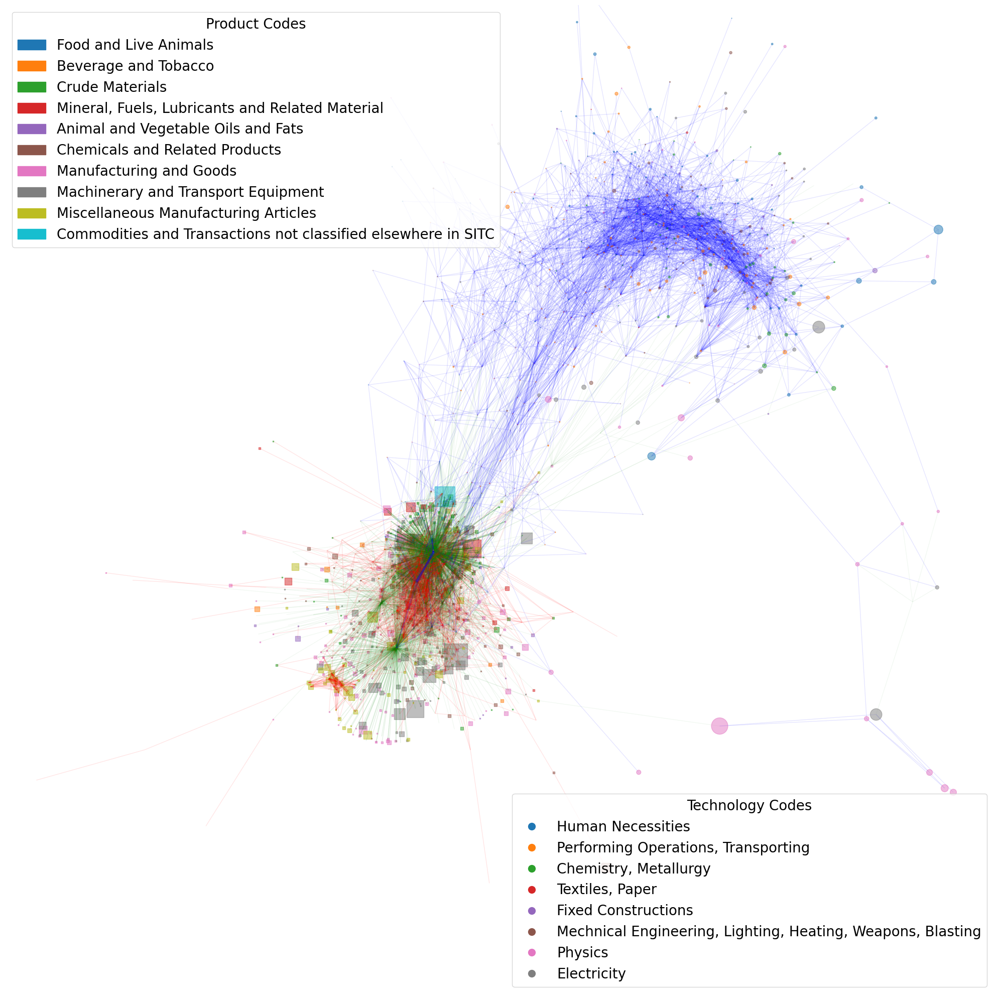

In [ ]:
pos_dict = {}
tech_space_dict = {}
product_space_dict = {}
co_space_dict = {}

for temp_year in tqdm(range(2020, 2021)):

    proximity_product_df = pd.DataFrame(proximity_product[temp_year], index = binary_rca[temp_year].columns, columns = binary_rca[temp_year].columns)
    proximity_technology_df = pd.DataFrame(proximity_technology[temp_year], index = binary_rta[temp_year].columns, columns = binary_rta[temp_year].columns)
    proximity_pro_tech_df = pd.DataFrame(Co_proximity_n[temp_year], index = binary_rca[temp_year].columns, columns = binary_rta[temp_year].columns)

    temp_products = sorted(binary_rca[temp_year].columns)
    temp_technologies = sorted(binary_rta[temp_year].columns)
    threshold = 0.5

    temp_tech_space = nx.Graph()
    temp_product_space = nx.Graph()
    temp_co_space = nx.Graph()

    for i in temp_products:
        temp_product_space.add_node(i)
        for j in temp_products:
            if i == j:
                continue
            elif proximity_product_df.loc[i, j]>=threshold:
                temp_product_space.add_edge(i, j, weight = proximity_product_df.loc[i, j])

    for i in temp_technologies:
        temp_tech_space.add_node(i)
        for j in temp_technologies:
            if i == j:
                continue
            elif proximity_technology_df.loc[i, j]>=threshold:
                temp_tech_space.add_edge(i, j, weight = proximity_technology_df.loc[i, j])

    temp_G = nx.compose_all([temp_product_space, temp_tech_space])
    #pos = nx.spring_layout(temp_G, seed=42)
    #pos_dict[temp_year] = pos

    temp_co_space = nx.Graph()
    for i in temp_products:
        temp_co_space.add_node(i)
        for j in temp_technologies:
            temp_co_space.add_node(j)
            if proximity_pro_tech_df.loc[i, j]>=0.95:
                temp_co_space.add_edge(i, j, weight = proximity_pro_tech_df.loc[i, j])

    temp_G = nx.compose_all([temp_co_space,temp_G])
    #pos = nx.spectral_layout(temp_G)
    pos = nx.spring_layout(temp_G, seed=42)
    pos_dict[temp_year] = pos

    co_space_dict[temp_year] = temp_co_space
    tech_space_dict[temp_year] = temp_tech_space
    product_space_dict[temp_year] = temp_product_space

    Product_Technology_Space(temp_G, pos, temp_year, f'Product-Technology Space {temp_year}')

In [ ]:
binary_rta[temp_year].shape

(101, 658)

In [ ]:
proximity_product[temp_year]

array([[1.        , 0.55      , 0.375     , ..., 0.25      , 0.225     ,
        0.19672131],
       [0.55      , 1.        , 0.16129032, ..., 0.22580645, 0.125     ,
        0.19672131],
       [0.375     , 0.16129032, 1.        , ..., 0.29166667, 0.125     ,
        0.04918033],
       ...,
       [0.25      , 0.22580645, 0.29166667, ..., 1.        , 0.25      ,
        0.08196721],
       [0.225     , 0.125     , 0.125     , ..., 0.25      , 1.        ,
        0.13114754],
       [0.19672131, 0.19672131, 0.04918033, ..., 0.08196721, 0.13114754,
        1.        ]])

In [ ]:
for temp_year in tqdm(range(start_year, end_year+1)):
    np.fill_diagonal(proximity_product[temp_year], 0)
    np.fill_diagonal(proximity_technology[temp_year], 0)

100%|██████████| 45/45 [00:00<00:00, 3226.33it/s]


In [ ]:
proximity_product[temp_year]

array([[0.        , 0.55      , 0.375     , ..., 0.25      , 0.225     ,
        0.19672131],
       [0.55      , 0.        , 0.16129032, ..., 0.22580645, 0.125     ,
        0.19672131],
       [0.375     , 0.16129032, 0.        , ..., 0.29166667, 0.125     ,
        0.04918033],
       ...,
       [0.25      , 0.22580645, 0.29166667, ..., 0.        , 0.25      ,
        0.08196721],
       [0.225     , 0.125     , 0.125     , ..., 0.25      , 0.        ,
        0.13114754],
       [0.19672131, 0.19672131, 0.04918033, ..., 0.08196721, 0.13114754,
        0.        ]])

In [ ]:
proximity_product[temp_year]

array([[0.        , 0.55      , 0.375     , ..., 0.25      , 0.225     ,
        0.19672131],
       [0.55      , 0.        , 0.16129032, ..., 0.22580645, 0.125     ,
        0.19672131],
       [0.375     , 0.16129032, 0.        , ..., 0.29166667, 0.125     ,
        0.04918033],
       ...,
       [0.25      , 0.22580645, 0.29166667, ..., 0.        , 0.25      ,
        0.08196721],
       [0.225     , 0.125     , 0.125     , ..., 0.25      , 0.        ,
        0.13114754],
       [0.19672131, 0.19672131, 0.04918033, ..., 0.08196721, 0.13114754,
        0.        ]])

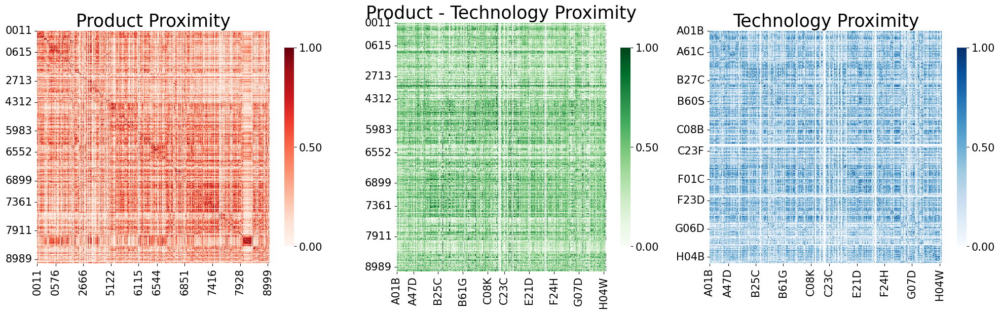

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
import pandas as pd
import numpy as np

# Min-Max Scaling function definition
def min_max_scale(df):
    scaler = MinMaxScaler()
    scaled_values = scaler.fit_transform(df.values)
    return pd.DataFrame(scaled_values, index=df.index, columns=df.columns)

# Min-Max Scaling applied
scaled_proximity_product = min_max_scale(pd.DataFrame(proximity_product[temp_year],
                                                      index=binary_rca[temp_year].columns,
                                                      columns=binary_rca[temp_year].columns))
scaled_co_proximity = min_max_scale(Co_proximity_n[temp_year])
scaled_proximity_technology = min_max_scale(pd.DataFrame(proximity_technology[temp_year],
                                                         index=binary_rta[temp_year].columns,
                                                         columns=binary_rta[temp_year].columns))

# Set up the figure and axes for 1x3 layout
fig, axes = plt.subplots(1, 3, figsize=(20, 6))

# Common font size for ticks
tick_fontsize = 15

# Function to reduce the number of ticks
def reduce_ticks(ax, num_ticks):
    x_ticks = np.linspace(0, len(ax.get_xticks()) - 1, num_ticks).astype(int)
    y_ticks = np.linspace(0, len(ax.get_yticks()) - 1, num_ticks).astype(int)
    ax.set_xticks(ax.get_xticks()[x_ticks])
    ax.set_yticks(ax.get_yticks()[y_ticks])

# Heatmap 1: Proximity Product
heatmap1 = sns.heatmap(
    scaled_proximity_product,
    ax=axes[0],
    cmap='Reds',
    cbar=True,
    square=True,
    vmin=0, vmax=1,  # Min-Max Scaled range
    cbar_kws={'shrink': 0.8, 'format': '%.2f', 'ticks': [0, 0.5, 1]}
)
axes[0].set_title("Product Proximity", fontsize=25)
axes[0].tick_params(axis='x', labelsize=tick_fontsize)
axes[0].tick_params(axis='y', labelsize=tick_fontsize)
reduce_ticks(axes[0], 10)  # Reduce ticks to 5 on both axes
heatmap1.figure.axes[-1].tick_params(labelsize=tick_fontsize)  # Adjust color bar tick font size

# Heatmap 2: Co_proximity_n[temp_year]
heatmap2 = sns.heatmap(
    scaled_co_proximity,
    ax=axes[1],
    cmap='Greens',
    cbar=True,
    square=True,
    vmin=0, vmax=1,  # Min-Max Scaled range
    cbar_kws={'shrink': 0.8, 'format': '%.2f', 'ticks': [0, 0.5, 1]}
)
axes[1].set_title("Product - Technology Proximity", fontsize=25)
axes[1].tick_params(axis='x', labelsize=tick_fontsize)
axes[1].tick_params(axis='y', labelsize=tick_fontsize)
reduce_ticks(axes[1], 10)  # Reduce ticks to 5 on both axes
heatmap2.figure.axes[-1].tick_params(labelsize=tick_fontsize)  # Adjust color bar tick font size

# Heatmap 3: Proximity Technology
heatmap3 = sns.heatmap(
    scaled_proximity_technology,
    ax=axes[2],
    cmap='Blues',
    cbar=True,
    square=True,
    vmin=0, vmax=1,  # Min-Max Scaled range
    cbar_kws={'shrink': 0.8, 'format': '%.2f', 'ticks': [0, 0.5, 1]}
)
axes[2].set_title("Technology Proximity", fontsize=25)
axes[2].tick_params(axis='x', labelsize=tick_fontsize)
axes[2].tick_params(axis='y', labelsize=tick_fontsize)
reduce_ticks(axes[2], 10)  # Reduce ticks to 5 on both axes
heatmap3.figure.axes[-1].tick_params(labelsize=tick_fontsize)  # Adjust color bar tick font size

#axes[0].text(-0.1, 1.05, "A", transform=axes[0].transAxes, fontsize=20, fontweight='bold', va='top', ha='right')
#axes[1].text(-0.1, 1.05, "B", transform=axes[1].transAxes, fontsize=20, fontweight='bold', va='top', ha='right')
#axes[2].text(-0.1, 1.05, "C", transform=axes[2].transAxes, fontsize=20, fontweight='bold', va='top', ha='right')

# Adjust layout for better spacing
plt.tight_layout()

# Define the output path if not defined
output_path = "./output"  # Replace with your desired directory
plt.savefig(f"{output_path}/Scaled_Proximity_Matrix_2020.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()



In [ ]:
np.average(proximity_product[temp_year]), np.average(proximity_technology[temp_year])

(np.float64(0.15432891200415016), np.float64(0.18740134311488155))

<Axes: xlabel='Year', ylabel='Product Proximity'>

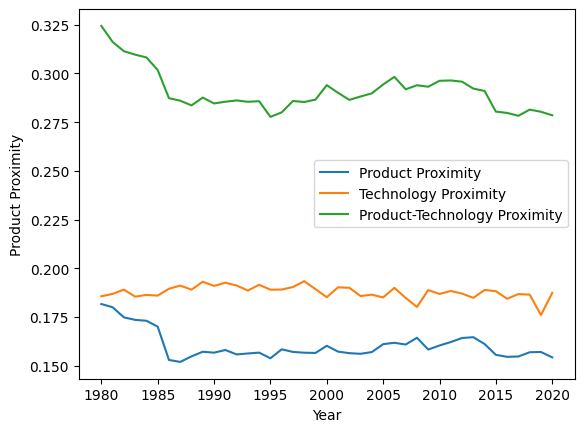

In [ ]:
plot_df = pd.DataFrame()

temp_result_list = []
for year in range(1980,2021):
    temp_list = []
    temp_list.append(year)
    temp_list.append(np.average(proximity_product[year]))
    temp_list.append(np.average(proximity_technology[year]))
    temp_list.append(np.average(Co_proximity_n[year]))
    temp_result_list.append(temp_list)

plot_df = pd.DataFrame(temp_result_list, columns = ['Year', 'Product Proximity', 'Technology Proximity', 'Product-Technology Proximity'])
sns.lineplot(data = plot_df, x = 'Year', y = 'Product Proximity', label = 'Product Proximity')
sns.lineplot(data = plot_df, x = 'Year', y = 'Technology Proximity', label = 'Technology Proximity')
sns.lineplot(data = plot_df, x = 'Year', y = 'Product-Technology Proximity', label = 'Product-Technology Proximity')



In [ ]:
import networkx as nx
import matplotlib.pyplot as plt


def Product_Technology_Space_with_highlight(temp_G, pos, temp_year, temp_title, temp_targets):
    """
    Visualize the Product-Technology Space with highlights.

    Parameters:
        temp_G (Graph): A filtered graph containing product and technology nodes.
        pos (dict): Node positions for visualization.
        temp_year (int): The year to filter relevant data.
        temp_title (str): Title for the output plot.
        temp_targets (list): List of nodes to highlight.
    """
    # Create figure
    fig, ax = plt.subplots(figsize=(20, 20))

    # Classify nodes
    product_nodes = [node for node in temp_G.nodes if node in binary_rca[temp_year].columns]
    technology_nodes = [node for node in temp_G.nodes if node in binary_rta[temp_year].columns]

    # Data preparation for scaling product nodes
    temp_countries = [country for country in country_list if country.year == temp_year]
    product_values = [country.export_dict[sitc] for country in temp_countries for sitc in country.export_dict.keys()]
    product_max = max(product_values)
    product_min = min(product_values)

    # Draw Product nodes
    for node in product_nodes:
        size = sum(
            300 * (country.export_dict.get(node, 0) - product_min) / (product_max - product_min)
            for country in temp_countries if node in country.export_dict
        )
        color = 'black' if node in temp_targets else 'gray'
        ax.scatter(pos[node][0], pos[node][1], s=size, color=color, alpha=0.8 if node in temp_targets else 0.5, marker='s')

    # Data preparation for scaling technology nodes
    tech_values = [country.ipc_dict[ipc] for country in temp_countries for ipc in country.ipc_dict.keys()]
    tech_max = max(tech_values)
    tech_min = min(tech_values)

    # Draw Technology nodes
    for node in technology_nodes:
        size = sum(
            300 * (country.ipc_dict.get(node, 0) - tech_min) / (tech_max - tech_min)
            for country in temp_countries if node in country.ipc_dict
        )
        color = 'black' if node in temp_targets else 'gray'
        nx.draw_networkx_nodes(temp_G, pos, nodelist=[node], node_size=[size], node_color=color, alpha=0.8 if node in temp_targets else 0.5, ax=ax)

    # Draw edges with weights categorized by thresholds
    #edge_list_low = [(u, v) for u, v, d in temp_G.edges(data=True) if 0.5 <= d['weight'] < 0.6]
    #edge_list_mid = [(u, v) for u, v, d in temp_G.edges(data=True) if 0.6 <= d['weight'] < 0.8]
    #edge_list_high = [(u, v) for u, v, d in temp_G.edges(data=True) if d['weight'] >= 0.8]

    #nx.draw_networkx_edges(temp_G, pos, edgelist=edge_list_low, edge_color="grey", alpha=0.3, ax=ax)
    #nx.draw_networkx_edges(temp_G, pos, edgelist=edge_list_mid, edge_color="blue", alpha=0.3, ax=ax)
    #nx.draw_networkx_edges(temp_G, pos, edgelist=edge_list_high, edge_color="red", alpha=0.3, ax=ax)
    edge_list_product = [(u, v) for u, v, d in temp_G.edges(data=True) if u in product_nodes and v in product_nodes]
    edge_list_technology = [(u, v) for u, v, d in temp_G.edges(data=True) if u in technology_nodes and v in technology_nodes]
    edge_list_pro_tech = [(u, v) for u, v, d in temp_G.edges(data=True) if u in product_nodes and v in technology_nodes]
    edge_list_pro_tech += [(u, v) for u, v, d in temp_G.edges(data=True) if v in product_nodes and u in technology_nodes]

    nx.draw_networkx_edges(temp_G, pos, edgelist=edge_list_pro_tech, edge_color="green", alpha=0.05, ax=ax)
    nx.draw_networkx_edges(temp_G, pos, edgelist=edge_list_product, edge_color="red", alpha=0.05, ax=ax)
    nx.draw_networkx_edges(temp_G, pos, edgelist=edge_list_technology, edge_color="blue", alpha=0.05, ax=ax)

    # Set plot boundaries
    ax.set_xlim(min(pos[x][0] for x in pos.keys())*0.2, max(pos[x][0] for x in pos.keys())*0.2)
    ax.set_ylim(min(pos[x][1] for x in pos.keys())*0.2, max(pos[x][1] for x in pos.keys())*0.2)

    # Hide axis
    plt.axis('off')

    # Save the figure
    plt.tight_layout()
    plt.savefig(f"{output_path}/{temp_title}_with_highlight.jpg", dpi=300, transparent=True, bbox_inches="tight")
    #plt.close(fig)


In [ ]:
year = 2020

temp_pos = pos_dict[year]
temp_country = [country for country in country_list if country.year == year if country.name == 'KOR'][0]
points = [sitc for sitc in temp_country.rca_dict.keys() if temp_country.rca_dict[sitc] >= 1]
points += [ipc for ipc in temp_country.rta_dict.keys() if temp_country.rta_dict[ipc] >= 1]
temp_title = f"Product-Technology Space KOR {year}"
#Product_Technology_Space_with_highlight(temp_G, temp_pos, year, temp_title, points)

temp_pos = pos_dict[year]
temp_country = [country for country in country_list if country.year == year if country.name == 'VNM'][0]
points = [sitc for sitc in temp_country.rca_dict.keys() if temp_country.rca_dict[sitc] >= 1]
points += [ipc for ipc in temp_country.rta_dict.keys() if temp_country.rta_dict[ipc] >= 1]
temp_title = f"Product-Technology Space VNM {year}"
#Product_Technology_Space_with_highlight(temp_G, temp_pos, year, temp_title, points)

In [ ]:
for year in range(2020, 2021):
    temp_pos = pos_dict[year]
    temp_country = [country for country in country_list if country.year == year if country.name == 'KOR'][0]
    points = [sitc for sitc in temp_country.rca_dict.keys() if temp_country.rca_dict[sitc] >= 1]
    points += [ipc for ipc in temp_country.rta_dict.keys() if temp_country.rta_dict[ipc] >= 1]
    temp_title = f"Product-Technology Space KOR {year}"
    #Product_Technology_Space_with_highlight(temp_G, temp_pos, year, temp_title, points)

for year in range(2020, 2021):
    temp_pos = pos_dict[year]
    temp_country = [country for country in country_list if country.year == year if country.name == 'VNM'][0]
    points = [sitc for sitc in temp_country.rca_dict.keys() if temp_country.rca_dict[sitc] >= 1]
    points += [ipc for ipc in temp_country.rta_dict.keys() if temp_country.rta_dict[ipc] >= 1]
    temp_title = f"Product-Technology Space VNM {year}"
    #Product_Technology_Space_with_highlight(temp_G, temp_pos, year, temp_title, points)

Scale Property

In [ ]:
pos_dict = {}
tech_space_dict_w = {}
product_space_dict_w = {}
co_space_dict_w = {}

for temp_year in tqdm(range(1980, 2021)):

    proximity_product_df = pd.DataFrame(proximity_product[temp_year], index = binary_rca[temp_year].columns, columns = binary_rca[temp_year].columns)
    proximity_technology_df = pd.DataFrame(proximity_technology[temp_year], index = binary_rta[temp_year].columns, columns = binary_rta[temp_year].columns)
    proximity_pro_tech_df = pd.DataFrame(Co_proximity_n[temp_year], index = binary_rca[temp_year].columns, columns = binary_rta[temp_year].columns)

    temp_products = sorted(binary_rca[temp_year].columns)
    temp_technologies = sorted(binary_rta[temp_year].columns)

    temp_tech_space = nx.Graph()
    temp_product_space = nx.Graph()
    temp_co_space = nx.Graph()

    for i in temp_products:
        temp_product_space.add_node(i)
        for j in temp_products:
            if i == j:
                continue
            temp_product_space.add_edge(i, j, weight = proximity_product_df.loc[i, j])

    for i in temp_technologies:
        temp_tech_space.add_node(i)
        for j in temp_technologies:
            if i == j:
                continue
            temp_tech_space.add_edge(i, j, weight = proximity_technology_df.loc[i, j])

    temp_G = nx.compose_all([temp_product_space, temp_tech_space])
    #pos = nx.spring_layout(temp_G, seed=42)
    #pos_dict[temp_year] = pos

    temp_co_space = nx.Graph()
    for i in temp_products:
        temp_co_space.add_node(i)
        for j in temp_technologies:
            temp_co_space.add_node(j)
            temp_co_space.add_edge(i, j, weight = proximity_pro_tech_df.loc[i, j])

    co_space_dict_w[temp_year] = temp_co_space
    tech_space_dict_w[temp_year] = temp_tech_space
    product_space_dict_w[temp_year] = temp_product_space

100%|██████████| 41/41 [06:51<00:00, 10.03s/it]


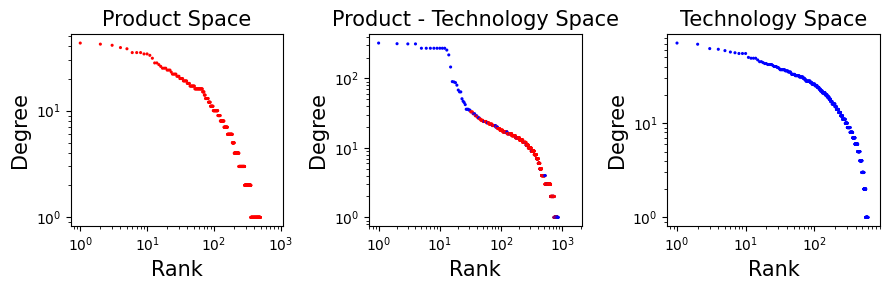

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# 데이터 준비 함수
def prepare_data(graph, color, binary_columns=None):
    degree_dict = dict(graph.degree())
    raw_data = pd.DataFrame()
    raw_data['Node'] = degree_dict.keys()
    raw_data['Degree'] = degree_dict.values()
    if binary_columns is not None:
        raw_data['Type'] = ['Product' if node in binary_columns else 'Technology' for node in degree_dict.keys()]
        raw_data['Colors'] = ['red' if node in binary_columns else 'blue' for node in degree_dict.keys()]
    else:
        raw_data['Colors'] = [color for _ in degree_dict.keys()]
    raw_data = raw_data.sort_values(by='Degree', ascending=False)
    return raw_data

# 그래프 및 데이터 정의
year = 2020
product_data = prepare_data(product_space_dict[year], 'red')
co_space_data = prepare_data(co_space_dict[year], None, binary_rca[year].columns)
tech_data = prepare_data(tech_space_dict[year], 'blue')

# 1x3 서브플롯 생성
fig, axes = plt.subplots(1, 3, figsize=(9, 3))

# Plot 1: Product Space
axes[0].scatter(
    np.arange(1, len(product_data) + 1),
    product_data['Degree'],
    color=product_data['Colors'],
    s=1.5
)
axes[0].set_xscale('log')
axes[0].set_yscale('log')
axes[0].set_xlabel("Rank",fontsize = 15)
axes[0].set_ylabel("Degree",fontsize = 15)
axes[0].set_title("Product Space",fontsize = 15)
axes[0].grid(False)

# Plot 2: Co-Space
axes[1].scatter(
    np.arange(1, len(co_space_data) + 1),
    co_space_data['Degree'],
    color=co_space_data['Colors'],
    s=1.5
)
axes[1].set_xscale('log')
axes[1].set_yscale('log')
axes[1].set_xlabel("Rank",fontsize = 15)
axes[1].set_ylabel("Degree",fontsize = 15)
axes[1].set_title("Product - Technology Space",fontsize = 15)
axes[1].grid(False)

# Plot 3: Tech Space
axes[2].scatter(
    np.arange(1, len(tech_data) + 1),
    tech_data['Degree'],
    color=tech_data['Colors'],
    s=1.5
)
axes[2].set_xscale('log')
axes[2].set_yscale('log')
axes[2].set_xlabel("Rank",fontsize = 15)
axes[2].set_ylabel("Degree",fontsize = 15)
axes[2].set_title("Technology Space",fontsize = 15)
axes[2].grid(False)

# 전체 레이아웃 조정
plt.tight_layout()
plt.savefig(f"{output_path}/Degree_Distribution_2020.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()


# Co_evolutionary Heatmap

In [ ]:
# 클러스터 맵의 distance metric을 proximity 객체로 customizing
class PROXIMITY:
  def __init__(self,proximity_dict,codes):
    self.proximity_dict=proximity_dict
    self.codes=codes

  def metric(self,A,B):
    A=int(A[0])
    B=int(B[0])
    temp_key = (self.codes[A],self.codes[B])
    if temp_key in self.proximity_dict.keys():
      if self.proximity_dict[temp_key]:
        return 1-self.proximity_dict[temp_key]
      else:
        return 1
    else:
      temp_key = (self.codes[B], self.codes[A])
      if temp_key in self.proximity_dict.keys():
        if self.proximity_dict[temp_key]:
          return 1-self.proximity_dict[temp_key]
        else:
          return 1
      # 두 코드가 해당 시기에 존재하나 두 코드가 관계성은 없는 시기
      return 1

In [ ]:
CO_PM_list

In [ ]:
temp_g_list=[]
#color row add
for temp_year in tqdm(year_list):
    temp_Product_PM=[item for item in Product_PM_list if item.year==temp_year][0]
    temp_Technology_PM=[item for item in Technology_PM_list if item.year==temp_year][0]
    temp_CO_PM=[item for item in CO_PM_list if item.year==temp_year][0]

    temp_sitc_code=sorted(temp_Product_PM.codes)
    ipc_list=sorted(temp_Technology_PM.codes)
    #index=year_list.index(temp_year)
    Z=np.zeros(shape=(len(temp_sitc_code),len(ipc_list)))

    # Product Space Dendrogram
    X=np.array([[i] for i in range(len(temp_sitc_code))])
    temp_proximity=PROXIMITY(temp_Product_PM.proximity_dict,temp_sitc_code)
    row_linkage=linkage(X,metric=temp_proximity.metric,method='average')

    # Technology Space Dendrogram
    X=np.array([[i] for i in range(len(ipc_list))])
    temp_proximity=PROXIMITY(temp_Technology_PM.proximity_dict,ipc_list)
    col_linkage=linkage(X,metric=temp_proximity.metric,method='average')

    temp_df=pd.DataFrame()
    for i in range(len(temp_sitc_code)):
        temp_list=[]
        for j in range(len(ipc_list)):
            temp_key=(temp_sitc_code[i],ipc_list[j])
            if temp_key in temp_CO_PM.proximity_dict.keys():
                if temp_CO_PM.proximity_dict[(temp_sitc_code[i],ipc_list[j])]:
                    temp_list.append(temp_CO_PM.proximity_dict[(temp_sitc_code[i],ipc_list[j])])
                else:
                    temp_list.append(0)
            else:
                temp_list.append(0)
        temp_df=temp_df.append(pd.Series(temp_list),ignore_index=True)
    temp_df.columns=ipc_list
    temp_df.index=temp_sitc_code


    # Categories
    temp_list=[]
    for code in temp_sitc_code:
        if len(code)!=4:
            temp_list.append(sitc_code_color_dict["0"])
        else:
            temp_list.append(sitc_code_color_dict[str(code[0])])

    row_colors=pd.DataFrame()
    row_colors.index=temp_sitc_code
    row_colors["SITC Categories"]=temp_list

    temp_list=[]
    for code in ipc_list:
        temp_list.append(ipc_code_color_dict[str(code[0])])

    col_colors=pd.DataFrame()
    col_colors.index=ipc_list
    col_colors["IPC Categories"]=temp_list

    #col_colors=pd.concat([col_colors,col_colors2],axis=1)

    fig=plt.figure(figsize=(100,100))

    g=sns.clustermap(temp_df,
                    figsize=(30, 30),
                    row_linkage=row_linkage,
                    col_linkage=col_linkage,
                    cmap="viridis",
                    row_colors=row_colors,
                    col_colors=col_colors, vmin=0, vmax=1,
                    )
    temp_g_list.append(g)
    plt.title(str(temp_year),fontsize=50,loc="left",fontweight="bold",pad=50)

    temp_df.to_csv(output_path+f"/Heatmap %s_wCategories.csv"%str(temp_year),index=True)
    plt.savefig(output_path+f"/Heatmap %s_wCategories.jpg"%str(temp_year),transparent=True,bbox_inches="tight")
    plt.close(fig)
    #except:
    #    print(temp_year)
    #    temp_g_list.append(None)
    #    pass

  0%|          | 0/41 [00:00<?, ?it/s]


AttributeError: 'DataFrame' object has no attribute 'append'

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
from scipy.cluster.hierarchy import linkage
from tqdm import tqdm
import os

temp_g_list = []

# Iterate over each year in the list
for temp_year in tqdm(year_list):
    # Get proximity matrices for the current year
    temp_Product_PM = next(item for item in Product_PM_list if item.year == temp_year)
    temp_Technology_PM = next(item for item in Technology_PM_list if item.year == temp_year)
    temp_CO_PM = next(item for item in CO_PM_list if item.year == temp_year)

    temp_sitc_code = sorted(temp_Product_PM.codes)
    ipc_list = sorted(temp_Technology_PM.codes)

    # Initialize zero matrix for CO-PM proximity
    Z = np.zeros((len(temp_sitc_code), len(ipc_list)))

    # Product Space Dendrogram
    X = np.array([[i] for i in range(len(temp_sitc_code))])
    temp_proximity = PROXIMITY(temp_Product_PM.proximity_dict, temp_sitc_code)
    row_linkage = linkage(X, metric=temp_proximity.metric, method='average')

    # Technology Space Dendrogram
    X = np.array([[i] for i in range(len(ipc_list))])
    temp_proximity = PROXIMITY(temp_Technology_PM.proximity_dict, ipc_list)
    col_linkage = linkage(X, metric=temp_proximity.metric, method='average')

    # Construct DataFrame for heatmap
    temp_df = pd.DataFrame(index=temp_sitc_code, columns=ipc_list).fillna(0)

    # Populate DataFrame with proximity values
    for i, sitc_code in enumerate(temp_sitc_code):
        for j, ipc_code in enumerate(ipc_list):
            temp_key = (sitc_code, ipc_code)
            temp_df.loc[sitc_code, ipc_code] = temp_CO_PM.proximity_dict.get(temp_key, 0)

    # Categories for row and column colors
    row_colors = pd.DataFrame({
        "SITC Categories": [sitc_code_color_dict.get(str(code[0]), sitc_code_color_dict["0"]) if len(code) == 4 else sitc_code_color_dict["0"] for code in temp_sitc_code]
    }, index=temp_sitc_code)

    col_colors = pd.DataFrame({
        "IPC Categories": [ipc_code_color_dict.get(str(code[0]), 'grey') for code in ipc_list]
    }, index=ipc_list)

    # Plot the clustered heatmap
    fig = plt.figure(figsize=(100, 100))
    g = sns.clustermap(
        temp_df,
        figsize=(30, 30),
        row_linkage=row_linkage,
        col_linkage=col_linkage,
        cmap="viridis",
        row_colors=row_colors,
        col_colors=col_colors,
        vmin=0, vmax=1
    )
    temp_g_list.append(g)
    plt.title(str(temp_year), fontsize=50, loc="left", fontweight="bold", pad=50)
    plt.tight_layout()

    # Save the clustered heatmap and data
    csv_path = os.path.join(output_path, f"Heatmap_{temp_year}_wCategories.csv")
    jpg_path = os.path.join(output_path, f"Heatmap_{temp_year}_wCategories.jpg")
    pdf_path = os.path.join(output_path, f"Heatmap_{temp_year}_wCategories.pdf")
    temp_df.to_csv(csv_path, index=True)
    plt.savefig(jpg_path, transparent=True, bbox_inches="tight", dpi = 300)
    plt.savefig(pdf_path, bbox_inches="tight", dpi = 300)


    plt.close(fig)

    #except Exception as e:
    #    print(f"Error processing year {temp_year}: {e}")
    #    temp_g_list.append(None)
    #    continue


In [ ]:
from matplotlib.colors import LinearSegmentedColormap

colors = ['white','red',"blue","green"]
cmap = LinearSegmentedColormap.from_list('my_cmap',colors)

def rca_rta_Heatmap(input_country):
  temp_year=input_country.year
  index=year_list.index(temp_year)

  temp_Product_PM=[item for item in Product_PM_list if item.year==temp_year][0]
  temp_Technology_PM=[item for item in Technology_PM_list if item.year==temp_year][0]
  temp_sitc_code=sorted(temp_Product_PM.codes)
  ipc_list=sorted(temp_Technology_PM.codes)
  index=year_list.index(temp_year)
  Z=np.zeros(shape=(len(temp_sitc_code),len(ipc_list)))

  # Product Space Dendrogram
  X=np.array([[i] for i in range(len(temp_sitc_code))])
  temp_proximity=PROXIMITY(temp_Product_PM.proximity_dict,temp_sitc_code)
  row_linkage=linkage(X,metric=temp_proximity.metric,method='average')

  # Technology Space Dendrogram
  X=np.array([[i] for i in range(len(ipc_list))])
  temp_proximity=PROXIMITY(temp_Technology_PM.proximity_dict,ipc_list)
  col_linkage=linkage(X,metric=temp_proximity.metric,method='average')

  temp_df=pd.DataFrame(Z)
  temp_df.columns=ipc_list
  temp_df.index=temp_sitc_code

  for i in range(len(temp_sitc_code)):
    for j in range(len(ipc_list)):
      if (temp_sitc_code[i] in input_country.rca_dict.keys()) and (ipc_list[j] in input_country.rta_dict.keys()):
        if input_country.rca_dict[temp_sitc_code[i]]>=1 and input_country.rta_dict[ipc_list[j]]>=1:
          temp_df.loc[temp_sitc_code[i],ipc_list[j]]=1
        if input_country.rca_dict[temp_sitc_code[i]]>=1 and input_country.rta_dict[ipc_list[j]]<1:
          temp_df.loc[temp_sitc_code[i],ipc_list[j]]=0.25
        if input_country.rta_dict[ipc_list[j]]>=1 and input_country.rca_dict[temp_sitc_code[i]]<1:
          temp_df.loc[temp_sitc_code[i],ipc_list[j]]=0.75

  #fig=plt.figure(figsize=(100,100))
  temp_list=[]
  for code in temp_sitc_code:
    if code in input_country.rca_dict.keys():
      if input_country.rca_dict[code]>1:
        temp_list.append("red")
      else:
        temp_list.append("white")
    else:
      temp_list.append("white")

  row_colors=pd.DataFrame()
  row_colors.index=temp_sitc_code
  row_colors["RCA"]=temp_list

  temp_list=[]
  for code in ipc_list:
    if code in input_country.rta_dict.keys():
      if input_country.rta_dict[code]>1:
        temp_list.append("blue")
      else:
        temp_list.append("white")
    else:
      temp_list.append("white")

  col_colors=pd.DataFrame()
  col_colors.index=ipc_list
  col_colors["RTA"]=temp_list

  # Categories
  temp_list=[]
  for code in temp_sitc_code:
    if len(code)!=4:
      temp_list.append(sitc_code_color_dict["0"])
    else:
      temp_list.append(sitc_code_color_dict[str(code[0])])

  row_colors2=pd.DataFrame()
  row_colors2.index=temp_sitc_code
  row_colors2["SITC Categories"]=temp_list
  row_colors=pd.concat([row_colors2,row_colors],axis=1)

  temp_list=[]
  for code in ipc_list:
    temp_list.append(ipc_code_color_dict[str(code[0])])

  col_colors2=pd.DataFrame()
  col_colors2.index=ipc_list
  col_colors2["IPC Categories"]=temp_list
  col_colors=pd.concat([col_colors2,col_colors],axis=1)

  g=sns.clustermap(temp_df,
                figsize=(30, 30),
                row_linkage=row_linkage,
                col_linkage=col_linkage,
                cmap=cmap,
                row_colors=row_colors,
                col_colors=col_colors, vmin=0, vmax=1
                )

  plt.title(str(temp_year)+"_"+input_country.name,fontsize=50,loc="left",fontweight="bold",pad=50)
  temp_df.to_csv(output_path+f"/%s_%s_Heatmap rca_rta.csv"%(str(temp_year),input_country.name),index=True)
  plt.savefig(output_path+f"/%s_%s_Heatmap rca_rta.jpg"%(str(temp_year),input_country.name),transparent=True,bbox_inches="tight")
  plt.close(fig)

100%|██████████| 45/45 [05:00<00:00,  6.68s/it]


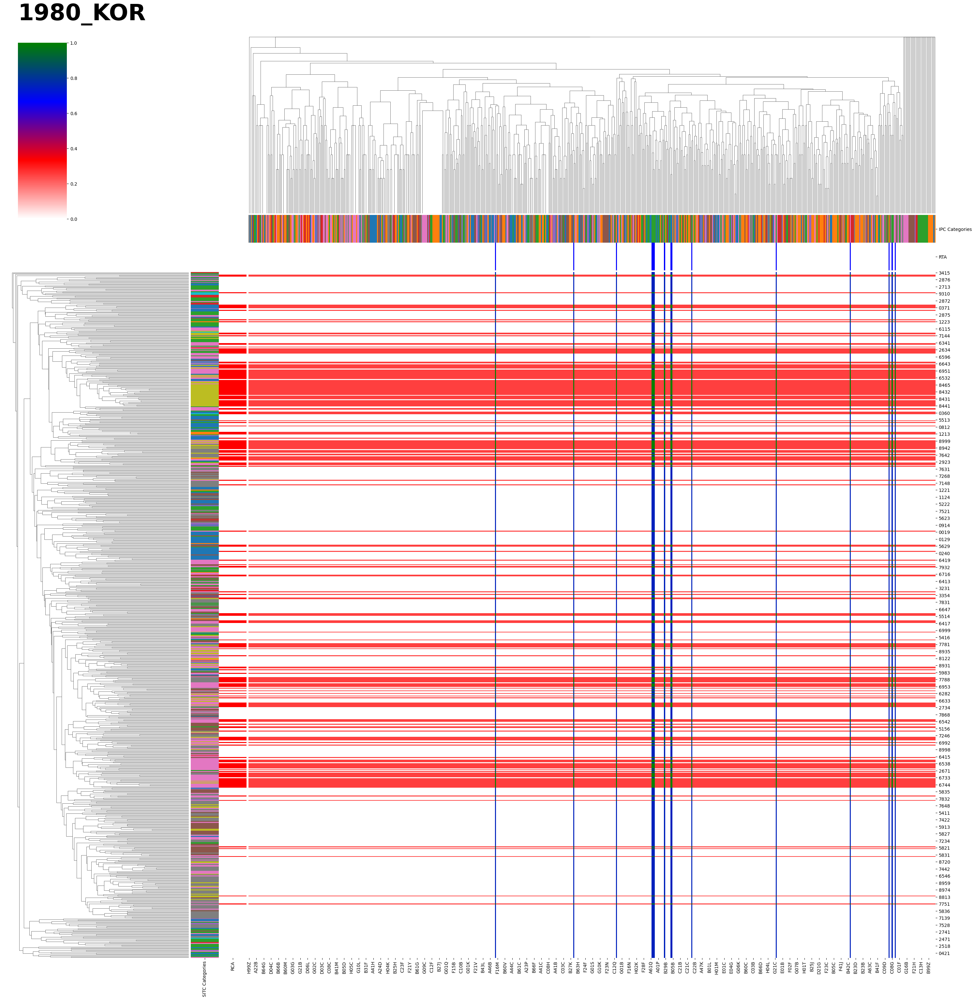

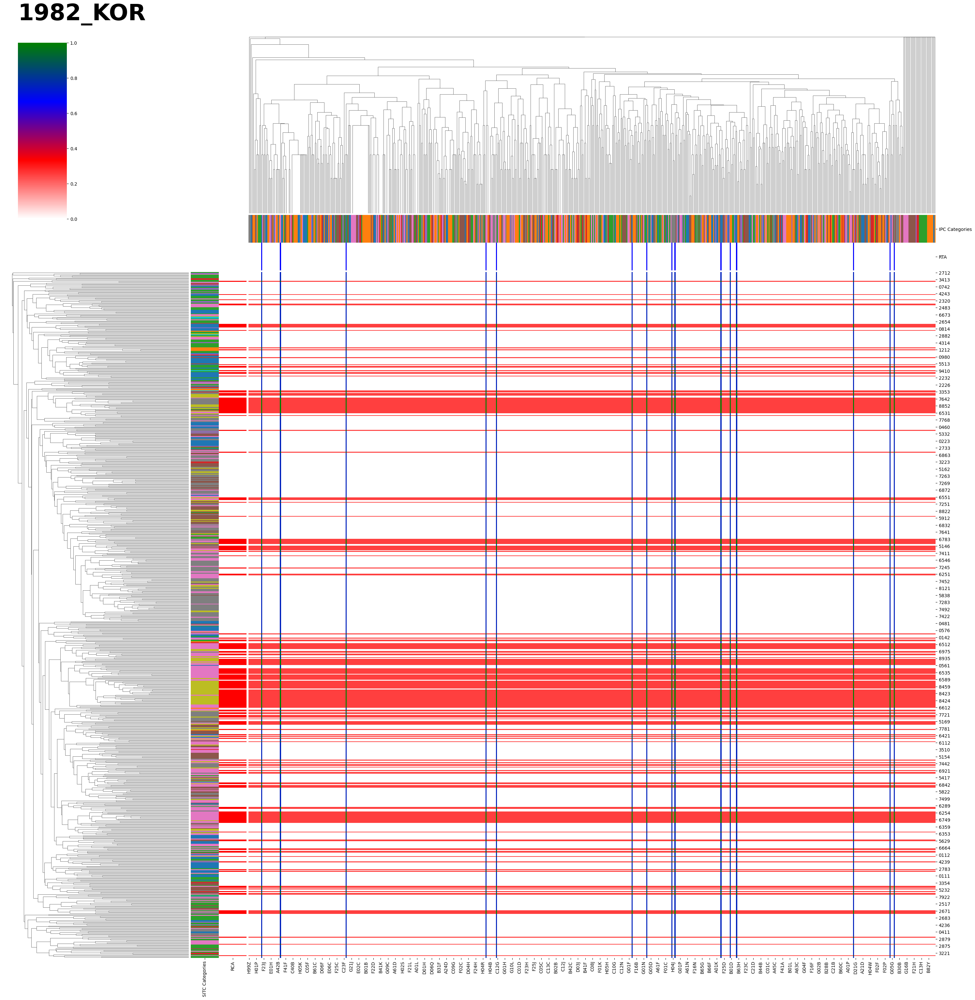

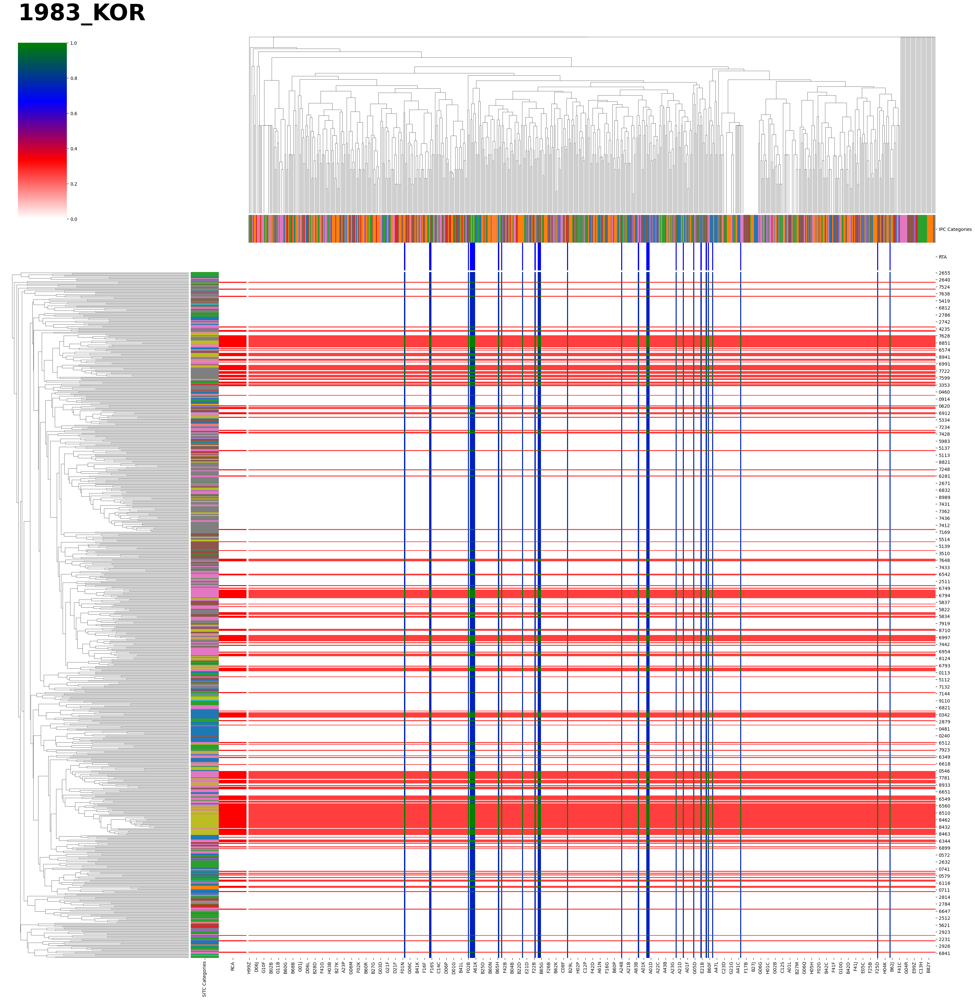

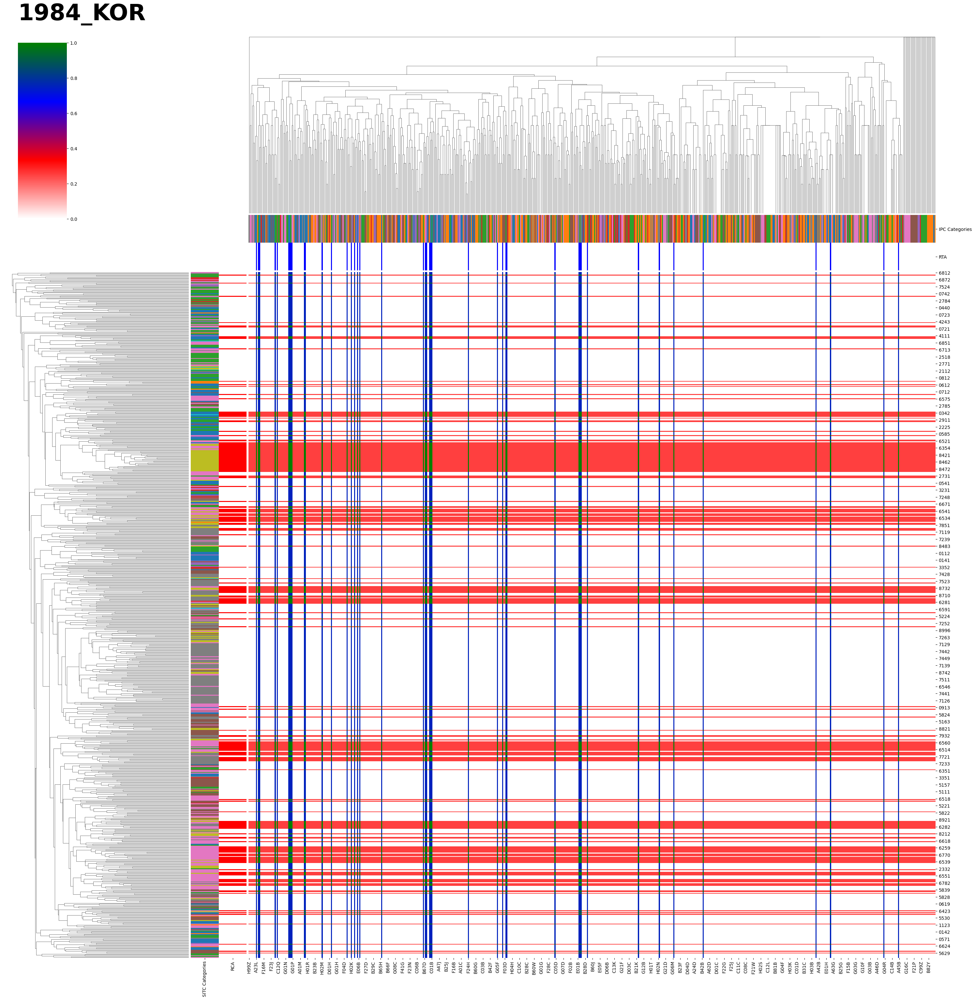

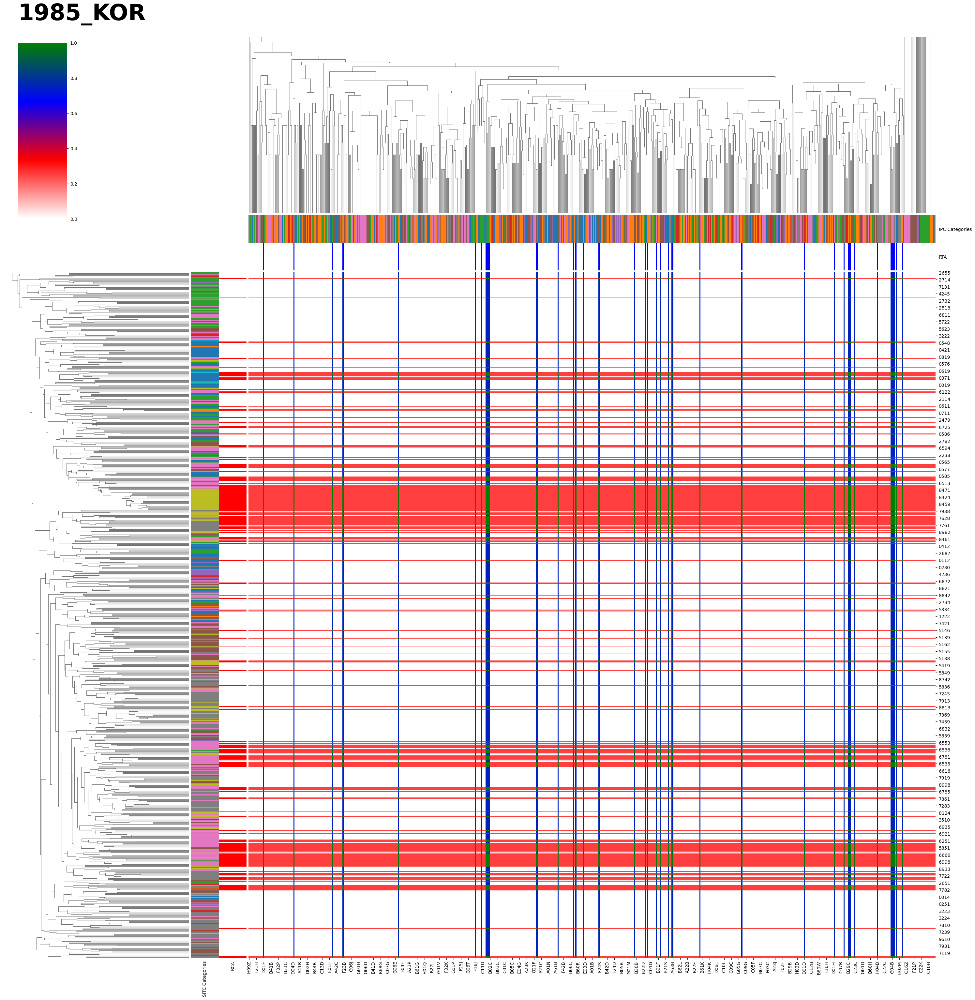

...

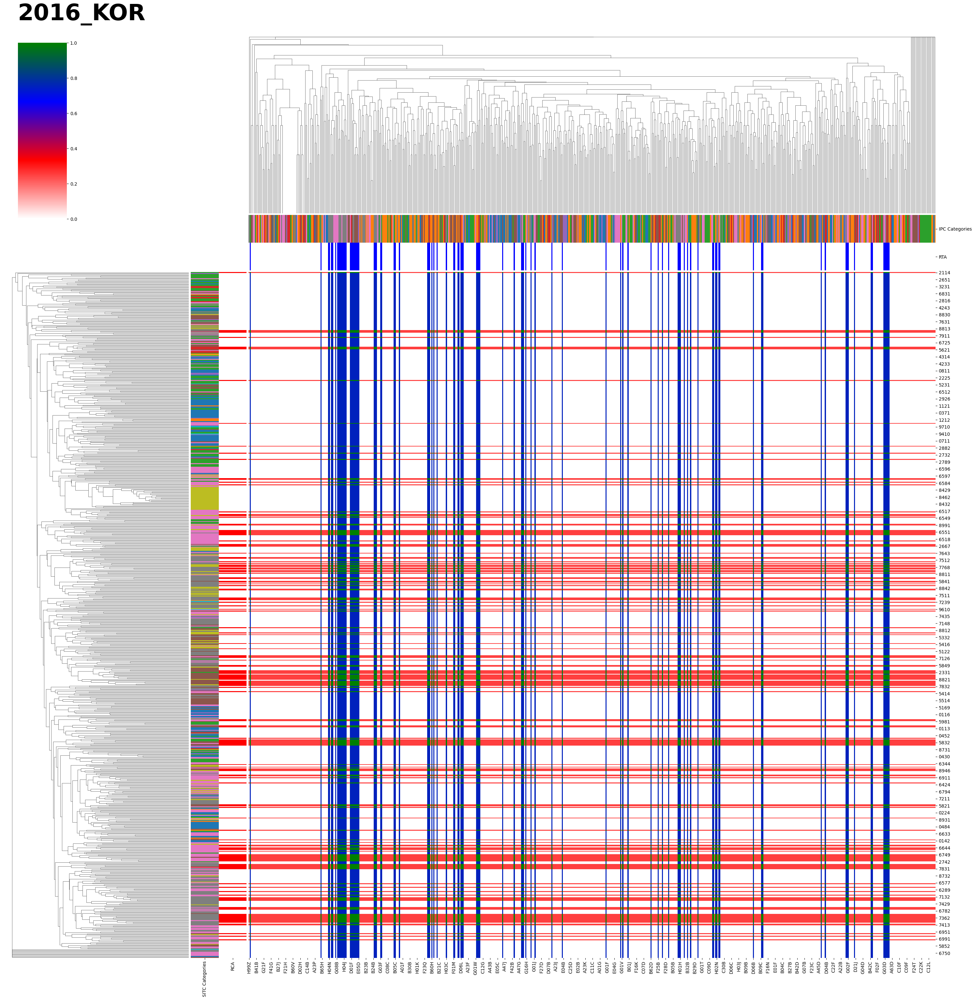

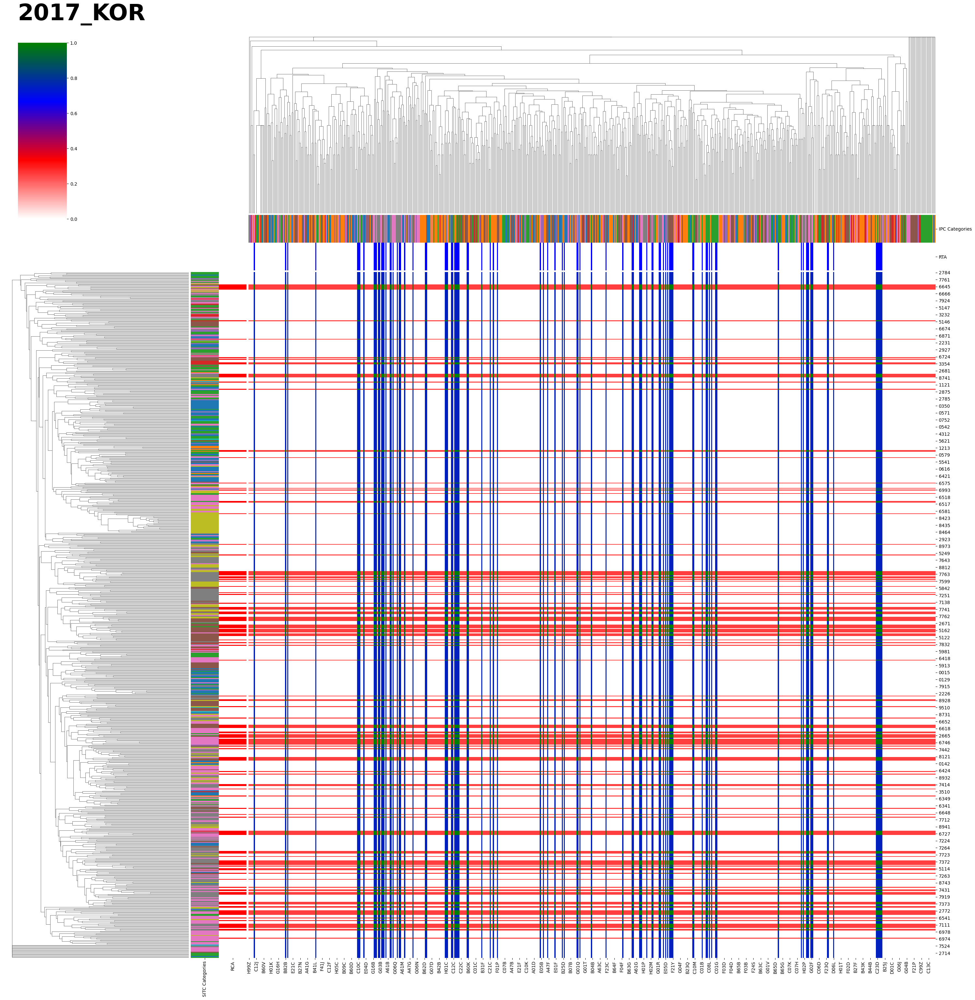

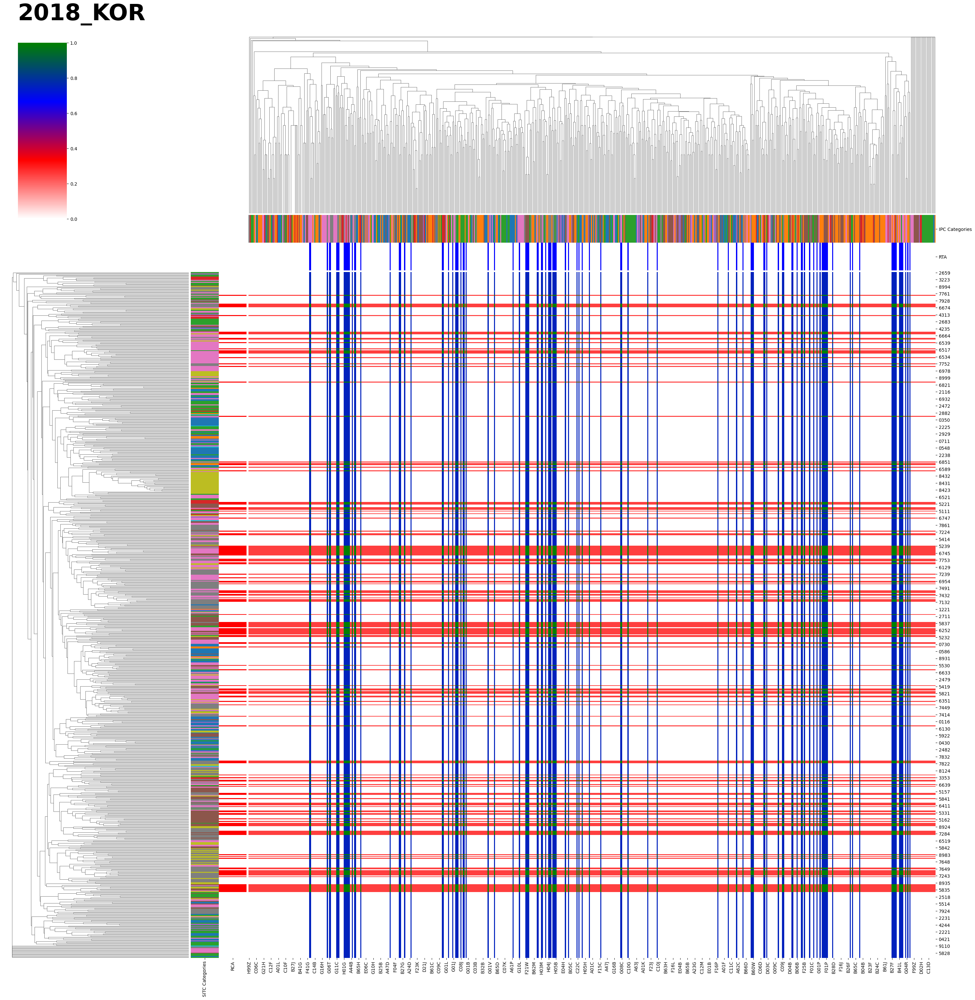

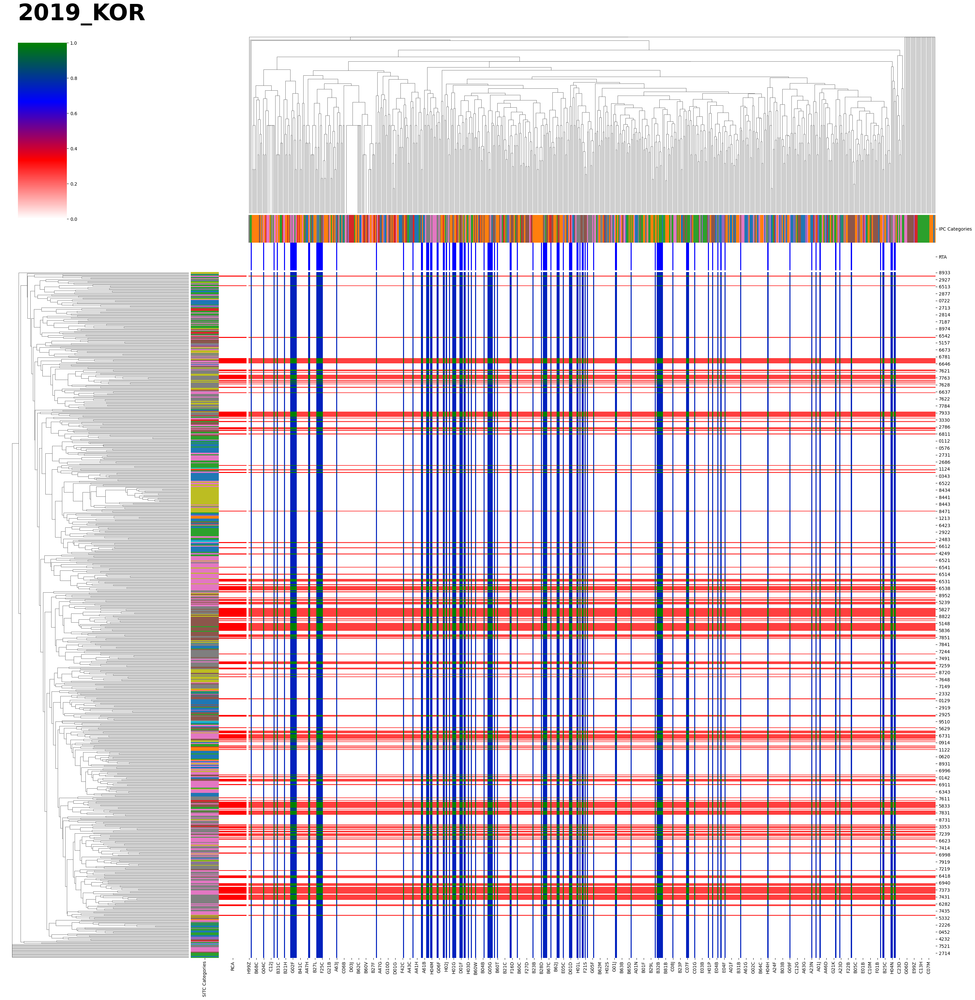

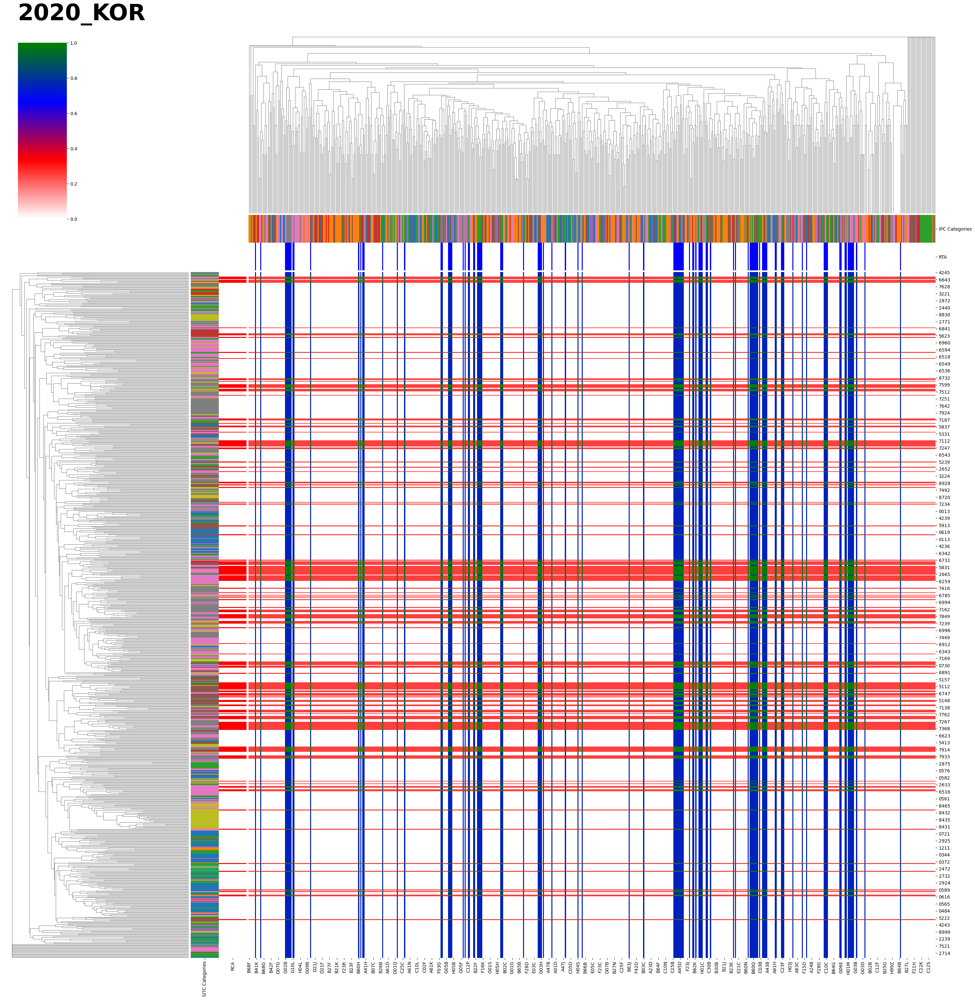

In [ ]:
temp_countries=[country for country in country_list if country.name=='KOR']
for temp_country in tqdm(temp_countries):
    try:
        rca_rta_Heatmap(temp_country)
    except:
        pass

In [ ]:
temp_countries=[country for country in country_list if country.name=='VNM']
for temp_country in tqdm(temp_countries):
    try:
        rca_rta_Heatmap(temp_country)
    except:
        pass

# Complexity

In [ ]:
temp_countries = [country for country in country_list if country.year == 2020]

temp_result_list = []
for temp_country in country_list:
    if temp_country.GDP_per_capita:
        temp_list = []
        temp_list.append(temp_country.name)
        temp_list.append(temp_country.year)
        temp_list.append(np.log10(temp_country.GDP_per_capita))
        temp_list.append(temp_country.eci)
        temp_list.append(binary_rca[temp_country.year].loc[temp_country.name].sum())
        temp_list.append(np.sum(binary_rca[temp_country.year].loc[temp_country.name]*pci[temp_country.year])/np.sum(binary_rca[temp_country.year].loc[temp_country.name]))

        temp_df = binary_rca[temp_country.year]*Relative_pci[temp_country.year]
        temp_list.append(np.sum(temp_df.loc[temp_country.name])/np.sum(binary_rca[temp_country.year].loc[temp_country.name]))

        temp_list.append(np.sum(temp_df.loc[temp_country.name]))

        temp_result_list.append(temp_list)

plot_df = pd.DataFrame(temp_result_list, columns = ['Country', 'Year', 'GDP per Capita', 'ECI', 'Number of RCA', 'Mean PCI','Mean Relative PCI', 'Sum Relative PCI'])

In [ ]:
plot_df_KOR = plot_df[plot_df['Country']=='KOR']
plot_df_KOR

,Country,Year,GDP per Capita,ECI,Number of RCA,Mean PCI,Mean Relative PCI,Sum Relative PCI
44,KOR,1990,3.971526,0.965942,187,-0.044013,-0.053753,-10.051773
135,KOR,1991,4.011681,0.962900,181,-0.079053,-0.096370,-17.442954
226,KOR,1992,4.033287,0.980402,187,-0.051994,-0.063742,-11.919826
317,KOR,1993,4.057762,1.024330,195,-0.028786,-0.036156,-7.050345
408,KOR,1994,4.091888,1.113385,195,-0.031155,-0.039202,-7.644345
499,KOR,1995,4.127386,1.086266,167,-0.006460,-0.007867,-1.313732
590,KOR,1996,4.156232,1.192989,163,0.067429,0.081889,13.347923
681,KOR,1997,4.178164,1.148996,160,0.127545,0.154909,24.785401
772,KOR,1998,4.152160,1.116867,163,0.063357,0.077311,12.601745
863,KOR,1999,4.196219,1.142844,157,0.085426,0.103511,16.251170


In [ ]:
plot_df

,Country,Year,GDP per Capita,ECI,Number of RCA,Mean PCI,Mean Relative PCI,Sum Relative PCI
0,GEO,1990,3.549758,0.484492,0,NaN,NaN,0.000000
1,SVK,1990,NaN,0.484492,0,NaN,NaN,0.000000
2,KAZ,1990,3.765749,0.484492,0,NaN,NaN,0.000000
3,NZL,1990,4.421588,0.196807,127,-0.479411,-0.565058,-71.762376
4,MLT,1990,4.003213,0.829895,88,-0.121027,-0.132106,-11.625299
...,...,...,...,...,...,...,...,...
2816,GTM,2020,3.615392,-0.120196,148,-0.601065,-0.750707,-111.104633
2817,EST,2020,4.303587,0.890334,235,0.066538,0.090195,21.195905
2818,NGA,2020,3.380425,-1.827315,31,-1.728869,-1.905528,-59.071358
2819,NOR,2020,4.875161,0.584835,110,-0.135289,-0.154092,-16.950104


posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


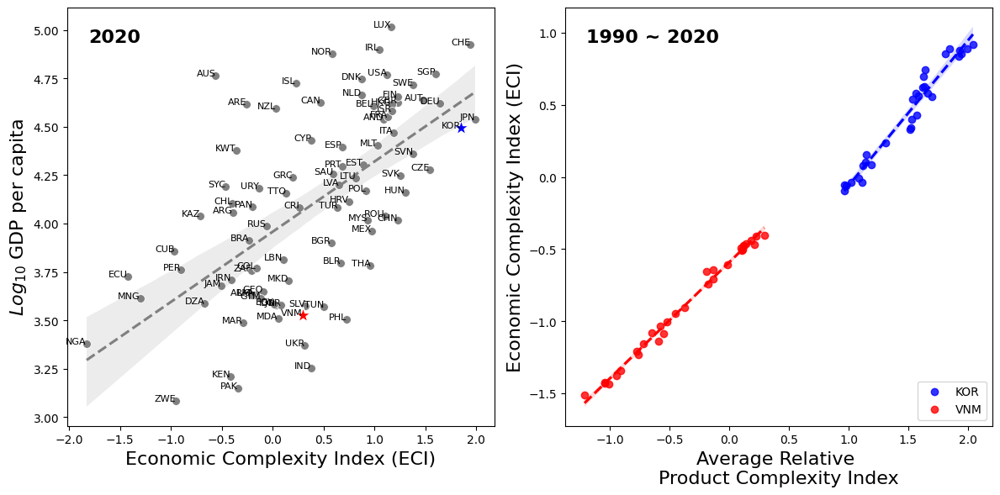

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a 1x2 panel for 2020 and 2020 data
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

temp_plot_df_2020 = plot_df[plot_df['Year'] == 2020]

# Panel 1: Plot for 2020
sns.regplot(data=temp_plot_df_2020, x='ECI', y='GDP per Capita', scatter=False, color='grey', line_kws={"linestyle": "dashed"}, ax=axes[0])
sns.scatterplot(data=temp_plot_df_2020, x='ECI', y='GDP per Capita', s=50, ax=axes[0], color = 'grey')

# Highlight VNM and KOR

highlight_countries = ['KOR']
highlight_df_2020 = temp_plot_df_2020[temp_plot_df_2020['Country'].isin(highlight_countries)]
sns.scatterplot(data=highlight_df_2020, x='ECI', y='GDP per Capita', marker='*', s=200, color='blue', ax=axes[0])

highlight_countries = ['VNM']
highlight_df_2020 = temp_plot_df_2020[temp_plot_df_2020['Country'].isin(highlight_countries)]
sns.scatterplot(data=highlight_df_2020, x='ECI', y='GDP per Capita', marker='*', s=200, color='red', ax=axes[0])

# Add text labels for each country
for i, row in temp_plot_df_2020.iterrows():
    axes[0].text(row['ECI'], row['GDP per Capita'], row['Country'], fontsize=8, ha='right')

# Add the year label
axes[0].text(0.05, 0.95, '2020', transform=axes[0].transAxes, fontsize=16, fontweight='bold', va='top', ha='left')

# Customize 2020 plot
axes[0].set_xlabel('Economic Complexity Index (ECI)', fontsize=16)
axes[0].set_ylabel('$Log_{10}$ GDP per capita', fontsize=16)

# Panel 2: ECI vs Mean Relative PCI for 2020
plot_df_KOR = plot_df[plot_df['Country']=='KOR']
sns.regplot(
    data=plot_df_KOR, x='ECI', y='Mean Relative PCI',
    scatter=True, color='blue', line_kws={"linestyle": "dashed"}, ax=axes[1], label='KOR'
)

plot_df_VNM = plot_df[plot_df['Country']=='VNM']
sns.regplot(
    data=plot_df_VNM, x='ECI', y='Mean Relative PCI',
    scatter=True, color='red', line_kws={"linestyle": "dashed"}, ax=axes[1], label='VNM'
)
axes[1].legend()
axes[1].set_xlabel('Average Relative \nProduct Complexity Index', fontsize=16)
axes[1].set_ylabel('Economic Complexity Index (ECI)', fontsize=16)
axes[1].text(
    0.05, 0.95, '1990 ~ 2020', fontsize=16, fontweight='bold',
    va='top', ha='left', transform=axes[1].transAxes
)


# Adjust layout
plt.tight_layout()
plt.savefig(f"{output_path}/ECI_vs_GDP_per_Capita_2020_ECI_Mean PCI.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()




Looks like you are using a tranform that doesn't support FancyArrowPatch, using ax.annotate instead. The arrows might strike through texts. Increasing shrinkA in arrowprops might help.


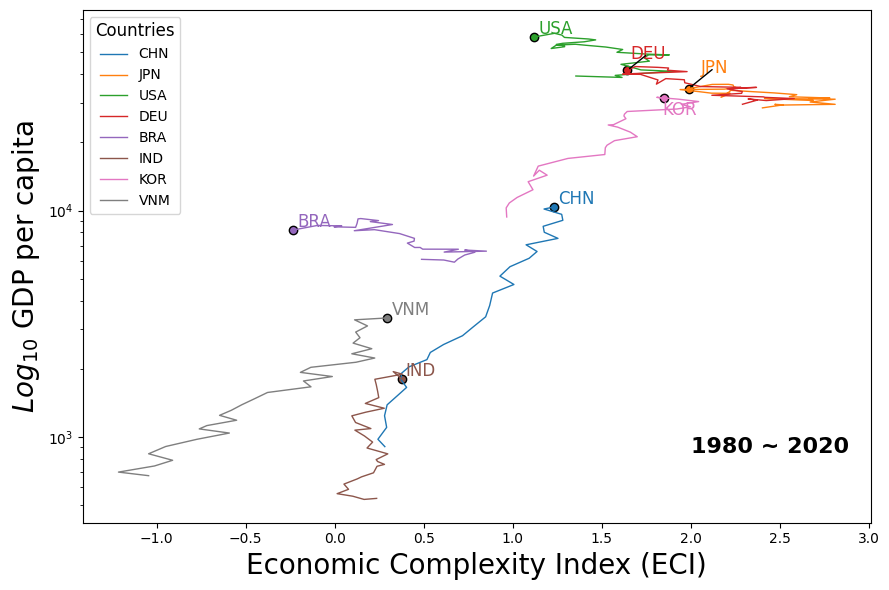

In [ ]:
import matplotlib.pyplot as plt
from adjustText import adjust_text
import matplotlib.cm as cm

# Extract ECI and GDP data
set1 = eci_product[[year for year in range(1990, end_year + 1)]]
set2 = GDP_pc[[year for year in range(1990, end_year + 1)]]

# Define country-specific colors
countries = ['CHN', 'JPN', 'USA', 'DEU', 'BRA', 'IND', 'KOR', 'VNM']
colors = cm.tab10(range(len(countries)))  # Use a colormap (e.g., tab10) to generate distinct colors

# Create plot
fig, ax = plt.subplots(figsize=(9, 6))
ax.set(xscale='linear', yscale='log')

texts = []
for idx, color in zip(countries, colors):
    # Plot line for each country
    ax.plot(set1.loc[idx], set2.loc[idx], color=color, lw=1, label=idx)
    # Scatter the last year's data point
    ax.scatter(set1.loc[idx, end_year], set2.loc[idx, end_year], color=color, edgecolor='black')
    # Add text labels
    texts.append(ax.text(set1.loc[idx, end_year], set2.loc[idx, end_year], idx, fontsize=12, color=color))

# Adjust text labels to prevent overlap
adjust_text(
    texts,
    arrowprops=dict(arrowstyle='-', color='black'),
    expand_points=(1.5, 1.5),
    expand_text=(1.5, 1.5),
    force_text=(0.5, 0.5),
    force_points=(0.5, 0.5),
    lim=500
)

# Customize plot appearance
plt.xlabel('Economic Complexity Index (ECI)', fontsize=20)
plt.ylabel('$Log_{10}$ GDP per capita', fontsize=20)
plt.legend(title="Countries", fontsize=10, title_fontsize=12, loc='best')
plt.text(2, 1000, '1980 ~ 2020', fontsize=16, fontweight='bold', va='top', ha='left')
plt.tight_layout()
plt.savefig(f"{output_path}/ECI_vs_GDP_per_Capita_Trajectory.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()


In [ ]:
temp_countries = [country for country in country_list if country.year == 2020]

temp_result_list = []
for temp_country in country_list:
    if temp_country.year >= 1980:
        temp_list = []
        temp_list.append(temp_country.name)
        temp_list.append(temp_country.year)
        #temp_list.append(np.log10(temp_country.GDP_per_capita))
        temp_list.append(temp_country.eci)
        temp_list.append(binary_rca[temp_country.year].loc[temp_country.name].sum())
        temp_list.append(np.sum(binary_rca[temp_country.year].loc[temp_country.name]*pci[temp_country.year])/np.sum(binary_rca[temp_country.year].loc[temp_country.name]))

        temp_df = binary_rca[temp_country.year]*Relative_pci[temp_country.year]
        temp_list.append(np.sum(temp_df.loc[temp_country.name])/np.sum(binary_rca[temp_country.year].loc[temp_country.name]))

        temp_list.append(np.sum(temp_df.loc[temp_country.name]))


        # TCI
        temp_list.append(binary_rta[temp_country.year].loc[temp_country.name].sum())

        temp_list.append(np.sum(binary_rta[temp_country.year].loc[temp_country.name]*tci[temp_country.year])/np.sum(binary_rta[temp_country.year].loc[temp_country.name]))

        temp_df = binary_rta[temp_country.year]*Relative_tci[temp_country.year]
        temp_list.append(np.sum(temp_df.loc[temp_country.name])/np.sum(binary_rta[temp_country.year].loc[temp_country.name]))

        temp_list.append(np.sum(temp_df.loc[temp_country.name]))

        temp_result_list.append(temp_list)

plot_df = pd.DataFrame(temp_result_list, columns = ['Country', 'Year', 'ECI', 'Number of RCA', 'Mean PCI','Mean Relative PCI', 'Sum Relative PCI','Number of RTA', 'Mean TCI','Mean Relative TCI', 'Sum Relative TCI'])

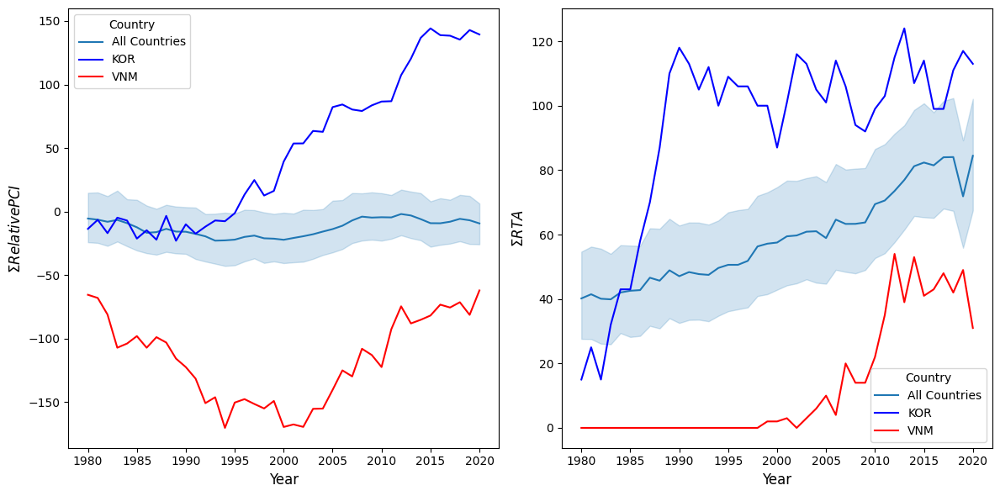

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Create a 1x2 panel for 2020 and 2020 data
fig, ax = plt.subplots(1, 2, figsize=(12, 6))

sns.lineplot(data=plot_df, x='Year', y='Sum Relative PCI', ax=ax[0], label='All Countries')
sns.lineplot(
    data=plot_df[plot_df['Country'] == 'KOR'],
    x='Year', y='Sum Relative PCI', color='blue', label='KOR', ax=ax[0]
)
sns.lineplot(
    data=plot_df[plot_df['Country'] == 'VNM'],
    x='Year', y='Sum Relative PCI', color='red', label='VNM', ax=ax[0]
)
ax[0].set_xlabel('Year', fontsize=12)
ax[0].set_ylabel('$\Sigma{Relative PCI}$', fontsize=12)
ax[0].legend(title='Country', fontsize=10)


sns.lineplot(data=plot_df, x='Year', y='Number of RTA', ax=ax[1], label='All Countries')
sns.lineplot(
    data=plot_df[plot_df['Country'] == 'KOR'],
    x='Year', y='Number of RTA', color='blue', label='KOR', ax=ax[1]
)
sns.lineplot(
    data=plot_df[plot_df['Country'] == 'VNM'],
    x='Year', y='Number of RTA', color='red', label='VNM', ax=ax[1]
)
ax[1].set_xlabel('Year', fontsize=12)
ax[1].set_ylabel('$\Sigma{RTA}$', fontsize=12)
ax[1].legend(title='Country', fontsize=10)
plt.tight_layout()
plt.savefig(f"{output_path}/PCI_RCA.jpg", dpi=300, transparent=True, bbox_inches="tight")

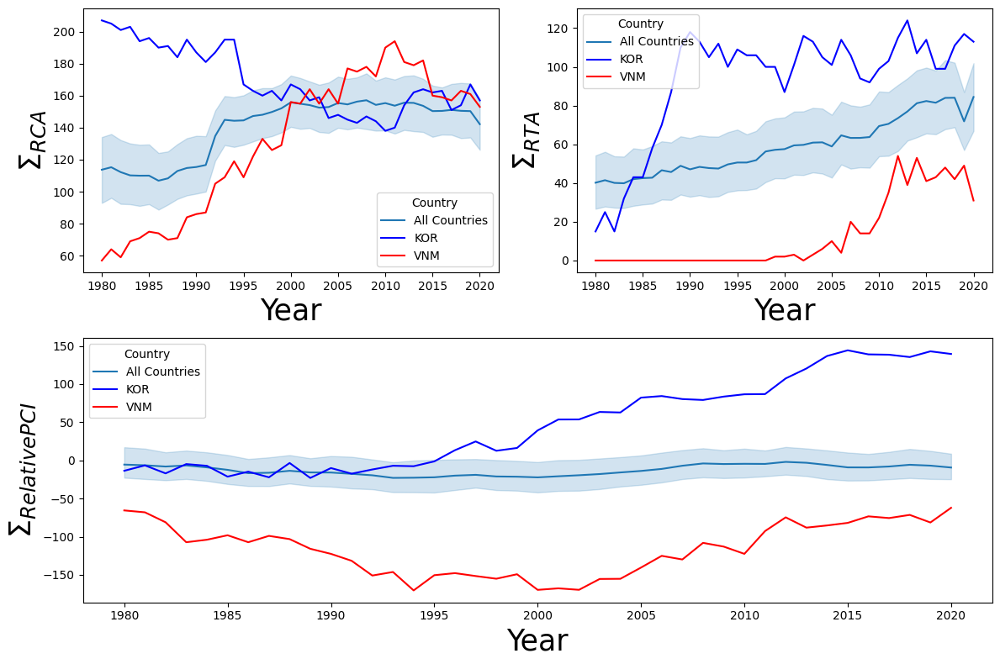

In [ ]:
# Import necessary libraries
import matplotlib.pyplot as plt
import seaborn as sns

# Assume the data `plot_df` is already loaded, along with an output path

# Create a grid layout with two rows: (1x2 for top) and (1x1 for bottom)
fig = plt.figure(figsize=(12, 8))
gs = fig.add_gridspec(2, 2, height_ratios=[1, 1])

# Top Left Panel (RCA over time)
ax1 = fig.add_subplot(gs[0, 0])
sns.lineplot(data=plot_df, x='Year', y='Number of RCA', ax=ax1, label='All Countries')
sns.lineplot(data=plot_df[plot_df['Country'] == 'KOR'], x='Year', y='Number of RCA', ax=ax1, color='blue', label='KOR')
sns.lineplot(data=plot_df[plot_df['Country'] == 'VNM'], x='Year', y='Number of RCA', ax=ax1, color='red', label='VNM')
ax1.set_xlabel('Year', fontsize=25)
ax1.set_ylabel('$\Sigma_{RCA}$', fontsize=25)
ax1.legend(title='Country', fontsize=10)
#ax1.set_title('Number of RCA by Country', fontsize=14)

# Top Right Panel (RTA over time)
ax2 = fig.add_subplot(gs[0, 1])
sns.lineplot(data=plot_df, x='Year', y='Number of RTA', ax=ax2, label='All Countries')
sns.lineplot(data=plot_df[plot_df['Country'] == 'KOR'], x='Year', y='Number of RTA', ax=ax2, color='blue', label='KOR')
sns.lineplot(data=plot_df[plot_df['Country'] == 'VNM'], x='Year', y='Number of RTA', ax=ax2, color='red', label='VNM')
ax2.set_xlabel('Year', fontsize=25)
ax2.set_ylabel('$\Sigma_{RTA}$', fontsize=25)
ax2.legend(title='Country', fontsize=10)
#ax2.set_title('Number of RTA by Country', fontsize=14)

# Bottom Panel (Relative PCI over time)
ax3 = fig.add_subplot(gs[1, :])
sns.lineplot(data=plot_df, x='Year', y='Sum Relative PCI', ax=ax3, label='All Countries')
sns.lineplot(data=plot_df[plot_df['Country'] == 'KOR'], x='Year', y='Sum Relative PCI', ax=ax3, color='blue', label='KOR')
sns.lineplot(data=plot_df[plot_df['Country'] == 'VNM'], x='Year', y='Sum Relative PCI', ax=ax3, color='red', label='VNM')
ax3.set_xlabel('Year', fontsize=25)
ax3.set_ylabel('$\Sigma_{Relative PCI}$', fontsize=25)
ax3.legend(title='Country', fontsize=10)
#ax3.set_title('Sum of Relative PCI by Country', fontsize=14)

# Adjust layout and save the figure
plt.tight_layout()
plt.savefig(f"{output_path}/PCI_RCA_RTA_reordered.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()


In [ ]:
temp_plot_df_1980 = plot_df[plot_df['Year'] == 1980]
temp_plot_df_1980.dropna(inplace=True)
temp_plot_df_2020 = plot_df[plot_df['Year'] == 2020]
temp_plot_df_2020.dropna(inplace=True)

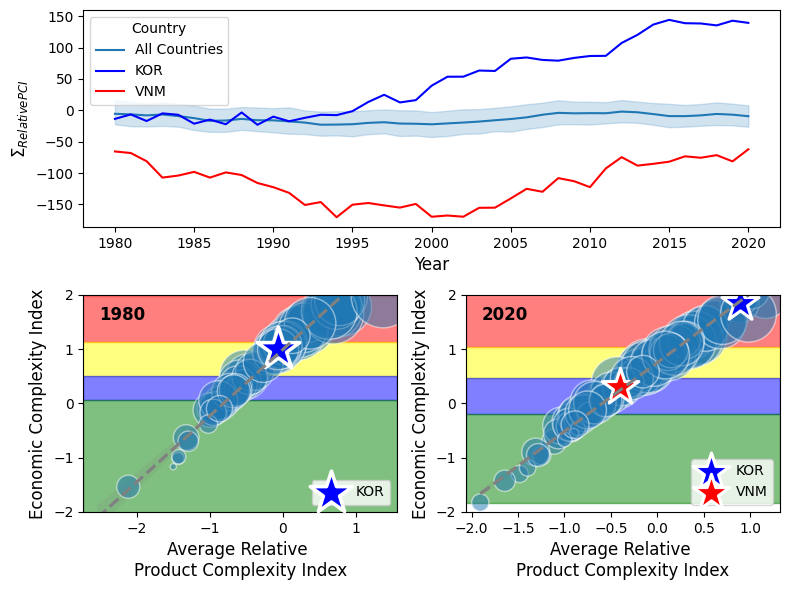

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Create a grid layout for 1x1 (top) and 1x2 (bottom)
fig = plt.figure(figsize=(8, 6))
gs = fig.add_gridspec(2, 2, height_ratios=[1, 1])

# First Row: Full-width plot
ax1 = fig.add_subplot(gs[0, :])
sns.lineplot(data=plot_df, x='Year', y='Sum Relative PCI', ax=ax1, label='All Countries')
sns.lineplot(
    data=plot_df[plot_df['Country'] == 'KOR'],
    x='Year', y='Sum Relative PCI', color='blue', label='KOR', ax=ax1
)
sns.lineplot(
    data=plot_df[plot_df['Country'] == 'VNM'],
    x='Year', y='Sum Relative PCI', color='red', label='VNM', ax=ax1
)
ax1.set_xlabel('Year', fontsize=12)
ax1.set_ylabel('$\Sigma_{Relative PCI}$', fontsize=12)
ax1.legend(title='Country', fontsize=10)

# Second Row: Left Panel (2020)
ax3 = fig.add_subplot(gs[1, 1])
sns.regplot(
    data=temp_plot_df_2020, y='ECI', x='Mean Relative PCI',
    scatter=False, color='grey', line_kws={"linestyle": "dashed"}, ax=ax3
)
sns.scatterplot(
    data=temp_plot_df_2020, y='ECI', x='Mean Relative PCI',
    s=temp_plot_df_2020['Number of RCA'] * 5, alpha=0.5, ax=ax3
)
sns.scatterplot(
    data=temp_plot_df_2020[temp_plot_df_2020['Country'] == 'KOR'], y='ECI', x='Mean Relative PCI',
    marker='*', s=temp_plot_df_2020[temp_plot_df_2020['Country'] == 'KOR']['Number of RCA'] * 5,
    color='blue', ax=ax3, label='KOR'
)
sns.scatterplot(
    data=temp_plot_df_2020[temp_plot_df_2020['Country'] == 'VNM'], y='ECI', x='Mean Relative PCI',
    marker='*', s=temp_plot_df_2020[temp_plot_df_2020['Country'] == 'VNM']['Number of RCA'] * 5,
    color='red', ax=ax3, label='VNM'
)

eci_quartiles = np.percentile(temp_plot_df_2020['ECI'], [25, 50, 75, 100])
q4, q3, q2, q1 = eci_quartiles
quartile_colors = ["red", "yellow", "blue", "green"]
ax3.axhspan(max(temp_plot_df_2020['ECI']), q2, color=quartile_colors[0], alpha=0.5, zorder=0)
ax3.axhspan(q2, q3, color=quartile_colors[1], alpha=0.5, zorder=0)
ax3.axhspan(q3, q4, color=quartile_colors[2], alpha=0.5, zorder=0)
ax3.axhspan(q4, min(temp_plot_df_2020['ECI']), color=quartile_colors[3], alpha=0.5, zorder=0)
ax3.set_xlabel('Average Relative \nProduct Complexity Index', fontsize=12)
ax3.set_ylabel('Economic Complexity Index', fontsize=12)
ax3.text(0.05, 0.95, '2020', fontsize=12, fontweight='bold', va='top', ha='left', transform=ax3.transAxes)

# Second Row: Right Panel (1980)
ax2 = fig.add_subplot(gs[1, 0])
sns.regplot(
    data=temp_plot_df_1980, y='ECI', x='Mean Relative PCI',
    scatter=False, color='grey', line_kws={"linestyle": "dashed"}, ax=ax2
)
sns.scatterplot(
    data=temp_plot_df_1980, y='ECI', x='Mean Relative PCI',
    s=temp_plot_df_1980['Number of RCA'] * 5, alpha=0.5, ax=ax2
)
sns.scatterplot(
    data=temp_plot_df_1980[temp_plot_df_1980['Country'] == 'KOR'], y='ECI', x='Mean Relative PCI',
    marker='*', s=temp_plot_df_1980[temp_plot_df_1980['Country'] == 'KOR']['Number of RCA'] * 5,
    color='blue', ax=ax2, label='KOR'
)
sns.scatterplot(
    data=temp_plot_df_1980[temp_plot_df_1980['Country'] == 'VNM'], y='ECI', x='Mean Relative PCI',
    marker='*', s=temp_plot_df_1980[temp_plot_df_1980['Country'] == 'VNM']['Number of RCA'] * 5,
    color='red', ax=ax2, label='VNM'
)

eci_quartiles_1980 = np.percentile(temp_plot_df_1980['ECI'], [25, 50, 75, 100])
q4, q3, q2, q1 = eci_quartiles_1980
ax2.axhspan(max(temp_plot_df_1980['ECI']), q2, color=quartile_colors[0], alpha=0.5, zorder=0)
ax2.axhspan(q2, q3, color=quartile_colors[1], alpha=0.5, zorder=0)
ax2.axhspan(q3, q4, color=quartile_colors[2], alpha=0.5, zorder=0)
ax2.axhspan(q4, min(temp_plot_df_1980['ECI']), color=quartile_colors[3], alpha=0.5, zorder=0)
ax2.set_xlabel('Average Relative \nProduct Complexity Index', fontsize=12)
ax2.set_ylabel('Economic Complexity Index', fontsize=12)
#ax2.set_ylabel('Economic Complexity Index', fontsize=12)
ax2.text(0.05, 0.95, '1980', fontsize=12, fontweight='bold', va='top', ha='left', transform=ax2.transAxes)


ax3.set_ylim(-2,2)
ax2.set_ylim(-2,2)
# Adjust layout and save
plt.tight_layout()
plt.savefig(f"{output_path}/Combined_Figure.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()


In [ ]:
binary_rta[1980].loc['KOR'].sum(), binary_rta[2020].loc['VNM'].sum()

(np.int64(15), np.int64(31))

# Diversification Pattern

In [ ]:
output_path = "Output"

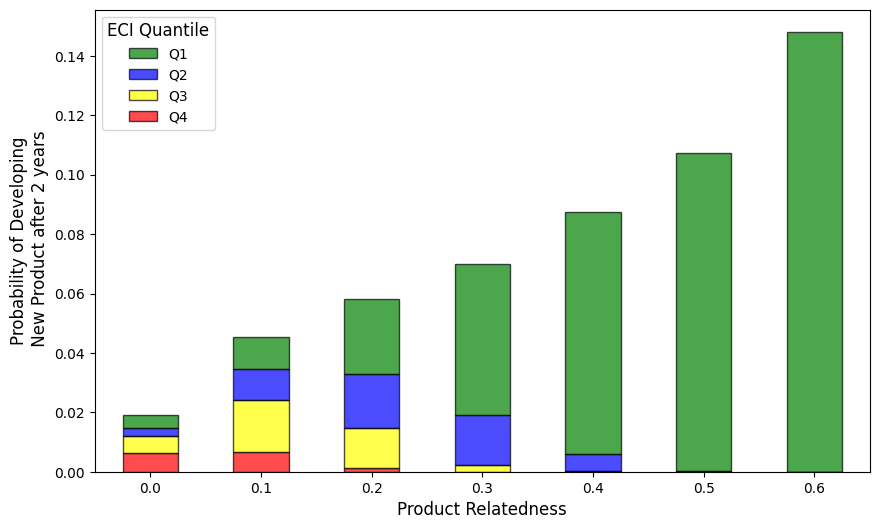

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Define bins and initialize DataFrame to hold results for each quartile
bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile across different bins
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []  # List to store ratios for each bin
    for i in bins:
        # Set the upper bound for the current bin
        upper_bound = i + 0.1 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop through each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci_product[year].copy()  # Assuming 'eci_product' is defined elsewhere
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels for categorization
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Create dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            # Calculate masks and accumulate values for nominator and denominator
            mask_nominator = ((Opportunity_product[year] * binary_rca[year + 2] * density_production[year]).loc[Q_dict[Q]] > i) & \
                             ((Opportunity_product[year] * binary_rca[year + 2] * density_production[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity_product[year] * density_production[year]) > i) & \
                               ((Opportunity_product[year] * density_production[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate the ratio and add it to the list of ratios for each bin
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios  # Update the dataframe with calculated ratios

years = range(1980, 2018)  # Define the range of years
# Call the function for each quartile
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red", "yellow", "blue", "green"]

# Plot the stacked bar chart for each bin
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors)
plt.xlabel("Product Relatedness", fontsize=12)
plt.ylabel("Probability of Developing\n New Product after 2 years", fontsize=12)
plt.xticks(rotation=0, fontsize=10)

# Customize legend order and labels for clarity
handles, labels = plt.gca().get_legend_handles_labels()
order = [3, 2, 1, 0]  # Set the correct order for the quartiles
plt.legend([handles[idx] for idx in order], [labels[idx] for idx in order], title="ECI Quantile", fontsize=10, title_fontsize=12)

# Save and display the plot
plt.savefig(f"{output_path}/Probability_Developing_New_Product_Product_Relatedness.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()


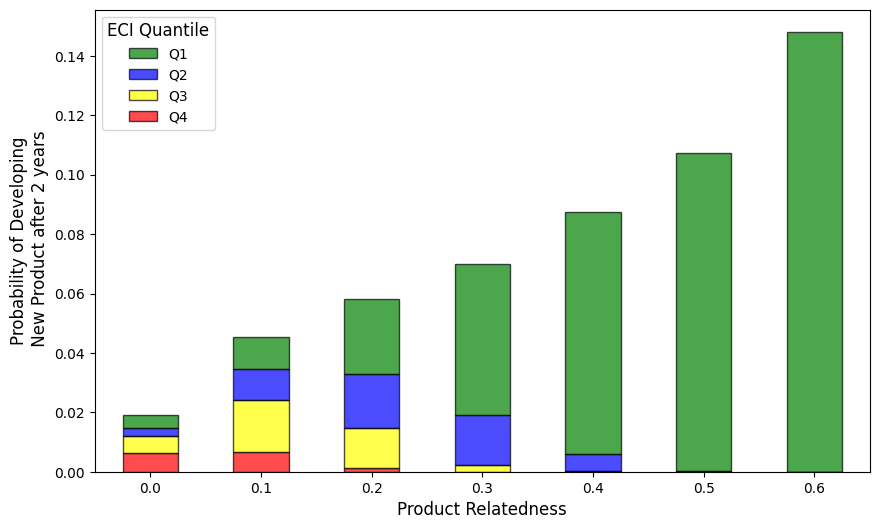

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.1 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci_product[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity_product[year] * binary_rca[year + 2] * density_production[year]).loc[Q_dict[Q]] > i) & \
                             ((Opportunity_product[year] * binary_rca[year + 2] * density_production[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity_product[year] * density_production[year]) > i) & \
                               ((Opportunity_product[year] * density_production[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios

years = range(1980, 2018)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red","yellow",'blue',"green"]

# Plot the stacked bar chart
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors)
plt.xlabel("Product Relatedness", fontsize=12)
plt.ylabel("Probability of Developing\n New Product after 2 years", fontsize=12)
plt.xticks(rotation=0, fontsize=10)

# Customize legend order and labels
handles, labels = plt.gca().get_legend_handles_labels()
order = [3, 2, 1, 0]  # Order for 'Q1', 'Q2', 'Q3', 'Q4'
plt.legend([handles[idx] for idx in order], [labels[idx] for idx in order], title="ECI Quantile", fontsize=10, title_fontsize=12)

plt.savefig(f"{output_path}/Probability_Developing_New_Product_Product_Relatedness.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()


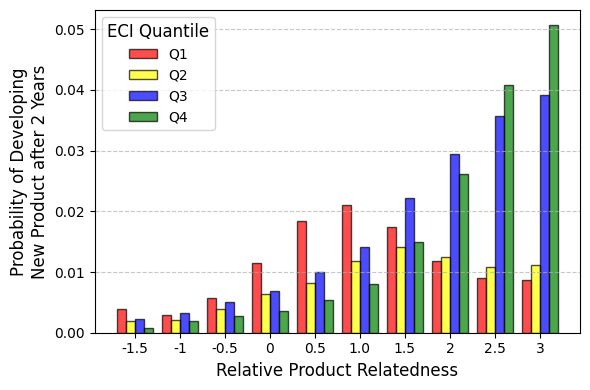

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Define bins and initialize DataFrame
bins = [-1.5, -1, -0.5, 0, 0.5, 1.0, 1.5, 2, 2.5, 3]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.4 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci_product[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity_product[year] * binary_rca[year + 2] * Relative_density_production[year]).loc[Q_dict[Q]] > i) & \
                             ((Opportunity_product[year] * binary_rca[year + 2] * Relative_density_production[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity_product[year] * Relative_density_production[year]) > i) & \
                               ((Opportunity_product[year] * Relative_density_production[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios
    temp_df1 = temp_df.copy()
    return temp_df1

# Define years and calculate ratios for each quartile
years = range(1980, 2018)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    temp_df1 = calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile
colors = ["red", "yellow", "blue", "green"]

# Create a bar chart with separate bars for each quartile
bar_width = 0.2
x = np.arange(len(bins))  # Position of bins on the x-axis

fig, ax = plt.subplots(figsize=(6, 4))

for i, quartile in enumerate(['Q1', 'Q2', 'Q3', 'Q4']):
    ax.bar(x + i * bar_width, temp_df.loc[quartile], width=bar_width, color=colors[i], label=quartile, edgecolor='black', alpha=0.7)

# Customize plot
ax.set_xticks(x + 1.5 * bar_width)
ax.set_xticklabels(bins)
ax.set_xlabel("Relative Product Relatedness", fontsize=12)
ax.set_ylabel("Probability of Developing\nNew Product after 2 Years", fontsize=12)
#ax.set_title("Probability of Developing New Products by ECI Quantile", fontsize=14)
ax.legend(title="ECI Quantile", fontsize=10, title_fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Save and display the plot
plt.tight_layout()
plt.savefig(f"{output_path}/Probability_Developing_New_Product_Relative_Product_Relatedness.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()


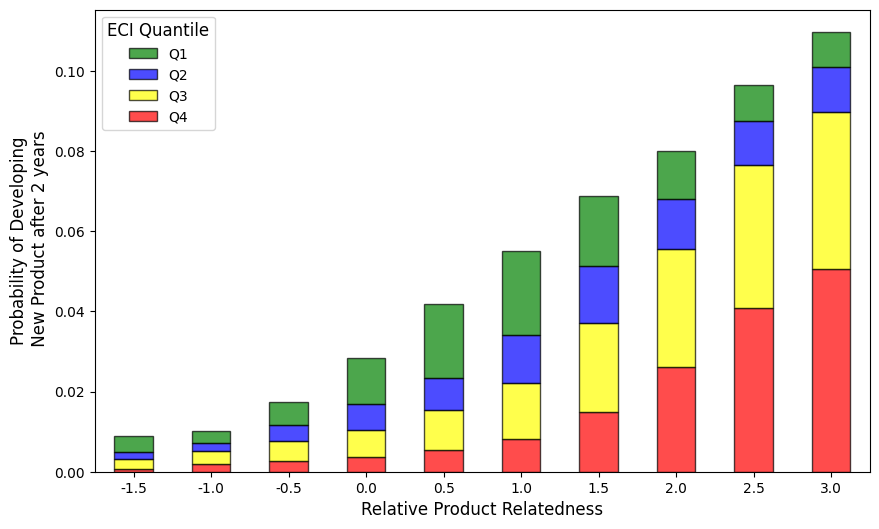

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

bins = [-1.5, -1, -0.5, 0, 0.5, 1.0, 1.5, 2, 2.5, 3]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.4 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci_product[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity_product[year] * binary_rca[year + 2] * Relative_density_production[year]).loc[Q_dict[Q]] > i) & \
                             ((Opportunity_product[year] * binary_rca[year + 2] * Relative_density_production[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity_product[year] * Relative_density_production[year]) > i) & \
                               ((Opportunity_product[year] * Relative_density_production[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios
    temp_df2 = temp_df.copy()
    return temp_df2

years = range(1980, 2018)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    temp_df2 = calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red","yellow",'blue',"green"]

# Plot the stacked bar chart
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors)
plt.xlabel("Relative Product Relatedness", fontsize=12)
plt.ylabel("Probability of Developing\n New Product after 2 years", fontsize=12)
plt.xticks(rotation=0, fontsize=10)

# Customize legend order and labels
handles, labels = plt.gca().get_legend_handles_labels()
order = [3, 2, 1, 0]  # Order for 'Q1', 'Q2', 'Q3', 'Q4'
plt.legend([handles[idx] for idx in order], [labels[idx] for idx in order], title="ECI Quantile", fontsize=10, title_fontsize=12)

plt.savefig(f"{output_path}/Probability_Developing_New_Product_Relative_Product_Relatedness.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()


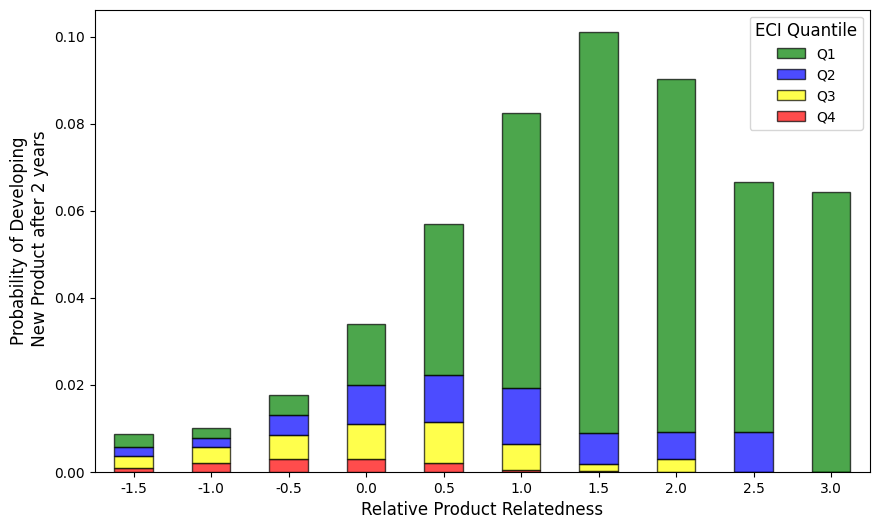

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

bins = [-1.5, -1, -0.5, 0, 0.5, 1.0, 1.5, 2, 2.5, 3]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.4 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci_product[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            binary_complex_product = (Relative_pci[year] >= 0).astype(int)

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity_product[year] * binary_rca[year + 2] * Relative_density_production[year]*binary_complex_product).loc[Q_dict[Q]] > i) & \
                             ((Opportunity_product[year] * binary_rca[year + 2] * Relative_density_production[year]*binary_complex_product).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity_product[year] * Relative_density_production[year]*binary_complex_product) > i) & \
                               ((Opportunity_product[year] * Relative_density_production[year]*binary_complex_product) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios

years = range(1980, 2018)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red","yellow",'blue',"green"]

# Plot the stacked bar chart
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors)
plt.xlabel("Relative Product Relatedness", fontsize=12)
plt.ylabel("Probability of Developing\n New Product after 2 years", fontsize=12)
plt.xticks(rotation=0, fontsize=10)

# Customize legend order and labels
handles, labels = plt.gca().get_legend_handles_labels()
order = [3, 2, 1, 0]  # Order for 'Q1', 'Q2', 'Q3', 'Q4'
plt.legend([handles[idx] for idx in order], [labels[idx] for idx in order], title="ECI Quantile", fontsize=10, title_fontsize=12)

plt.savefig(f"{output_path}/Probability_Developing_New_Complex_Product_Relative_Product_Relatedness.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()


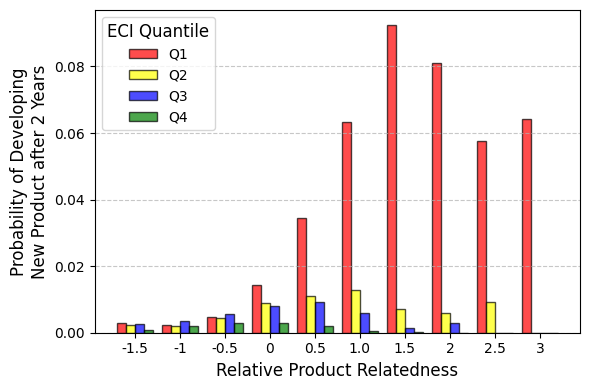

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Define bins and initialize DataFrame
bins = [-1.5, -1, -0.5, 0, 0.5, 1.0, 1.5, 2, 2.5, 3]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.4 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci_product[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            binary_complex_product = (Relative_pci[year] >= 0).astype(int)

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity_product[year] * binary_rca[year + 2] * Relative_density_production[year]*binary_complex_product).loc[Q_dict[Q]] > i) & \
                             ((Opportunity_product[year] * binary_rca[year + 2] * Relative_density_production[year]*binary_complex_product).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity_product[year] * Relative_density_production[year]*binary_complex_product) > i) & \
                               ((Opportunity_product[year] * Relative_density_production[year]*binary_complex_product) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios
    temp_df2 = temp_df.copy()
    return temp_df2

# Define years and calculate ratios for each quartile
years = range(1980, 2018)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    temp_df2 = calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile
colors = ["red", "yellow", "blue", "green"]

# Create a bar chart with separate bars for each quartile
bar_width = 0.2
x = np.arange(len(bins))  # Position of bins on the x-axis

fig, ax = plt.subplots(figsize=(6, 4))

for i, quartile in enumerate(['Q1', 'Q2', 'Q3', 'Q4']):
    ax.bar(x + i * bar_width, temp_df.loc[quartile], width=bar_width, color=colors[i], label=quartile, edgecolor='black', alpha=0.7)

# Customize plot
ax.set_xticks(x + 1.5 * bar_width)
ax.set_xticklabels(bins)
ax.set_xlabel("Relative Product Relatedness", fontsize=12)
ax.set_ylabel("Probability of Developing\nNew Product after 2 Years", fontsize=12)
#ax.set_title("Probability of Developing New Products by ECI Quantile", fontsize=14)
ax.legend(title="ECI Quantile", fontsize=10, title_fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Save and display the plot
plt.tight_layout()
plt.savefig(f"{output_path}/Probability_Developing_New_Complex_Product_Relative_Product_Relatedness.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()


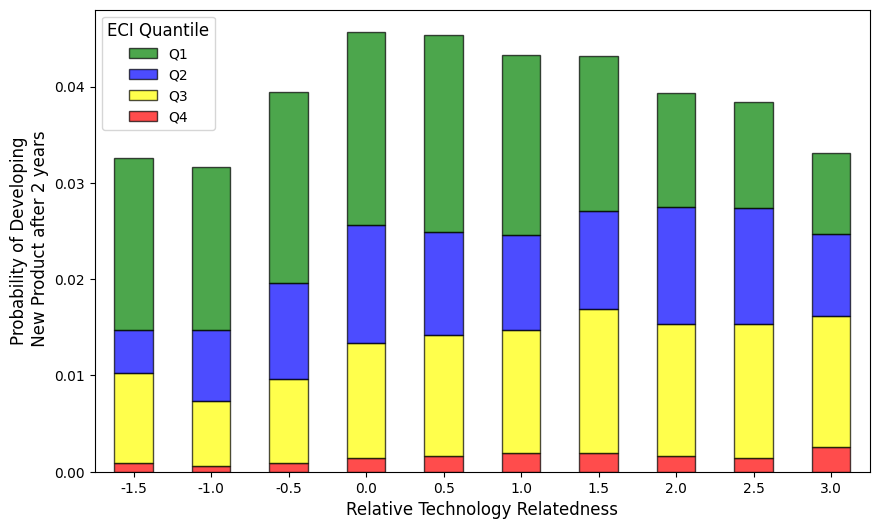

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

bins = [-1.5, -1, -0.5, 0, 0.5, 1.0, 1.5, 2, 2.5, 3]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.4 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci_product[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity_product[year] * binary_rca[year + 2] * Relative_density_from_technology[year]).loc[Q_dict[Q]] > i) & \
                             ((Opportunity_product[year] * binary_rca[year + 2] * Relative_density_from_technology[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity_product[year] * Relative_density_from_technology[year]) > i) & \
                               ((Opportunity_product[year] * Relative_density_from_technology[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios
    temp_df3 = temp_df.copy()
    return temp_df3


years = range(1980, 2018)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    temp_df3 = calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red","yellow",'blue',"green"]

# Plot the stacked bar chart
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors)
plt.xlabel("Relative Technology Relatedness", fontsize=12)
plt.ylabel("Probability of Developing\n New Product after 2 years", fontsize=12)
plt.xticks(rotation=0, fontsize=10)

# Customize legend order and labels
handles, labels = plt.gca().get_legend_handles_labels()
order = [3, 2, 1, 0]  # Order for 'Q1', 'Q2', 'Q3', 'Q4'
plt.legend([handles[idx] for idx in order], [labels[idx] for idx in order], title="ECI Quantile", fontsize=10, title_fontsize=12)

plt.savefig(f"{output_path}/Probability_Developing_New_Product_Technology_Relatedness.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()


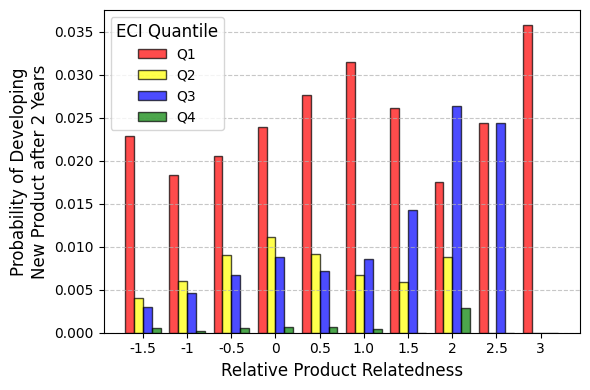

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Define bins and initialize DataFrame
bins = [-1.5, -1, -0.5, 0, 0.5, 1.0, 1.5, 2, 2.5, 3]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.4 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci_product[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            binary_complex_product = (Relative_pci[year] >= 0).astype(int)
            temp_index = Relative_density_from_technology[year].index
            # Calculate masks and accumulate nominator and denominator
            mask_nominator = (((Opportunity_product[year].loc[temp_index]) * (binary_rca[year + 2].loc[temp_index]) * Relative_density_from_technology[year]*binary_complex_product).loc[Q_dict[Q]] > i) & \
                             (((Opportunity_product[year].loc[temp_index]) * (binary_rca[year + 2].loc[temp_index]) * Relative_density_from_technology[year]*binary_complex_product).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = (((Opportunity_product[year].loc[temp_index]) * Relative_density_from_technology[year]*binary_complex_product) > i) & \
                               (((Opportunity_product[year].loc[temp_index]) * Relative_density_from_technology[year]*binary_complex_product) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios
    temp_df4 = temp_df.copy()
    return temp_df4

# Define years and calculate ratios for each quartile
years = range(1980, 2018)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    temp_df4 = calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile
colors = ["red", "yellow", "blue", "green"]

# Create a bar chart with separate bars for each quartile
bar_width = 0.2
x = np.arange(len(bins))  # Position of bins on the x-axis

fig, ax = plt.subplots(figsize=(6, 4))

for i, quartile in enumerate(['Q1', 'Q2', 'Q3', 'Q4']):
    ax.bar(x + i * bar_width, temp_df.loc[quartile], width=bar_width, color=colors[i], label=quartile, edgecolor='black', alpha=0.7)

# Customize plot
ax.set_xticks(x + 1.5 * bar_width)
ax.set_xticklabels(bins)
ax.set_xlabel("Relative Product Relatedness", fontsize=12)
ax.set_ylabel("Probability of Developing\nNew Product after 2 Years", fontsize=12)
#ax.set_title("Probability of Developing New Products by ECI Quantile", fontsize=14)
ax.legend(title="ECI Quantile", fontsize=10, title_fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Save and display the plot
plt.tight_layout()
plt.savefig(f"{output_path}/Probability_Developing_New_Complex_Product_Relative_Technology_Relatedness.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()


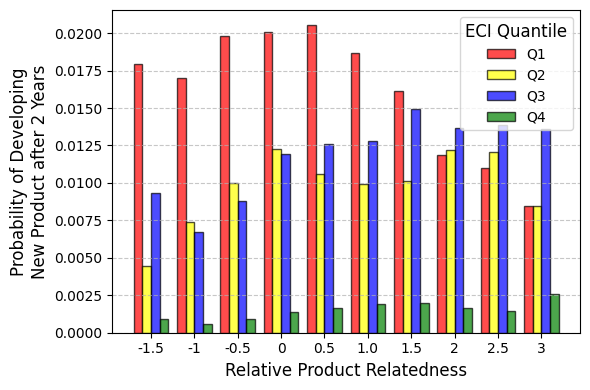

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Define bins and initialize DataFrame
bins = [-1.5, -1, -0.5, 0, 0.5, 1.0, 1.5, 2, 2.5, 3]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.4 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci_product[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            temp_index = Relative_density_from_technology[year].index
            # Calculate masks and accumulate nominator and denominator
            mask_nominator = (((Opportunity_product[year]) * (binary_rca[year + 2]) * Relative_density_from_technology[year]).loc[Q_dict[Q]] > i) & \
                             (((Opportunity_product[year]) * (binary_rca[year + 2]) * Relative_density_from_technology[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = (((Opportunity_product[year]) * Relative_density_from_technology[year]) > i) & \
                               (((Opportunity_product[year]) * Relative_density_from_technology[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios
    temp_df3 = temp_df.copy()
    return temp_df3

# Define years and calculate ratios for each quartile
years = range(1980, 2018)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    temp_df3 = calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile
colors = ["red", "yellow", "blue", "green"]

# Create a bar chart with separate bars for each quartile
bar_width = 0.2
x = np.arange(len(bins))  # Position of bins on the x-axis

fig, ax = plt.subplots(figsize=(6, 4))

for i, quartile in enumerate(['Q1', 'Q2', 'Q3', 'Q4']):
    ax.bar(x + i * bar_width, temp_df.loc[quartile], width=bar_width, color=colors[i], label=quartile, edgecolor='black', alpha=0.7)

# Customize plot
ax.set_xticks(x + 1.5 * bar_width)
ax.set_xticklabels(bins)
ax.set_xlabel("Relative Product Relatedness", fontsize=12)
ax.set_ylabel("Probability of Developing\nNew Product after 2 Years", fontsize=12)
#ax.set_title("Probability of Developing New Products by ECI Quantile", fontsize=14)
ax.legend(title="ECI Quantile", fontsize=10, title_fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Save and display the plot
plt.tight_layout()
plt.savefig(f"{output_path}/Probability_Developing_New_Product_Relative_Technology_Relatedness.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()


In [ ]:
temp_df

,-1.5,-1.0,-0.5,0.0,0.5,1.0,1.5,2.0,2.5,3.0
Q4,0.000889,0.000585,0.000890,0.001396,0.001632,0.001924,0.001962,0.001664,0.001463,0.002596
Q3,0.009337,0.006754,0.008774,0.011950,0.012596,0.012780,0.014925,0.013681,0.013894,0.013628
Q2,0.004446,0.007361,0.009969,0.012272,0.010625,0.009912,0.010149,0.012202,0.012066,0.008436
Q1,0.017934,0.016996,0.019777,0.020092,0.020518,0.018662,0.016119,0.011832,0.010969,0.008436


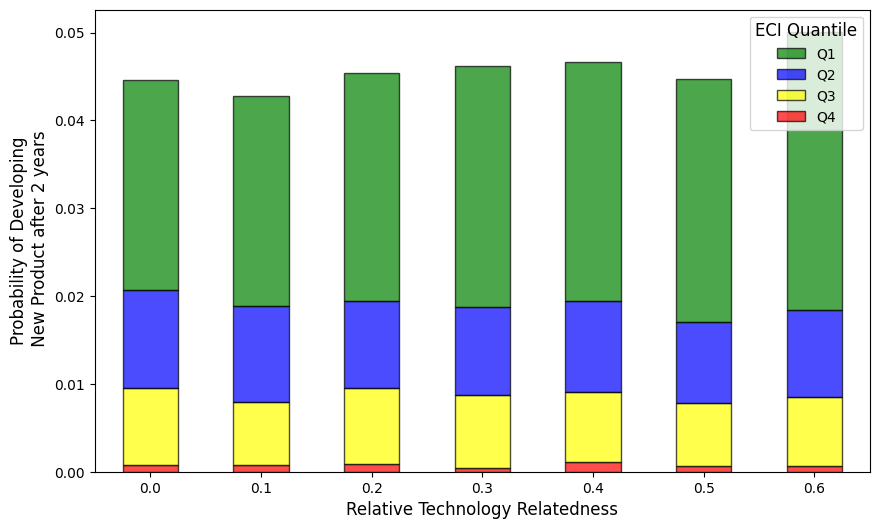

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.1 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci_product[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }


            binary_complex_product = (Relative_pci[year] >= 0).astype(int)

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity_product[year] * binary_rca[year + 2] * Relative_density_from_technology[year]*binary_complex_product).loc[Q_dict[Q]] > i) & \
                             ((Opportunity_product[year] * binary_rca[year + 2] * Relative_density_from_technology[year]*binary_complex_product).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity_product[year] * Relative_density_from_technology[year]*binary_complex_product) > i) & \
                               ((Opportunity_product[year] * Relative_density_from_technology[year]*binary_complex_product) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios


years = range(1980, 2018)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red","yellow",'blue',"green"]

# Plot the stacked bar chart
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors)
plt.xlabel("Relative Technology Relatedness", fontsize=12)
plt.ylabel("Probability of Developing\n New Product after 2 years", fontsize=12)
plt.xticks(rotation=0, fontsize=10)

# Customize legend order and labels
handles, labels = plt.gca().get_legend_handles_labels()
order = [3, 2, 1, 0]  # Order for 'Q1', 'Q2', 'Q3', 'Q4'
plt.legend([handles[idx] for idx in order], [labels[idx] for idx in order], title="ECI Quantile", fontsize=10, title_fontsize=12)

plt.savefig(f"{output_path}/Probability_Developing_New_Complex_Product_Relative_Technology_Relatedness.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()


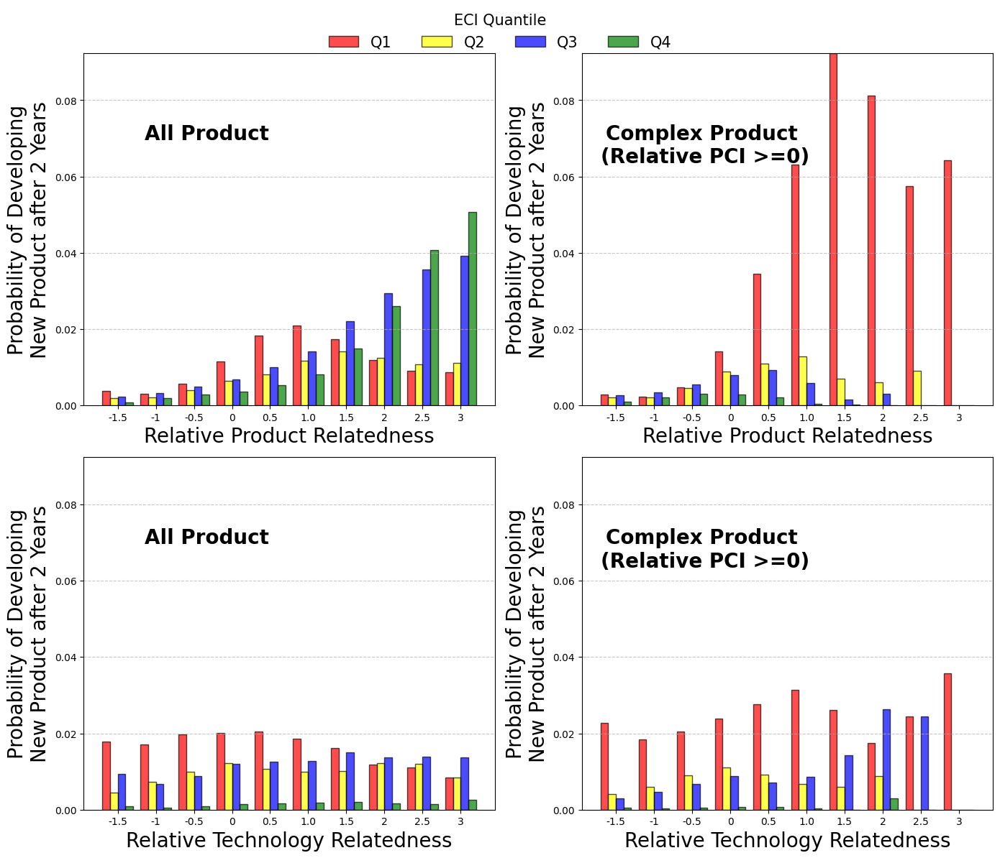

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Assume `temp_df_list` is a list of 4 DataFrames, each corresponding to a different dataset
# The following code assumes `temp_df_list` contains `temp_df1`, `temp_df2`, `temp_df3`, and `temp_df4`

# Define common bins and bar width
bins = [-1.5, -1, -0.5, 0, 0.5, 1.0, 1.5, 2, 2.5, 3]
bar_width = 0.2
x = np.arange(len(bins))  # Position of bins on the x-axis
colors = ["red", "yellow", "blue", "green"]
#titles = [
#    "New Product: Relative Product Relatedness",
#    "New Complex Product: Relative Product Relatedness",
#    "New Product: Relative Technology Relatedness",
#    "New Complex Product: Relative Technology Relatedness"
#]

# Simulate `temp_df_list` for demonstration
# Replace this with your real data: temp_df1, temp_df2, temp_df3, temp_df4
temp_df_list = [temp_df1,temp_df2,temp_df3,temp_df4]

# Find global y-axis limits across all DataFrames
y_min = min(df.min().min() for df in temp_df_list)
y_max = max(df.max().max() for df in temp_df_list)

# Create 2x2 subplot grid
fig, axes = plt.subplots(2, 2, figsize=(14, 12))
axes = axes.flatten()

for idx, ax in enumerate(axes):
    temp_df = temp_df_list[idx]
    for i, quartile in enumerate(['Q1', 'Q2', 'Q3', 'Q4']):
        ax.bar(x + i * bar_width, temp_df.loc[quartile], width=bar_width, color=colors[i], label=quartile, edgecolor='black', alpha=0.7)

    # Customize each subplot
    ax.set_xticks(x + 1.5 * bar_width)
    ax.set_xticklabels(bins)
    if idx in [2, 3]:
        ax.set_xlabel("Relative Technology Relatedness", fontsize=20)
    else:
        ax.set_xlabel("Relative Product Relatedness", fontsize=20)
    if idx % 2 == 1:
        ax.text(0.3, 0.8, "Complex Product \n(Relative PCI >=0)", fontsize=20, ha='center', va='top', transform=ax.transAxes, fontweight='bold')
    else:
        ax.text(0.3, 0.8, "All Product", fontsize=20, ha='center', va='top', transform=ax.transAxes, fontweight='bold')
    ax.set_ylabel("Probability of Developing\nNew Product after 2 Years", fontsize=20)
    ax.set_ylim(y_min, y_max)  # Set the same y-limits for all subplots
    #ax.set_title(titles[idx], fontsize=14)
    ax.grid(axis='y', linestyle='--', alpha=0.7)

# Add a single legend for the whole figure
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='upper center', title="ECI Quantile", fontsize=15, title_fontsize=15, ncol=4, frameon=False)

# Adjust layout and save the combined figure
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Leave space for legend
plt.savefig(f"{output_path}/Combined_Probability_Developing_Products.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.show()


In [ ]:
Relative_density_from_technology[year]

,0011,0012,0013,0014,0015,0019,0111,0112,0113,0114,...,8996,8997,8998,8999,9110,9310,9410,9510,9610,9710
GEO,1.116292,2.117688,0.715530,1.111468,-0.794092,-3.693274,0.584212,0.855008,-0.143637,1.453217,...,0.248578,0.288984,-1.538050,-0.537412,-3.693274,-0.645994,0.502611,-0.164490,-0.274285,1.464481
SVK,1.967867,1.208800,1.886006,1.540224,-0.391934,-4.690189,-0.028372,0.351948,-0.072267,0.345052,...,-0.488356,0.280305,-0.628250,-0.652270,-4.690189,-0.251291,0.709723,0.864226,0.391872,0.101855
KAZ,0.473059,1.118019,0.248201,0.311602,-0.234336,-3.082632,0.173479,0.973309,-0.290793,0.587726,...,-0.485580,-0.209465,-1.443662,0.383243,-3.082632,-0.290179,0.717592,0.038016,-0.236819,1.687431
DJI,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NZL,1.913463,2.952835,0.721415,1.349576,1.485738,-5.220836,1.568032,3.966677,0.185923,0.477083,...,-0.061479,0.268268,-0.767102,-0.300416,-5.220836,0.192643,0.369791,0.331144,1.069478,0.959947
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GTM,0.572463,1.581976,0.207227,0.332836,0.317638,-3.298332,0.922882,1.786185,-0.276616,0.821413,...,0.076327,0.864663,-1.165915,-0.265306,-3.298332,0.238445,0.979525,0.107536,0.108863,1.783763
EST,1.042117,1.542513,0.130449,0.026270,-0.281129,-3.011643,0.035317,0.959305,-0.132306,0.319409,...,-0.667043,0.045980,-0.910446,1.438372,-3.011643,-0.203117,0.241201,-0.425472,0.012536,0.583648
NGA,0.732597,1.408760,0.526291,-0.060345,0.136677,-3.003234,0.476615,0.493852,0.426244,0.970711,...,-0.055227,-0.941274,-1.065510,-2.114257,-3.003234,0.293983,1.195365,-0.075559,-0.256737,2.528990
NOR,1.245323,1.469144,0.923637,1.053413,0.622610,-5.034237,0.392917,1.314911,0.453585,0.768767,...,0.180307,0.337645,-0.885165,-1.185141,-5.034237,0.717055,0.699539,0.861211,0.255134,0.995494


In [ ]:
Opportunity_product[year]

,0011,0012,0013,0014,0015,0019,0111,0112,0113,0114,...,8996,8997,8998,8999,9110,9310,9410,9510,9610,9710
location_code,,,,,,,,,,,,,,,,,,,,,
ABW,1,1,1,1,1,1,1,1,1,1,...,0,1,1,1,1,0,0,1,1,1
AFG,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,0,1,1,1
AGO,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
AIA,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,0,1,1,1,1
ALB,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,0,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
YMD,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
YUG,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
ZAF,1,0,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,0,0,0,0


In [ ]:
Relative_density_from_technology[year]

,0011,0012,0013,0014,0015,0019,0111,0112,0113,0114,...,8996,8997,8998,8999,9110,9310,9410,9510,9610,9710
GEO,1.116292,2.117688,0.715530,1.111468,-0.794092,-3.693274,0.584212,0.855008,-0.143637,1.453217,...,0.248578,0.288984,-1.538050,-0.537412,-3.693274,-0.645994,0.502611,-0.164490,-0.274285,1.464481
SVK,1.967867,1.208800,1.886006,1.540224,-0.391934,-4.690189,-0.028372,0.351948,-0.072267,0.345052,...,-0.488356,0.280305,-0.628250,-0.652270,-4.690189,-0.251291,0.709723,0.864226,0.391872,0.101855
KAZ,0.473059,1.118019,0.248201,0.311602,-0.234336,-3.082632,0.173479,0.973309,-0.290793,0.587726,...,-0.485580,-0.209465,-1.443662,0.383243,-3.082632,-0.290179,0.717592,0.038016,-0.236819,1.687431
DJI,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NZL,1.913463,2.952835,0.721415,1.349576,1.485738,-5.220836,1.568032,3.966677,0.185923,0.477083,...,-0.061479,0.268268,-0.767102,-0.300416,-5.220836,0.192643,0.369791,0.331144,1.069478,0.959947
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GTM,0.572463,1.581976,0.207227,0.332836,0.317638,-3.298332,0.922882,1.786185,-0.276616,0.821413,...,0.076327,0.864663,-1.165915,-0.265306,-3.298332,0.238445,0.979525,0.107536,0.108863,1.783763
EST,1.042117,1.542513,0.130449,0.026270,-0.281129,-3.011643,0.035317,0.959305,-0.132306,0.319409,...,-0.667043,0.045980,-0.910446,1.438372,-3.011643,-0.203117,0.241201,-0.425472,0.012536,0.583648
NGA,0.732597,1.408760,0.526291,-0.060345,0.136677,-3.003234,0.476615,0.493852,0.426244,0.970711,...,-0.055227,-0.941274,-1.065510,-2.114257,-3.003234,0.293983,1.195365,-0.075559,-0.256737,2.528990
NOR,1.245323,1.469144,0.923637,1.053413,0.622610,-5.034237,0.392917,1.314911,0.453585,0.768767,...,0.180307,0.337645,-0.885165,-1.185141,-5.034237,0.717055,0.699539,0.861211,0.255134,0.995494


In [ ]:
Opportunity_product[year]

,0011,0012,0013,0014,0015,0019,0111,0112,0113,0114,...,8996,8997,8998,8999,9110,9310,9410,9510,9610,9710
location_code,,,,,,,,,,,,,,,,,,,,,
ABW,1,1,1,1,1,1,1,1,1,1,...,0,1,1,1,1,0,0,1,1,1
AFG,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,0,1,1,1
AGO,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
AIA,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,0,1,1,1,1
ALB,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,0,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
YMD,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
YUG,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
ZAF,1,0,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,0,0,0,0


In [ ]:
Relative_density_from_technology

{1976:          0011      0012      0013      0014      0015      0019      0111  \
 GEO       NaN       NaN       NaN       NaN       NaN       NaN       NaN   
 SVK       NaN       NaN       NaN       NaN       NaN       NaN       NaN   
 KAZ       NaN       NaN       NaN       NaN       NaN       NaN       NaN   
 DJI       NaN       NaN       NaN       NaN       NaN       NaN       NaN   
 NZL  0.699972  0.267190  0.988505  0.474304  3.483058  2.710292  3.278407   
 ..        ...       ...       ...       ...       ...       ...       ...   
 GTM       NaN       NaN       NaN       NaN       NaN       NaN       NaN   
 EST       NaN       NaN       NaN       NaN       NaN       NaN       NaN   
 NGA       NaN       NaN       NaN       NaN       NaN       NaN       NaN   
 NOR  0.253350  0.747060  1.609535 -0.151583  0.621436  2.246244  0.713637   
 CHL  0.584514  1.234755  1.873279 -0.203425  0.612999  0.732293  0.635632   
 
          0112      0113      0114  ...      8996      8

In [ ]:
eci_product[year].loc[country]

np.float64(-0.9534275139372711)

In [ ]:
eci_product[year].values

array([ 0.83979107, -0.94080152, -1.98516792,  1.64175987, -0.11307142,
        1.09172538,  1.86309729,  0.44400664, -0.25585809, -0.39277598,
       -0.20725495,  0.43910253,  1.40019541,  0.49784709, -0.47579612,
       -0.56067364,  1.48008634, -1.15331878, -1.53667137,  0.9852726 ,
       -1.57952304,  0.67694241, -2.13319194, -0.43187312,  0.57504372,
        0.1597749 , -0.04388351,  0.7082263 ,  0.64730937,  0.66910267,
       -0.24817506,  0.47362098, -0.84558746, -0.2329238 ,  0.75671178,
       -0.51108863,  0.36866435,  0.44400664, -0.62497068, -0.53069896,
        0.46758942,  1.53292911,  1.94210335, -0.3947195 ,  1.22874132,
       -1.71797061, -1.4083637 , -1.23326459, -2.29069598,  0.43312938,
       -0.16256658, -0.93281432, -0.18676307,  0.26394084,  0.44400664,
       -0.96465741,  0.61486354,  1.26093019, -0.54695061,  0.38163871,
        1.54168623,  1.64420456, -0.60124142,  0.55476807,  0.87721202,
       -0.08917037, -0.66819072, -1.42617751,  0.01299533, -1.18

In [ ]:
temp_result_list = []

for year in range(1980, 2018):
    eci_values = eci_product[year].values
    quartiles = np.percentile(eci_values, [25, 50, 75])
    print(quartiles)

    temp_countries = Relative_density_from_technology[year].index

    for country in Relative_density_from_technology[year].index:
        for product in Relative_density_from_technology[year].columns:
            if Opportunity_product[year].loc[country, product] == 1 and binary_rca[year + 2].loc[country, product] == 1:
                temp_list = []
                temp_list.append(country)
                temp_list.append(product)
                temp_list.append(year)
                temp_list.append(Relative_density_production[year].loc[country, product])
                temp_list.append(Relative_density_from_technology[year].loc[country, product])
                temp_list.append(Relative_pci[year].loc[country, product])

                eci_value = eci_product[year].loc[country]
                if eci_value >= quartiles[2]:  # 상위 25%
                    temp_list.append('Q1')
                elif eci_value >= quartiles[1]:  # 중간 상위
                    temp_list.append('Q2')
                elif eci_value >= quartiles[0]:  # 중간 하위
                    temp_list.append('Q3')
                else:  # 하위 25%
                    temp_list.append('Q4')

                temp_list.append(eci_value)
                if Relative_pci[year].loc[country, product] >= 0:
                    temp_list.append('Relative PCI >= 0')
                else:
                    temp_list.append('Relative PCI < 0')
                temp_result_list.append(temp_list)

temp_result_df = pd.DataFrame(temp_result_list, columns=['Country', 'Product', 'Year', 'Relative Production Relatedness', 'Relative Technology Relatedness', 'Relative PCI','ECI_Level','ECI','Complex Product'])
temp_result_df

[-0.74232456  0.28053728  0.64571657]
[-0.60250099  0.29226989  0.62683594]
[-0.66842573  0.38023722  0.60770099]
[-0.68844239  0.28493014  0.60083433]
[-0.69496564  0.3137396   0.61014572]
[-0.61656733  0.16601099  0.58384728]
[-0.68277655  0.18987798  0.53167608]
[-0.68221957  0.2005447   0.54467195]
[-0.58221516  0.24955221  0.49839456]
[-0.68855598  0.29770519  0.50736885]
[-0.61839512  0.19680677  0.48449228]
[-0.71785854  0.22796095  0.50468532]
[-0.63869127  0.10111648  0.5782794 ]
[-0.76744293  0.14714457  0.51335456]
[-0.75033213  0.07733005  0.53817229]
[-0.67857469  0.0633789   0.5057942 ]
[-0.74293929  0.03201698  0.469834  ]
[-0.69705156  0.14627665  0.45706576]
[-0.67565077  0.16055917  0.52542575]
[-0.7043687   0.15272329  0.5267574 ]
[-0.73171863  0.06060742  0.62315619]
[-0.76245598  0.0429003   0.52488108]
[-0.77558769  0.00534698  0.59450746]
[-0.77238973  0.0016965   0.63337688]
[-0.76063632 -0.03871181  0.61444688]
[-0.68852713  0.00868453  0.63316795]
[-0.71727497

,Country,Product,Year,Relative Production Relatedness,Relative Technology Relatedness,Relative PCI,ECI_Level,ECI,Complex Product
0,DJI,0360,1980,2.954604,NaN,-2.068260,Q3,0.042521,Relative PCI < 0
1,DJI,0483,1980,1.390256,NaN,-0.607309,Q3,0.042521,Relative PCI < 0
2,DJI,0615,1980,3.390243,NaN,-2.032743,Q3,0.042521,Relative PCI < 0
3,DJI,0619,1980,-0.469379,NaN,0.178239,Q3,0.042521,Relative PCI >= 0
4,DJI,1110,1980,0.987309,NaN,-0.358757,Q3,0.042521,Relative PCI < 0
...,...,...,...,...,...,...,...,...,...
96040,CHL,6351,2017,0.841262,0.346664,0.026795,Q3,-0.337941,Relative PCI >= 0
96041,CHL,6413,2017,1.049947,-0.224390,-0.084503,Q3,-0.337941,Relative PCI < 0
96042,CHL,6716,2017,1.167265,1.606862,-0.837983,Q3,-0.337941,Relative PCI < 0
96043,CHL,6732,2017,0.917250,0.316994,-0.551371,Q3,-0.337941,Relative PCI < 0


In [ ]:
eci_product.loc['KOR']

1976    0.735994
1977    0.795352
1978    0.892229
1979    0.955891
1980    0.998565
1981    1.043525
1982    0.970271
1983    1.003850
1984    1.039457
1985    0.971572
1986    1.030698
1987    0.993012
1988    0.992194
1989    0.897150
1990    0.965942
1991    0.962900
1992    0.980402
1993    1.024330
1994    1.113385
1995    1.086266
1996    1.192989
1997    1.148996
1998    1.116867
1999    1.142844
2000    1.309731
2001    1.516976
2002    1.519783
2003    1.529169
2004    1.571467
2005    1.699219
2006    1.660829
2007    1.589376
2008    1.535996
2009    1.565705
2010    1.635541
2011    1.624179
2012    1.627614
2013    1.642774
2014    1.921859
2015    1.997765
2016    1.946869
2017    2.044012
2018    1.930278
2019    1.809307
2020    1.847235
Name: KOR, dtype: float64

In [ ]:
eci_product[1976].loc['KOR']

np.float64(0.7359938238738177)

In [ ]:
temp_result_df.dropna(inplace=True)
temp_result_df.reset_index(drop=True, inplace=True)

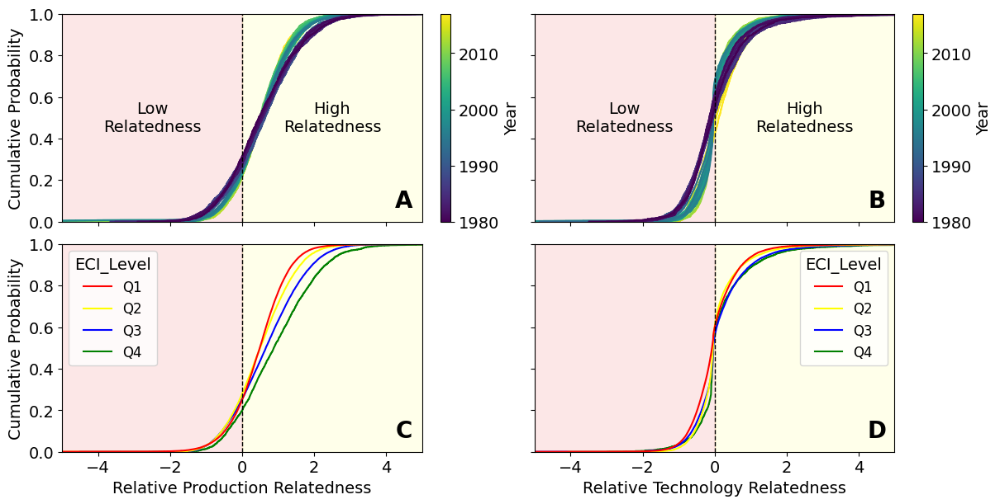

In [ ]:
# Adjust font sizes globally for the plots
plt.rc('font', size=14)  # Set the general font size
plt.rc('axes', titlesize=14)  # Font size of axes titles
plt.rc('axes', labelsize=14)  # Font size of x and y labels
plt.rc('xtick', labelsize=14)  # Font size of tick labels
plt.rc('ytick', labelsize=14)  # Font size of tick labels
plt.rc('legend', fontsize=12)  # Font size for legends

# Create a 3x2 grid of subplots with shared scales for x and y axes
fig, axes = plt.subplots(2, 2, figsize=(12, 6), constrained_layout=True, sharex=True, sharey=True)
labels = ['A', 'B', 'C', 'D', 'E', 'F']  # Labels for each panel

# Plot 1: Relative Production Relatedness vs. Year
sns.ecdfplot(data=temp_result_df,
             x="Relative Production Relatedness",
             hue="Year",
             palette='viridis',
             legend=False,
             ax=axes[0, 0])
sm = plt.cm.ScalarMappable(cmap="viridis", norm=plt.Normalize(vmin=temp_result_df["Year"].min(), vmax=temp_result_df["Year"].max()))
cbar = fig.colorbar(sm, ax=axes[0, 0], orientation='vertical', label='Year')
axes[0, 0].set_xlim(-5, 5)
axes[0, 0].axvline(x=0, color='black', linestyle='--', linewidth=1)
axes[0, 0].text(4.5, 0.1, labels[0], fontsize=20, ha='center', va='center', fontweight='bold')
axes[0, 0].axvspan(-5, 0, alpha=0.1, color="#e41a1c")
axes[0, 0].axvspan(0, 5, alpha=0.1, color="#ffff33")
axes[0, 0].text(-2.5, 0.5, "Low\nRelatedness", ha="center", va="center", fontsize=14)
axes[0, 0].text(2.5, 0.5, "High\nRelatedness", ha="center", va="center", fontsize=14)

# Plot 2: Relative Technology Relatedness vs. Year
sns.ecdfplot(data=temp_result_df,
             x="Relative Technology Relatedness",
             hue="Year",
             palette='viridis',
             legend=False,
             ax=axes[0, 1])
sm = plt.cm.ScalarMappable(cmap="viridis", norm=plt.Normalize(vmin=temp_result_df["Year"].min(), vmax=temp_result_df["Year"].max()))
cbar = fig.colorbar(sm, ax=axes[0, 1], orientation='vertical', label='Year')
axes[0, 1].set_xlim(-5, 5)
axes[0, 1].axvline(x=0, color='black', linestyle='--', linewidth=1)
axes[0, 1].text(4.5, 0.1, labels[1], fontsize=20, ha='center', va='center', fontweight='bold')
axes[0, 1].axvspan(-5, 0, alpha=0.1, color="#e41a1c")
axes[0, 1].axvspan(0, 5, alpha=0.1, color="#ffff33")
axes[0, 1].text(-2.5, 0.5, "Low\nRelatedness", ha="center", va="center", fontsize=14)
axes[0, 1].text(2.5, 0.5, "High\nRelatedness", ha="center", va="center", fontsize=14)
# Plot 3: Relative Production Relatedness vs. ECI_Level
sns.ecdfplot(data=temp_result_df,
             x="Relative Production Relatedness",
             hue="ECI_Level",
             palette=['red', 'yellow', 'blue', 'green'],
             legend=True,
             ax=axes[1, 0])
axes[1, 0].set_xlim(-5, 5)
axes[1, 0].axvline(x=0, color='black', linestyle='--', linewidth=1)
axes[1, 0].text(4.5, 0.1, labels[2], fontsize=20, ha='center', va='center', fontweight='bold')
axes[1, 0].axvspan(-5, 0, alpha=0.1, color="#e41a1c")
axes[1, 0].axvspan(0, 5, alpha=0.1, color="#ffff33")
#axes[1, 0].text(-5, 0.5, "Low\nRelatedness", ha="center", va="center", fontsize=14)
#axes[1, 0].text(1, 0.5, "High\nRelatedness", ha="center", va="center", fontsize=14)

# Plot 4: Relative Technology Relatedness vs. ECI_Level
sns.ecdfplot(data=temp_result_df,
             x="Relative Technology Relatedness",
             hue="ECI_Level",
             palette=['red', 'yellow', 'blue', 'green'],
             legend=True,
             ax=axes[1, 1])
axes[1, 1].set_xlim(-5, 5)
axes[1, 1].axvline(x=0, color='black', linestyle='--', linewidth=1)
axes[1, 1].text(4.5, 0.1, labels[3], fontsize=20, ha='center', va='center', fontweight='bold')
axes[1, 1].axvspan(-5, 0, alpha=0.1, color="#e41a1c")
axes[1, 1].axvspan(0, 5, alpha=0.1, color="#ffff33")
#axes[1, 1].text(-5, 0.5, "Low\nRelatedness", ha="center", va="center", fontsize=14)
#axes[1, 1].text(1, 0.5, "High\nRelatedness", ha="center", va="center", fontsize=14)


'''
# Plot 5: Relative Production Relatedness vs. Complex Product
sns.ecdfplot(data=temp_result_df,
             x="Relative Production Relatedness",
             hue="Complex Product",
             legend=True,
             ax=axes[2, 0])
axes[2, 0].set_xlim(-5, 5)
axes[2, 0].axvline(x=0, color='black', linestyle='--', linewidth=1)
axes[2, 0].text(4.5, 0.1, labels[4], fontsize=20, ha='center', va='center', fontweight='bold')

# Plot 6: Relative Technology Relatedness vs. Complex Product
sns.ecdfplot(data=temp_result_df,
             x="Relative Technology Relatedness",
             hue="Complex Product",
             legend=True,
             ax=axes[2, 1])
axes[2, 1].set_xlim(-5, 5)
axes[2, 1].axvline(x=0, color='black', linestyle='--', linewidth=1)
axes[2, 1].text(4.5, 0.1, labels[5], fontsize=20, ha='center', va='center', fontweight='bold')
'''
# Set shared axis labels
axes[-1, 0].set_xlabel("Relative Production Relatedness")
axes[-1, 1].set_xlabel("Relative Technology Relatedness")
for ax in axes[:, 0]:  # Left column
    ax.set_ylabel("Cumulative Probability")

# Save the plots
plt.savefig(f"{output_path}/ECDF_Relatedness_ECI_Complex_Product_labeled.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.savefig(f"{output_path}/ECDF_Relatedness_ECI_Complex_Product_labeled.pdf", dpi=300, transparent=True, bbox_inches="tight")

# Display the plots
plt.show()


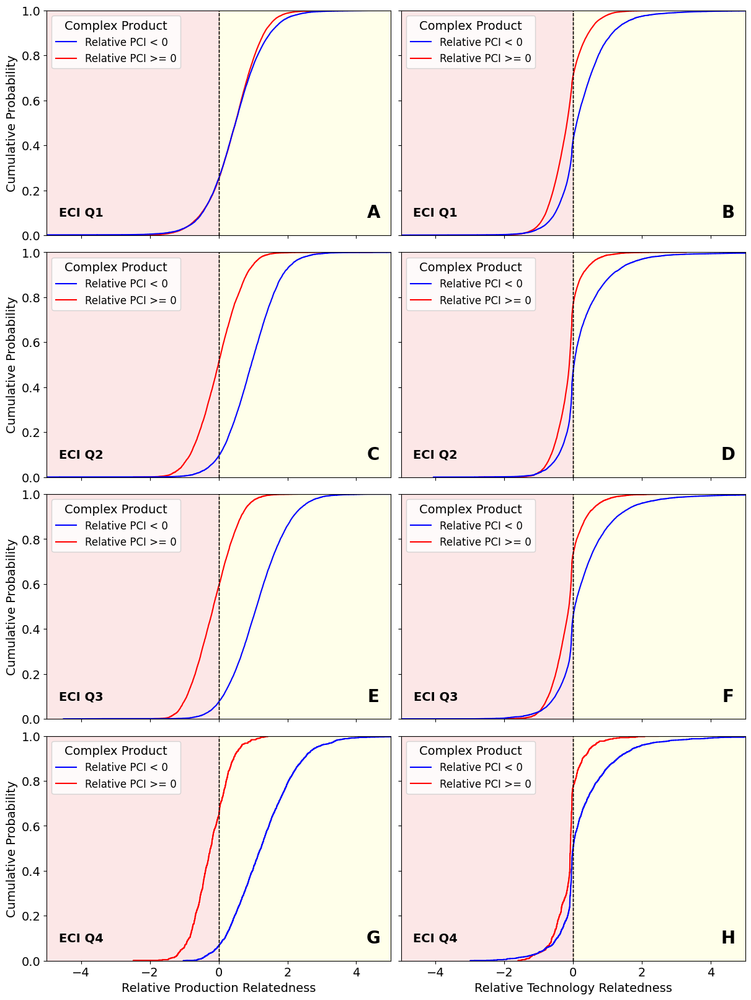

In [ ]:
# Adjust font sizes globally for the plots
plt.rc('font', size=14)  # Set the general font size
plt.rc('axes', titlesize=14)  # Font size of axes titles
plt.rc('axes', labelsize=14)  # Font size of x and y labels
plt.rc('xtick', labelsize=14)  # Font size of tick labels
plt.rc('ytick', labelsize=14)  # Font size of tick labels
plt.rc('legend', fontsize=12)  # Font size for legends

# Create a 4x2 grid of subplots with shared scales for x and y axes
fig, axes = plt.subplots(4, 2, figsize=(12, 16), constrained_layout=True, sharex=True, sharey=True)
labels = ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H']  # Labels for each panel
custom_palette = {'Relative PCI >= 0': 'red', 'Relative PCI < 0': 'blue'}  # Red for Relative PCI >= 0, Blue for < 0


eci_levels = ['Q1', 'Q2', 'Q3', 'Q4']
for i, eci_level in enumerate(eci_levels):
    temp_result_df2 = temp_result_df[temp_result_df["ECI_Level"] == eci_level]

    # Left column: Relative Production Relatedness
    sns.ecdfplot(data=temp_result_df2,
                 x="Relative Production Relatedness",
                 hue="Complex Product",
                 palette=custom_palette,
                 legend=True,  # Show legend only for the first row
                 ax=axes[i, 0])
    axes[i, 0].set_xlim(-5, 5)
    axes[i, 0].axvline(x=0, color='black', linestyle='--', linewidth=1)
    axes[i, 0].text(-4, 0.1, f'ECI {eci_level}', fontsize=14, ha='center', va='center', fontweight='bold')
    axes[i, 0].text(4.5, 0.1, labels[i * 2], fontsize=20, ha='center', va='center', fontweight='bold')
    axes[i, 0].axvspan(-5, 0, alpha=0.1, color="#e41a1c")
    axes[i, 0].axvspan(0, 5, alpha=0.1, color="#ffff33")

    #pci_greater_zero = temp_result_df2[temp_result_df2["Relative Production Relatedness"] >= 0]
    #y_intersect = pci_greater_zero["Relative Production Relatedness"].min()  # Minimum value for >= 0

    axes[i, 0].axvline(x=0, color='black', linestyle='--', linewidth=1)
    #axes[i, 0].axhline(y=y_intersect, color='red', linestyle=':', linewidth=1)
    #axes[i, 0].text(0.5, y_intersect, f'{y_intersect:.2f}', color='red', fontsize=12, va='bottom', ha='left')



    # Right column: Relative Technology Relatedness
    sns.ecdfplot(data=temp_result_df2,
                 x="Relative Technology Relatedness",
                 hue="Complex Product",
                 palette=custom_palette,
                 legend=True,  # Show legend only for the first row
                 ax=axes[i, 1])
    axes[i, 1].set_xlim(-5, 5)
    axes[i, 1].axvline(x=0, color='black', linestyle='--', linewidth=1)
    axes[i, 1].text(-4, 0.1, f'ECI {eci_level}', fontsize=14, ha='center', va='center', fontweight='bold')
    axes[i, 1].text(4.5, 0.1, labels[i * 2 + 1], fontsize=20, ha='center', va='center', fontweight='bold')

    #pci_greater_zero = temp_result_df2[temp_result_df2["Relative Production Relatedness"] >= 0]
    #y_intersect = pci_greater_zero["Relative Production Relatedness"].min()  # Minimum value for >= 0
    axes[i, 1].axvspan(-5, 0, alpha=0.1, color="#e41a1c")
    axes[i, 1].axvspan(0, 5, alpha=0.1, color="#ffff33")

    axes[i, 1].axvline(x=0, color='black', linestyle='--', linewidth=1)
    #axes[i, 1].axhline(y=y_intersect, color='red', linestyle=':', linewidth=1)
    #axes[i, 1].text(0.5, y_intersect, f'{y_intersect:.2f}', color='red', fontsize=12, va='bottom', ha='left')


# Set shared axis labels
axes[-1, 0].set_xlabel("Relative Production Relatedness")
axes[-1, 1].set_xlabel("Relative Technology Relatedness")
for ax in axes[:, 0]:  # Left column
    ax.set_ylabel("Cumulative Probability")

# Save the plots (uncomment when saving is required)
plt.savefig(f"{output_path}/ECDF_Relatedness_ECI_Complex_Product_labeled_2.jpg", dpi=300, transparent=True, bbox_inches="tight")
plt.savefig(f"{output_path}/ECDF_Relatedness_ECI_Complex_Product_labeled_2.pdf", dpi=300, transparent=True, bbox_inches="tight")

# Display the plots
plt.show()


In [ ]:
year = 2015

temp_index = Relative_density_from_technology[year].index
temp_df = Relative_density_from_technology[year]*(Opportunity_product[year].loc[temp_index])
temp_df = temp_df*(binary_rca[year + 2].loc[temp_index])
temp_df

,0011,0012,0013,0014,0015,0019,0111,0112,0113,0114,...,8996,8997,8998,8999,9110,9310,9410,9510,9610,9710
BGR,0.0,0.0,0.0,0.0,-0.0,-0.0,-0.0,0.00000,-0.0,0.0,...,-0.0,0.0,-0.0,0.0,0.0,-0.0,0.0,0.0,-0.0,0.000000
SWE,0.0,0.0,0.0,0.0,-0.0,0.0,0.0,0.00000,0.0,-0.0,...,0.0,0.0,-0.0,-0.0,-0.0,0.0,0.0,0.0,0.0,0.000000
BRA,0.0,0.0,0.0,0.0,-0.0,-0.0,0.0,0.00000,0.0,0.0,...,-0.0,-0.0,-0.0,0.0,-0.0,-0.0,0.0,0.0,-0.0,0.000000
CAN,0.0,0.0,0.0,0.0,0.0,-0.0,0.0,0.00000,0.0,0.0,...,0.0,0.0,-0.0,0.0,-0.0,0.0,0.0,0.0,0.0,0.000000
SVN,0.0,0.0,0.0,0.0,-0.0,-0.0,-0.0,0.00000,-0.0,0.0,...,-0.0,-0.0,-0.0,0.0,-0.0,-0.0,0.0,-0.0,-0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CHL,0.0,0.0,0.0,0.0,0.0,-0.0,0.0,0.00000,0.0,0.0,...,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,0.0,-0.0,-0.0,0.000000
IDN,0.0,0.0,0.0,0.0,-0.0,-0.0,-0.0,0.00000,-0.0,0.0,...,-0.0,0.0,0.0,0.0,-0.0,-0.0,0.0,-0.0,-0.0,0.197288
GTM,0.0,0.0,0.0,0.0,-0.0,-0.0,0.0,0.00000,-0.0,0.0,...,-0.0,0.0,-0.0,0.0,-0.0,-0.0,0.0,-0.0,-0.0,0.000000
UZB,0.0,-0.0,0.0,0.0,-0.0,-0.0,-0.0,-0.00000,-0.0,0.0,...,-0.0,-0.0,-0.0,0.0,-0.0,-0.0,0.0,-0.0,-0.0,0.000000


In [ ]:
temp_result_df[(temp_result_df['ECI_Level']=='Q1') & (temp_result_df['Country']=='KOR')]

,Country,Product,Year,Relative Production Relatedness,Relative Technology Relatedness,Relative PCI,ECI_Level,ECI,Complex Product
1080,KOR,0751,1980,2.339943,2.731057,-1.606381,Q1,0.998565,Relative PCI < 0
1081,KOR,2481,1980,-0.156332,-0.645154,-1.207275,Q1,0.998565,Relative PCI < 0
1082,KOR,2671,1980,0.399942,-0.498302,0.743459,Q1,0.998565,Relative PCI >= 0
1083,KOR,2685,1980,1.602960,1.702506,-0.649050,Q1,0.998565,Relative PCI < 0
1084,KOR,3353,1980,-0.859007,-0.158301,0.378293,Q1,0.998565,Relative PCI >= 0
...,...,...,...,...,...,...,...,...,...
80857,KOR,7441,2017,0.942871,-0.517312,1.330679,Q1,2.044012,Relative PCI >= 0
80858,KOR,7913,2017,1.752238,-0.142083,2.194099,Q1,2.044012,Relative PCI >= 0
80859,KOR,7928,2017,0.297713,-1.054795,-0.549165,Q1,2.044012,Relative PCI < 0
80860,KOR,8813,2017,2.247956,-0.733439,2.193113,Q1,2.044012,Relative PCI >= 0


In [ ]:
temp_country = 'KOR'

low_pro_low_tech = 0
low_pro_high_tech = 0
high_pro_low_tech = 0
high_pro_high_tech = 0

all_low_pro_low_tech = 0
all_low_pro_high_tech = 0
all_high_pro_low_tech = 0
all_high_pro_high_tech = 0


for temp_year in range(1980, 2001):

    temp_df = Opportunity_product[temp_year].loc[temp_country]
    temp_df = temp_df*(binary_rca[temp_year + 2].loc[temp_country])
    temp_df = temp_df[temp_df == 1]
    target_list = temp_df.index

    #target_list = [x for x in target_list if Relative_pci[temp_year].loc[temp_country, x] >= 0]

    for target in target_list:
        if Relative_density_production[temp_year].loc[temp_country, target] < 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] < 0:
            low_pro_low_tech += 1
        elif Relative_density_production[temp_year].loc[temp_country, target] < 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] >= 0:
            low_pro_high_tech += 1
        elif Relative_density_production[temp_year].loc[temp_country, target] >= 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] < 0:
            high_pro_low_tech += 1
        else:
            high_pro_high_tech += 1


    temp_df = Opportunity_product[temp_year].loc[temp_country]
    temp_df = temp_df[temp_df == 1]
    target_list = temp_df.index
    #target_list = [x for x in target_list if Relative_pci[temp_year].loc[temp_country, x] >= 0]

    for target in target_list:
        if Relative_density_production[temp_year].loc[temp_country, target] < 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] < 0:
            all_low_pro_low_tech += 1
        elif Relative_density_production[temp_year].loc[temp_country, target] < 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] >= 0:
            all_low_pro_high_tech += 1
        elif Relative_density_production[temp_year].loc[temp_country, target] >= 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] < 0:
            all_high_pro_low_tech += 1
        else:
            all_high_pro_high_tech += 1

p1 = low_pro_low_tech / (all_low_pro_low_tech)
p2 = low_pro_high_tech / (all_low_pro_high_tech)
p3 = high_pro_low_tech / (all_high_pro_low_tech)
p4 = high_pro_high_tech / (all_high_pro_high_tech)

print(p1, p2, p3, p4)
print(high_pro_high_tech, high_pro_low_tech, low_pro_high_tech, low_pro_low_tech)
print(high_pro_high_tech+high_pro_low_tech+low_pro_high_tech+low_pro_low_tech)

0.02944507361268403 0.02321981424148607 0.052954719877206444 0.05512282804074296
184 138 30 156
508


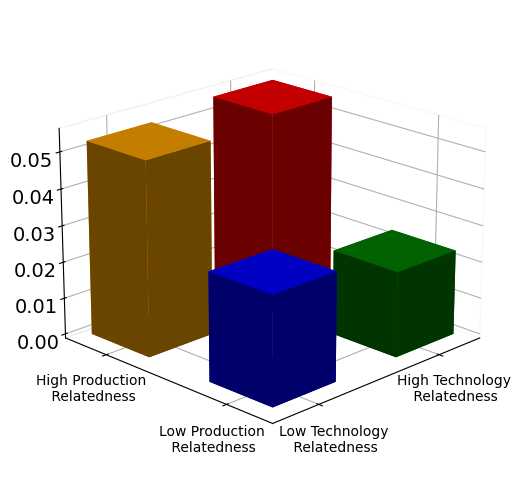

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.cm as cm
from matplotlib.ticker import FixedLocator, FixedFormatter

fig = plt.figure(figsize=(12, 6))
ax = fig.add_subplot(projection='3d')
x, y = [2,2,0,0], [2,0,2,0]
hist, xedges, yedges = np.histogram2d(x, y, bins=2)

# Construct arrays for the anchor positions of the bars.
xpos, ypos = np.meshgrid(xedges[:-1]+xedges[1:], yedges[:-1]+yedges[1:])
xpos = xpos.flatten()/2.
ypos = ypos.flatten()/2.
zpos = 0

# Construct arrays with the dimensions for the bars.
dx = dy = 0.5 * np.ones_like(zpos)
dz = [p4, p3, p2, p1]

column_names = ['High Technology\n Relatedness', 'Low Technology\n Relatedness']
row_names = ['High Production\n Relatedness', 'Low Production\n Relatedness']

ticksx = [0.75, 1.75]
ax.set_xticks(ticksx, column_names, rotation=0, fontsize=10)
ax.tick_params(axis='x', which='both', length=0, direction='in')

ticksy = [0.75, 1.75]
ax.set_yticks(ticksy, row_names, rotation=0, fontsize=10)
ax.tick_params(axis='y', which='both', length=0, direction='in')

ax.bar3d(xpos, ypos, zpos, dx, dy, dz, zsort='average', color=['red', 'orange', 'green', 'blue'])
ax.view_init(20, 45)
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

#ax.set_zlabel('Hit paper Probability', fontsize=16)

# Save the plot as a PDF and JPG with bbox_inches='tight' to prevent clipping
plt.savefig(f'{output_path}/Diversification KOR.pdf', dpi=300, bbox_inches='tight')
plt.savefig(f'{output_path}/Diversification KOR.jpg', dpi=300, bbox_inches='tight')


In [ ]:
temp_country = 'KOR'

low_pro_low_tech = 0
low_pro_high_tech = 0
high_pro_low_tech = 0
high_pro_high_tech = 0

all_low_pro_low_tech = 0
all_low_pro_high_tech = 0
all_high_pro_low_tech = 0
all_high_pro_high_tech = 0


for temp_year in range(1980, 2001):

    temp_df = Opportunity_product[temp_year].loc[temp_country]
    temp_df = temp_df*(binary_rca[temp_year + 2].loc[temp_country])
    temp_df = temp_df[temp_df == 1]
    target_list = temp_df.index

    target_list = [x for x in target_list if Relative_pci[temp_year].loc[temp_country, x] >= 0]

    for target in target_list:
        if Relative_density_production[temp_year].loc[temp_country, target] < 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] < 0:
            low_pro_low_tech += 1
        elif Relative_density_production[temp_year].loc[temp_country, target] < 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] >= 0:
            low_pro_high_tech += 1
        elif Relative_density_production[temp_year].loc[temp_country, target] >= 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] < 0:
            high_pro_low_tech += 1
        else:
            high_pro_high_tech += 1


    temp_df = Opportunity_product[temp_year].loc[temp_country]
    temp_df = temp_df[temp_df == 1]
    target_list = temp_df.index
    target_list = [x for x in target_list if Relative_pci[temp_year].loc[temp_country, x] >= 0]

    for target in target_list:
        if Relative_density_production[temp_year].loc[temp_country, target] < 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] < 0:
            all_low_pro_low_tech += 1
        elif Relative_density_production[temp_year].loc[temp_country, target] < 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] >= 0:
            all_low_pro_high_tech += 1
        elif Relative_density_production[temp_year].loc[temp_country, target] >= 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] < 0:
            all_high_pro_low_tech += 1
        else:
            all_high_pro_high_tech += 1

p1 = low_pro_low_tech / (all_low_pro_low_tech)
p2 = low_pro_high_tech / (all_low_pro_high_tech)
p3 = high_pro_low_tech / (all_high_pro_low_tech)
p4 = high_pro_high_tech / (all_high_pro_high_tech)

print(p1, p2, p3, p4)
print(high_pro_high_tech, high_pro_low_tech, low_pro_high_tech, low_pro_low_tech)
print(high_pro_high_tech+high_pro_low_tech+low_pro_high_tech+low_pro_low_tech)

0.034123469653555616 0.0389344262295082 0.06922043010752688 0.09857612267250822
90 103 19 131
343


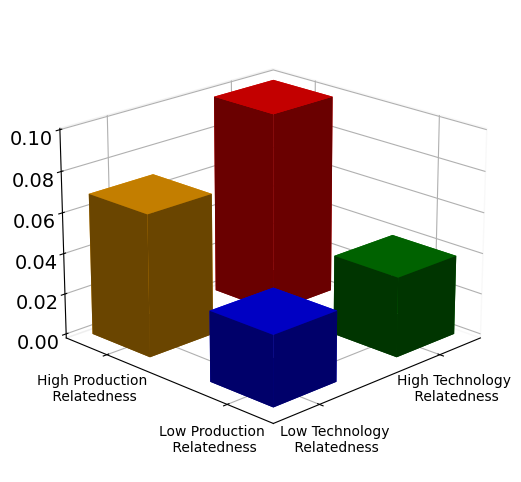

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.cm as cm
from matplotlib.ticker import FixedLocator, FixedFormatter

fig = plt.figure(figsize=(12, 6))
ax = fig.add_subplot(projection='3d')
x, y = [2,2,0,0], [2,0,2,0]
hist, xedges, yedges = np.histogram2d(x, y, bins=2)

# Construct arrays for the anchor positions of the bars.
xpos, ypos = np.meshgrid(xedges[:-1]+xedges[1:], yedges[:-1]+yedges[1:])
xpos = xpos.flatten()/2.
ypos = ypos.flatten()/2.
zpos = 0

# Construct arrays with the dimensions for the bars.
dx = dy = 0.5 * np.ones_like(zpos)
dz = [p4, p3, p2, p1]

column_names = ['High Technology\n Relatedness', 'Low Technology\n Relatedness']
row_names = ['High Production\n Relatedness', 'Low Production\n Relatedness']

ticksx = [0.75, 1.75]
ax.set_xticks(ticksx, column_names, rotation=0, fontsize=10)
ax.tick_params(axis='x', which='both', length=0, direction='in')

ticksy = [0.75, 1.75]
ax.set_yticks(ticksy, row_names, rotation=0, fontsize=10)
ax.tick_params(axis='y', which='both', length=0, direction='in')

ax.bar3d(xpos, ypos, zpos, dx, dy, dz, zsort='average', color=['red', 'orange', 'green', 'blue'])
ax.view_init(20, 45)
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

#ax.set_zlabel('Hit paper Probability', fontsize=16)

# Save the plot as a PDF and JPG with bbox_inches='tight' to prevent clipping
plt.savefig(f'{output_path}/Diversification Complex KOR.pdf', dpi=300, bbox_inches='tight')
plt.savefig(f'{output_path}/Diversification Complex KOR.jpg', dpi=300, bbox_inches='tight')


In [ ]:
temp_country = 'VNM'

low_pro_low_tech = 0
low_pro_high_tech = 0
high_pro_low_tech = 0
high_pro_high_tech = 0

all_low_pro_low_tech = 0
all_low_pro_high_tech = 0
all_high_pro_low_tech = 0
all_high_pro_high_tech = 0


for temp_year in range(2000, 2018):

    temp_df = Opportunity_product[temp_year].loc[temp_country]
    temp_df = temp_df*(binary_rca[temp_year + 2].loc[temp_country])
    temp_df = temp_df[temp_df == 1]
    target_list = temp_df.index

    #target_list = [x for x in target_list if Relative_pci[temp_year].loc[temp_country, x] >= 0]

    for target in target_list:
        if Relative_density_production[temp_year].loc[temp_country, target] < 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] < 0:
            low_pro_low_tech += 1
        elif Relative_density_production[temp_year].loc[temp_country, target] < 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] >= 0:
            low_pro_high_tech += 1
        elif Relative_density_production[temp_year].loc[temp_country, target] >= 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] < 0:
            high_pro_low_tech += 1
        else:
            high_pro_high_tech += 1


    temp_df = Opportunity_product[temp_year].loc[temp_country]
    temp_df = temp_df[temp_df == 1]
    target_list = temp_df.index
    #target_list = [x for x in target_list if Relative_pci[temp_year].loc[temp_country, x] >= 0]

    for target in target_list:
        if Relative_density_production[temp_year].loc[temp_country, target] < 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] < 0:
            all_low_pro_low_tech += 1
        elif Relative_density_production[temp_year].loc[temp_country, target] < 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] >= 0:
            all_low_pro_high_tech += 1
        elif Relative_density_production[temp_year].loc[temp_country, target] >= 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] < 0:
            all_high_pro_low_tech += 1
        else:
            all_high_pro_high_tech += 1

p1 = low_pro_low_tech / (all_low_pro_low_tech)
p2 = low_pro_high_tech / (all_low_pro_high_tech)
p3 = high_pro_low_tech / (all_high_pro_low_tech)
p4 = high_pro_high_tech / (all_high_pro_high_tech)

print(p1, p2, p3, p4)
print(high_pro_high_tech, high_pro_low_tech, low_pro_high_tech, low_pro_low_tech)
print(high_pro_high_tech+high_pro_low_tech+low_pro_high_tech+low_pro_low_tech)

0.018527095877721167 0.019101123595505618 0.06987341772151899 0.06484375
249 138 17 80
484


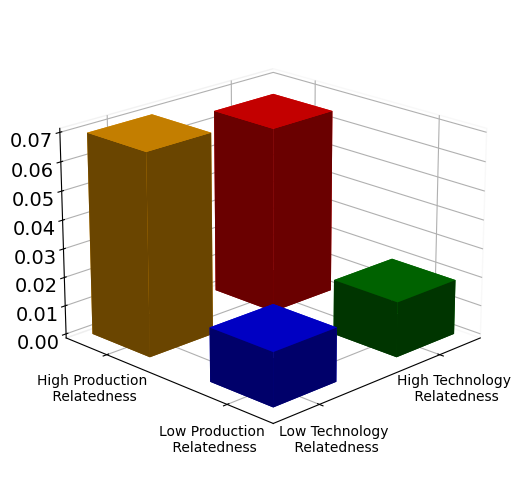

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.cm as cm
from matplotlib.ticker import FixedLocator, FixedFormatter

fig = plt.figure(figsize=(12, 6))
ax = fig.add_subplot(projection='3d')
x, y = [2,2,0,0], [2,0,2,0]
hist, xedges, yedges = np.histogram2d(x, y, bins=2)

# Construct arrays for the anchor positions of the bars.
xpos, ypos = np.meshgrid(xedges[:-1]+xedges[1:], yedges[:-1]+yedges[1:])
xpos = xpos.flatten()/2.
ypos = ypos.flatten()/2.
zpos = 0

# Construct arrays with the dimensions for the bars.
dx = dy = 0.5 * np.ones_like(zpos)
dz = [p4, p3, p2, p1]

column_names = ['High Technology\n Relatedness', 'Low Technology\n Relatedness']
row_names = ['High Production\n Relatedness', 'Low Production\n Relatedness']

ticksx = [0.75, 1.75]
ax.set_xticks(ticksx, column_names, rotation=0, fontsize=10)
ax.tick_params(axis='x', which='both', length=0, direction='in')

ticksy = [0.75, 1.75]
ax.set_yticks(ticksy, row_names, rotation=0, fontsize=10)
ax.tick_params(axis='y', which='both', length=0, direction='in')

ax.bar3d(xpos, ypos, zpos, dx, dy, dz, zsort='average', color=['red', 'orange', 'green', 'blue'])
ax.view_init(20, 45)
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

#ax.set_zlabel('Hit paper Probability', fontsize=16)

# Save the plot as a PDF and JPG with bbox_inches='tight' to prevent clipping
plt.savefig(f'{output_path}/Diversification VNM.pdf', dpi=300, bbox_inches='tight')
plt.savefig(f'{output_path}/Diversification VNM.jpg', dpi=300, bbox_inches='tight')


In [ ]:
temp_country = 'VNM'

low_pro_low_tech = 0
low_pro_high_tech = 0
high_pro_low_tech = 0
high_pro_high_tech = 0

all_low_pro_low_tech = 0
all_low_pro_high_tech = 0
all_high_pro_low_tech = 0
all_high_pro_high_tech = 0


for temp_year in range(2000, 2015):

    temp_df = Opportunity_product[temp_year].loc[temp_country]
    temp_df = temp_df*(binary_rca[temp_year + 2].loc[temp_country])
    temp_df = temp_df[temp_df == 1]
    target_list = temp_df.index

    target_list = [x for x in target_list if Relative_pci[temp_year].loc[temp_country, x] >= 0]

    for target in target_list:
        if Relative_density_production[temp_year].loc[temp_country, target] < 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] < 0:
            low_pro_low_tech += 1
        elif Relative_density_production[temp_year].loc[temp_country, target] < 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] >= 0:
            low_pro_high_tech += 1
        elif Relative_density_production[temp_year].loc[temp_country, target] >= 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] < 0:
            high_pro_low_tech += 1
        else:
            high_pro_high_tech += 1


    temp_df = Opportunity_product[temp_year].loc[temp_country]
    temp_df = temp_df[temp_df == 1]
    target_list = temp_df.index
    target_list = [x for x in target_list if Relative_pci[temp_year].loc[temp_country, x] >= 0]

    for target in target_list:
        if Relative_density_production[temp_year].loc[temp_country, target] < 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] < 0:
            all_low_pro_low_tech += 1
        elif Relative_density_production[temp_year].loc[temp_country, target] < 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] >= 0:
            all_low_pro_high_tech += 1
        elif Relative_density_production[temp_year].loc[temp_country, target] >= 0 and Relative_density_from_technology[temp_year].loc[temp_country, target] < 0:
            all_high_pro_low_tech += 1
        else:
            all_high_pro_high_tech += 1

p1 = low_pro_low_tech / (all_low_pro_low_tech)
p2 = low_pro_high_tech / (all_low_pro_high_tech)
p3 = high_pro_low_tech / (all_high_pro_low_tech)
p4 = high_pro_high_tech / (all_high_pro_high_tech)

print(p1, p2, p3, p4)
print(high_pro_high_tech, high_pro_low_tech, low_pro_high_tech, low_pro_low_tech)
print(high_pro_high_tech+high_pro_low_tech+low_pro_high_tech+low_pro_low_tech)

0.02147887323943662 0.01991150442477876 0.07530120481927711 0.057569296375266525
54 50 9 61
174


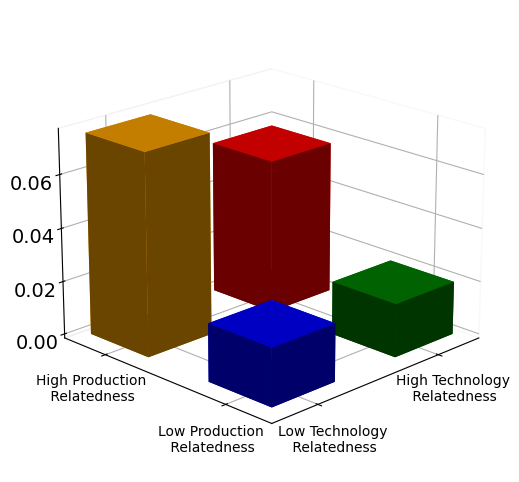

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.cm as cm
from matplotlib.ticker import FixedLocator, FixedFormatter

fig = plt.figure(figsize=(12, 6))
ax = fig.add_subplot(projection='3d')
x, y = [2,2,0,0], [2,0,2,0]
hist, xedges, yedges = np.histogram2d(x, y, bins=2)

# Construct arrays for the anchor positions of the bars.
xpos, ypos = np.meshgrid(xedges[:-1]+xedges[1:], yedges[:-1]+yedges[1:])
xpos = xpos.flatten()/2.
ypos = ypos.flatten()/2.
zpos = 0

# Construct arrays with the dimensions for the bars.
dx = dy = 0.5 * np.ones_like(zpos)
dz = [p4, p3, p2, p1]

column_names = ['High Technology\n Relatedness', 'Low Technology\n Relatedness']
row_names = ['High Production\n Relatedness', 'Low Production\n Relatedness']

ticksx = [0.75, 1.75]
ax.set_xticks(ticksx, column_names, rotation=0, fontsize=10)
ax.tick_params(axis='x', which='both', length=0, direction='in')

ticksy = [0.75, 1.75]
ax.set_yticks(ticksy, row_names, rotation=0, fontsize=10)
ax.tick_params(axis='y', which='both', length=0, direction='in')

ax.bar3d(xpos, ypos, zpos, dx, dy, dz, zsort='average', color=['red', 'orange', 'green', 'blue'])
ax.view_init(20, 45)
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

#ax.set_zlabel('Hit paper Probability', fontsize=16)

# Save the plot as a PDF and JPG with bbox_inches='tight' to prevent clipping
plt.savefig(f'{output_path}/Diversification Complex VNM.pdf', dpi=300, bbox_inches='tight')
plt.savefig(f'{output_path}/Diversification Complex VNM.jpg', dpi=300, bbox_inches='tight')


In [ ]:
proximity_technology_df = pd.DataFrame(proximity_technology,index = binary_rta[2020].index, columns = binary_rta[2020].index)

array([[1.        , 0.4       , 0.53333333, ..., 0.6       , 0.06666667,
        0.06666667],
       [0.4       , 1.        , 0.33333333, ..., 0.46666667, 0.14285714,
        0.08333333],
       [0.53333333, 0.33333333, 1.        , ..., 0.53333333, 0.13333333,
        0.06666667],
       ...,
       [0.6       , 0.46666667, 0.53333333, ..., 1.        , 0.2       ,
        0.06666667],
       [0.06666667, 0.14285714, 0.13333333, ..., 0.2       , 1.        ,
        0.        ],
       [0.06666667, 0.08333333, 0.06666667, ..., 0.06666667, 0.        ,
        1.        ]])

<Axes: >

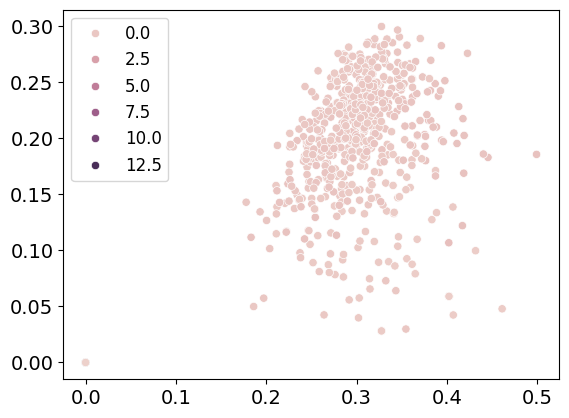

In [ ]:
target_products = list(Opportunity_product[2020].loc['VNM'][Opportunity_product[2020].loc['VNM']==1].index)
target_technologies = list(Opportunity_technology[2020].loc['VNM'][Opportunity_technology[2020].loc['VNM']==1].index)
proximity_technology_df = pd.DataFrame(proximity_technology[2020],index = binary_rta[2020].columns, columns = binary_rta[2020].columns)
temp_xs = []
temp_ys = []
temp_alpha = []
for tech in target_technologies:
    temp_xs.append(np.mean(Co_proximity_n[2020][tech].loc[target_products]))
    temp_ys.append(np.mean(proximity_technology_df[tech].loc[target_technologies]))
    temp_alpha.append(Relative_density_technology[2020].loc['VNM', tech])

sns.scatterplot(x = temp_xs, y = temp_ys, hue = temp_alpha)

In [ ]:
Space_G = nx.Graph()
Space_G = nx.compose_all([Space_G, tech_space_dict[2020], product_space_dict[2020], co_space_dict[2020]])

In [ ]:
Space_G.degree

DegreeView({'A01B': 41, 'A01D': 13, 'A01F': 21, 'A22C': 13, 'A23D': 32, 'A23G': 39, 'A23J': 14, 'A62B': 26, 'A62C': 28, 'B03C': 37, 'B05B': 33, 'B05C': 22, 'B23D': 43, 'B24C': 25, 'B26D': 42, 'B27B': 44, 'B31B': 37, 'B60B': 43, 'B61D': 36, 'B63C': 36, 'B66C': 45, 'B66F': 62, 'C05G': 27, 'C12M': 59, 'D21C': 42, 'E01B': 47, 'E01C': 23, 'E02F': 14, 'E03B': 33, 'E03F': 30, 'F03G': 11, 'F04C': 49, 'F16N': 11, 'F17D': 32, 'F23N': 29, 'F27B': 37, 'F27D': 49, 'G01F': 49, 'G01G': 35, 'H02B': 57, 'H02G': 31, 'H05H': 55, 'A01C': 11, 'A01H': 2, 'A47F': 16, 'A63H': 4, 'B03B': 32, 'B62B': 6, 'C05D': 11, 'E04D': 5, 'F21Y': 9, 'G08C': 16, 'A47B': 9, 'B09B': 31, 'B60K': 20, 'F04F': 9, 'F21W': 12, 'A23B': 27, 'A43D': 6, 'B07C': 16, 'B42D': 33, 'B61L': 40, 'C01C': 31, 'C05C': 33, 'C12G': 21, 'D04B': 37, 'D06H': 43, 'D07B': 33, 'F25C': 5, 'A01G': 14, 'A23L': 21, 'A61C': 28, 'B01F': 21, 'B29B': 45, 'B29K': 32, 'B29L': 31, 'B65B': 28, 'C12Q': 7, 'C22B': 23, 'E02D': 71, 'E04H': 12, 'F26B': 35, 'G16H': 1, 'H0